In [1]:

#from Tools import *
from photoObject import *
import numpy as np
import seaborn as sns
import pandas as pd
from BayesianInference import *
from random import Random
import random
from scipy.interpolate import interp1d
from scipy.stats import rv_continuous
from astropy.io import ascii
import emcee
import pathos.multiprocessing as multiproc
from multiprocessing import Pool
import corner
from IPython.display import display, Math
from astropy import cosmology
import corner
from palettable import cmocean
import matplotlib.pyplot as plt

In [2]:
Catalog=ascii.read('../../A-Catalogs/Binospec-Candels.cat')
mask=np.isnan(Catalog["EWLya"])==False
Catalog=Catalog[mask]
print(len(Catalog))
mask=Catalog["EWLya"]<500
Catalog=Catalog[mask]
mask=Catalog["Muv"]>-23.5
Catalog=Catalog[mask]
mask=Catalog["slope"]>-4
Catalog=Catalog[mask]
mask=Catalog["slope"]<1
Catalog=Catalog[mask]


228


In [3]:
%load_ext autoreload
%autoreload

Muv=Catalog["Muv"]
dMuv=Catalog["dMuv"]
Beta=Catalog["slope"]
dBeta=Catalog["dslope"]
BInf=BayesInf()
BInf.Muv=Muv
EW_obs=Catalog["EWLya"]
BInf.EW_obs=np.array(EW_obs)
dEW=Catalog["dEWLya"]




dEW=np.array(dEW)
BInf.dEW=dEW
Detection_type=Catalog["Type"]
wtab=BInf.GenerateWtab_real()


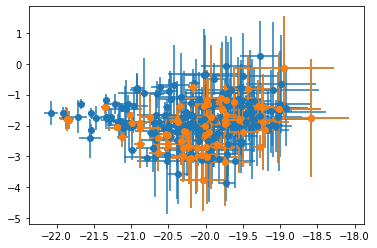

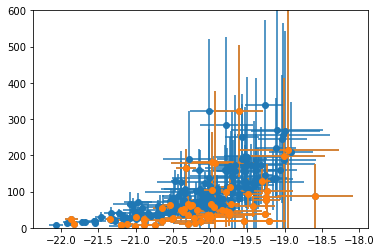

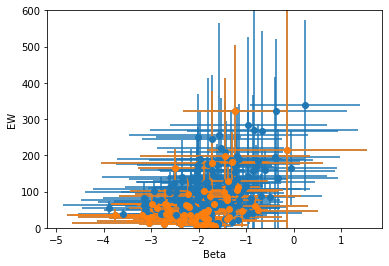

In [4]:
plt.errorbar(Muv,Beta,xerr=dMuv,yerr=dBeta,fmt='o')
plt.errorbar(Muv[Detection_type=="LAE"],Beta[Detection_type=="LAE"],xerr=dMuv[Detection_type=="LAE"],yerr=dBeta[Detection_type=="LAE"],fmt='o')
plt.show()
plt.errorbar(Muv,EW_obs,xerr=dMuv,yerr=dEW,fmt='o')
plt.errorbar(Muv[Detection_type=="LAE"],EW_obs[Detection_type=="LAE"],xerr=dMuv[Detection_type=="LAE"],yerr=dEW[Detection_type=="LAE"],fmt='o')
plt.ylim(0,600)
plt.show()
plt.errorbar(Beta,EW_obs,xerr=dBeta,yerr=dEW,fmt='o')
plt.errorbar(Beta[Detection_type=="LAE"],EW_obs[Detection_type=="LAE"],xerr=dBeta[Detection_type=="LAE"],yerr=dEW[Detection_type=="LAE"],fmt='o')
plt.ylim(0,600)
plt.xlabel("Beta")
plt.ylabel("EW")
plt.show()


In [5]:
def Likelihood(ew,dEW,Wo):
    """
    Likelihood : Probability of having a certain value of EW given the exponential parameters A and Wo

    Args:
        ew: Equivalent widths observed
        A : Parameter exponential (should depend on our other observables, such as uvslope and muv)
        Wo : Parameter exponential (should depend on our other observables, such as uvslope and muv)
    """
    A=1
    dEW_2 = dEW**2.
    p1 = (1. - A) * np.exp(-0.5 * ew**2./dEW_2) / np.sqrt(2.*np.pi) / dEW
    X  = (dEW_2/Wo - ew) / np.sqrt(2.) / dEW
    p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
    p = p1 + p2
    return p

def ParameterModel(physParams,mathParams):
    """
    ParameterModel: Given the physical parameters and the mathematical parameters, it returns the parameter of the model
    
    Input:
    - physParams: Physical parameters (Muv)
    - mathParams: Mathematical parameters (Constants of the model A and Wo)
    Output:
    - Parameter: Parameter of the model A or Wo
    """
    Muv=physParams[0]
    cMuv,cte= mathParams[0],mathParams[1]
    Parameter   =   ((Muv+20)*cMuv)   +   cte 
    #print(Parameter)
    return Parameter


def LikNoDet(wtab,dew,Wo):
        like = Likelihood(wtab,dew,Wo)
        return integrate.trapz(like,wtab)


def Posterior(ew,dew,physParams,mathParamsW):
    """
    

    """
    Wo=ParameterModel(physParams,mathParamsW)
    #probLike=self.Likelihood(ew,A,Wo)
    probLike=[]
    for i in range(0,len(Detection_type)):
        if Detection_type[i]=="LAE":
            p   =   Likelihood(ew[i],dew[i],Wo[i])
        if Detection_type[i]=="NonDetect":
            p   =   LikNoDet(wtab[i],dew[i],Wo[i])
        if np.isnan(p)==True:
            continue

        probLike.append(p)
        
    return np.array(probLike)

def log_prior(theta,physParams):
    # I can put priors here or in the equation in the BInf object 
    Wuv,Wc= theta
    W =   ParameterModel(physParams,[Wuv,Wc])
    #print(A,W)
    if  (W > 0.).all() and (W < 100.).all():
        return 0.0 

    return -np.inf

def log_likelihood(theta,y,yerr,physParams):
    Wuv,Wc= theta
    model = Posterior(y,yerr,physParams,[Wuv,Wc]) # Does thus have to be exp, so it gets outside the logaritm?

    return np.sum(np.log(model))


def log_probability(theta, y, yerr,Muv):
    #print(Muv,Beta)
    DrawnphysParams=[Muv]
    
    lp = log_prior(theta,DrawnphysParams)
    if not np.isfinite(lp):
        return -np.inf
    
    lL=log_likelihood(theta, y, yerr,DrawnphysParams)
    #print(lL)
    if np.isnan(lL)==True:
        return -np.inf
    else:
        return lp + lL

Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready
Muv_ready


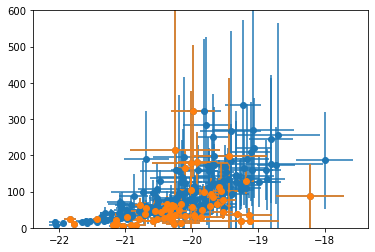

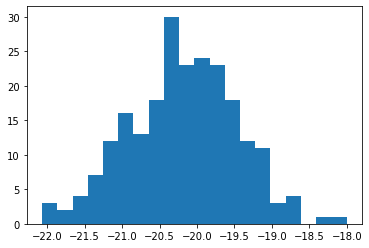

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 12%|█▏        | 367/3000 [01:11<08:23,  5.23it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [09:15<00:00,  5.40it/s]


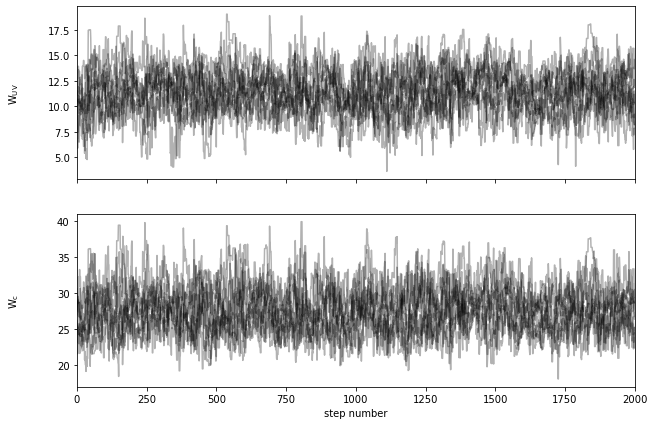

(20000, 2)


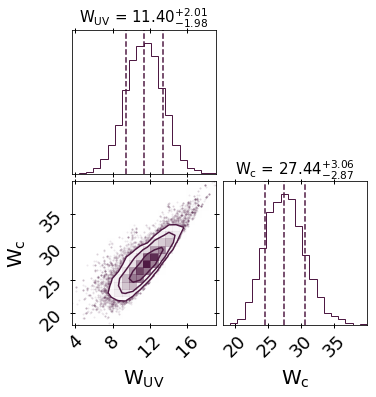

<IPython.core.display.Math object>

<IPython.core.display.Math object>

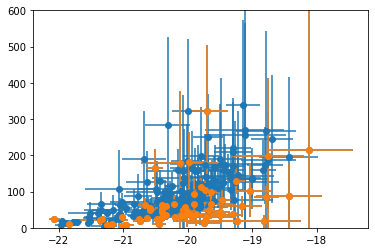

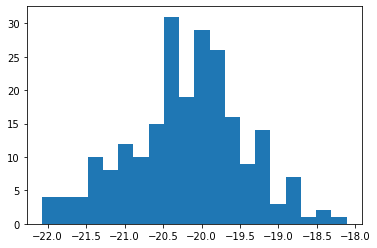

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  5%|▍         | 140/3000 [00:22<09:58,  4.78it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 27%|██▋       | 800/3000 [02:07<05:43,  6.41it/s]<ipython-input-5-ccb42e6453df>:74: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(model))
 39%|███▉      | 1182/3000 [03:03<04:37,  6.54it/s]<i

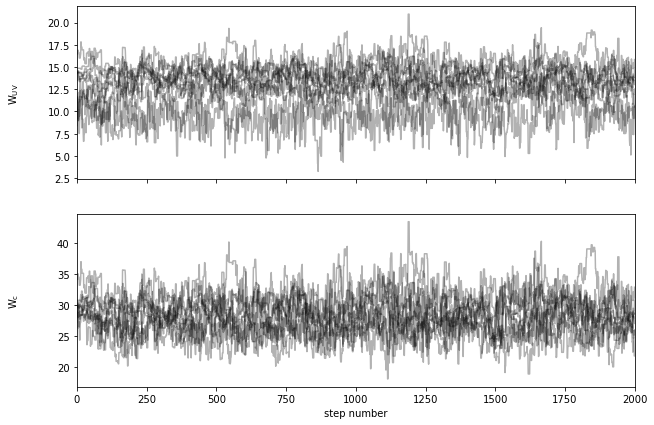

(20000, 2)


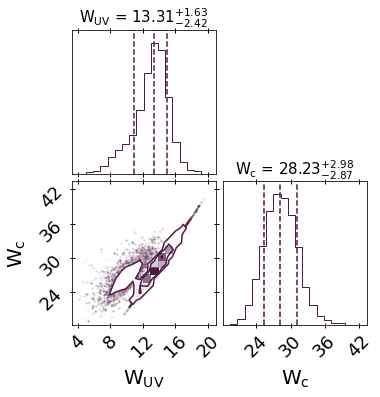

<IPython.core.display.Math object>

<IPython.core.display.Math object>

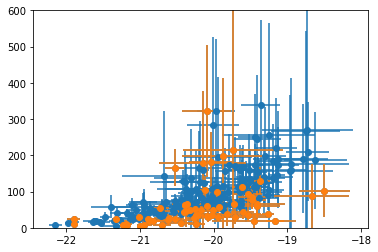

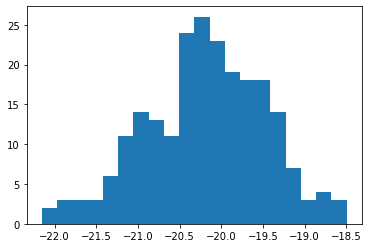

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 16/3000 [00:01<03:57, 12.58it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  1%|          | 22/3000 [00:01<04:44, 10.47it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 336/3000 [00:41<06:16,  7.08it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

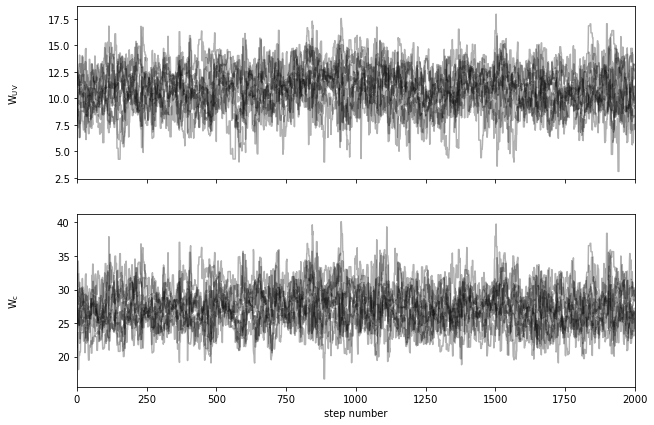

(20000, 2)


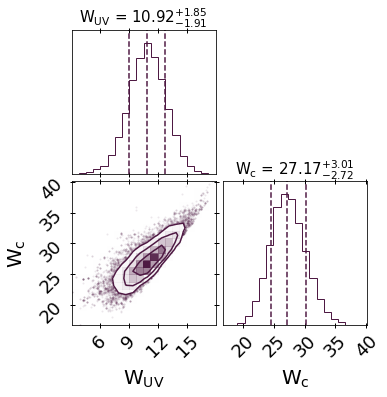

<IPython.core.display.Math object>

<IPython.core.display.Math object>

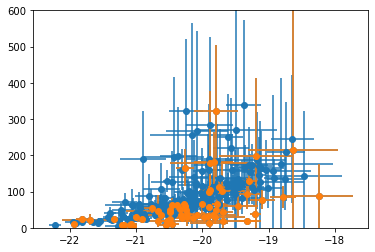

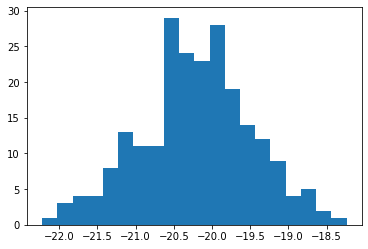

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 26/3000 [00:01<03:44, 13.24it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 56/3000 [00:04<04:11, 11.70it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 19%|█▉        | 573/3000 [00:58<04:22,  9.25it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

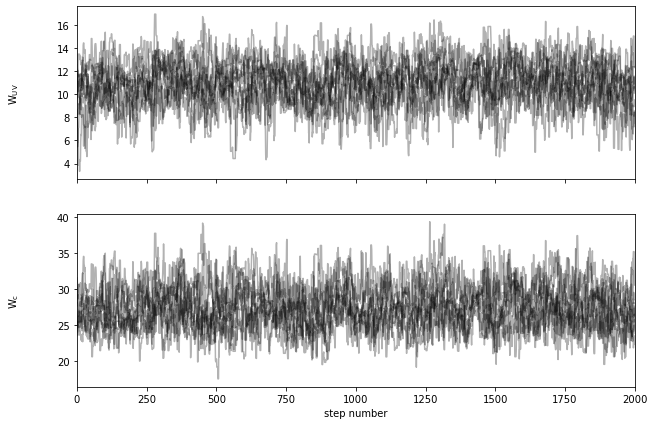

(20000, 2)


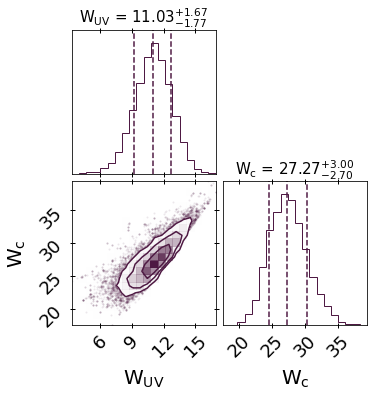

<IPython.core.display.Math object>

<IPython.core.display.Math object>

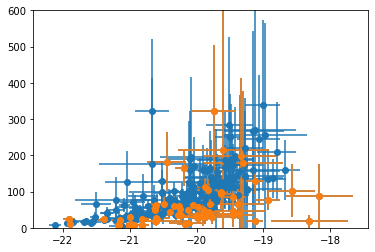

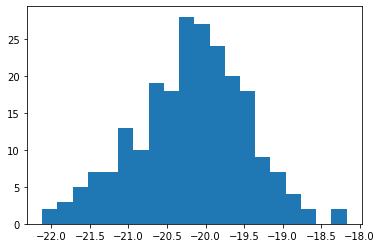

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 10/3000 [00:00<03:14, 15.41it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  9%|▉         | 280/3000 [00:39<06:30,  6.96it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

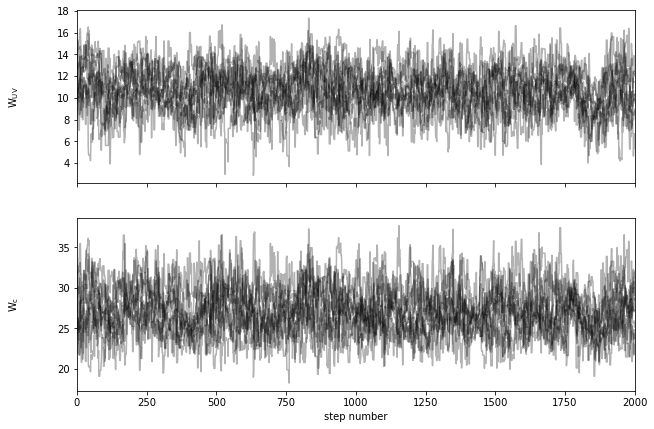

(20000, 2)


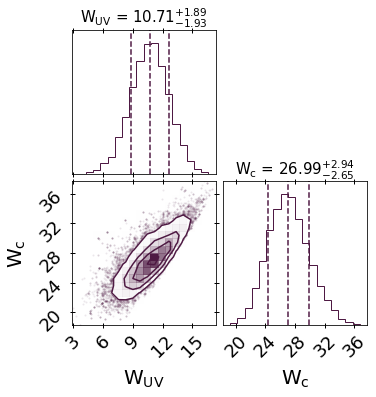

<IPython.core.display.Math object>

<IPython.core.display.Math object>

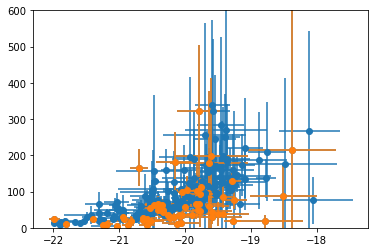

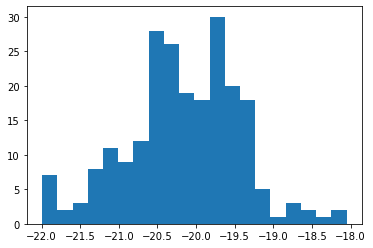

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  3%|▎         | 99/3000 [00:14<07:09,  6.76it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 147/3000 [00:21<07:15,  6.56it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

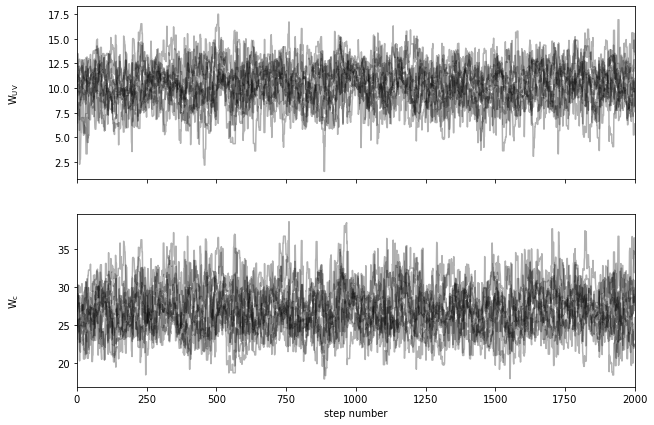

(20000, 2)


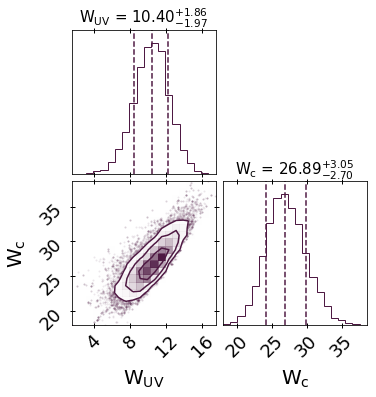

<IPython.core.display.Math object>

<IPython.core.display.Math object>

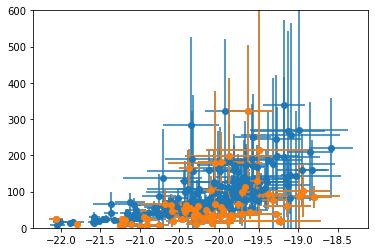

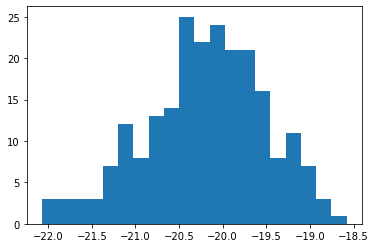

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 2/3000 [00:00<02:46, 18.03it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 12%|█▏        | 369/3000 [00:49<05:33,  7.89it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 17%|█▋        | 506/3000 [01:09<05:26,  7.63it/s]<ipython-input-5-ccb42e6453df>:74: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(model))
 68%|

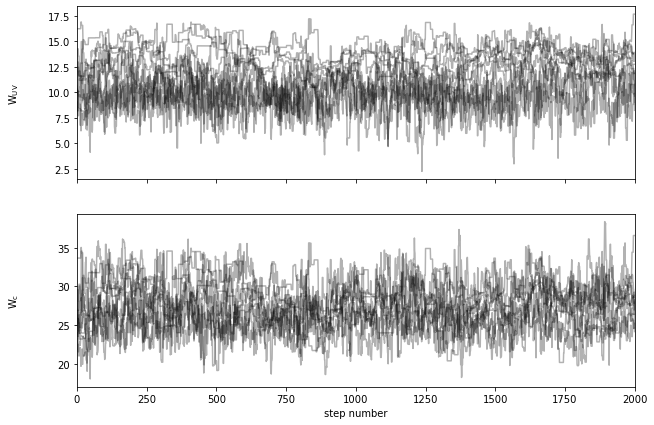

(20000, 2)


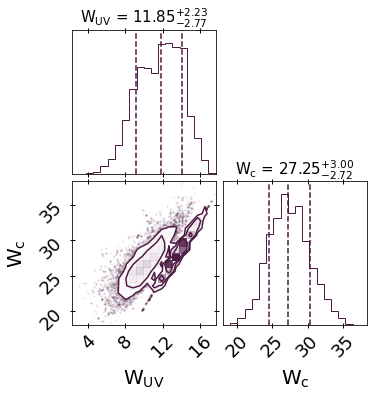

<IPython.core.display.Math object>

<IPython.core.display.Math object>

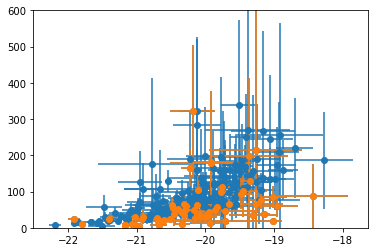

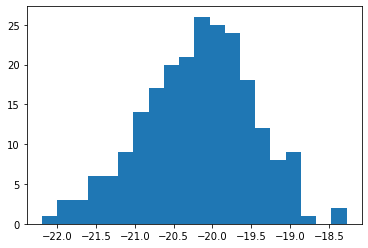

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  3%|▎         | 93/3000 [00:07<04:06, 11.81it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  4%|▎         | 107/3000 [00:08<04:10, 11.57it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 34%|███▍      | 1021/3000 [02:01<04:11,  7.85it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(d

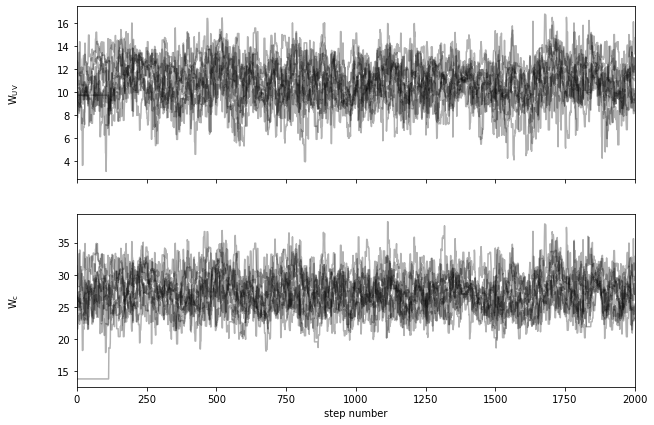

(20000, 2)


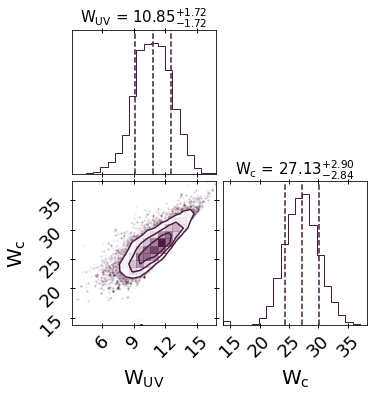

<IPython.core.display.Math object>

<IPython.core.display.Math object>

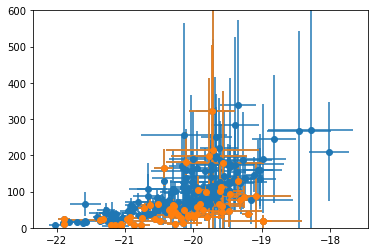

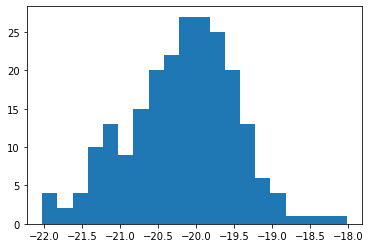

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 4/3000 [00:00<03:27, 14.44it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 8/3000 [00:00<03:40, 13.55it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  9%|▉         | 280/3000 [00:40<07:18,  6.20it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2

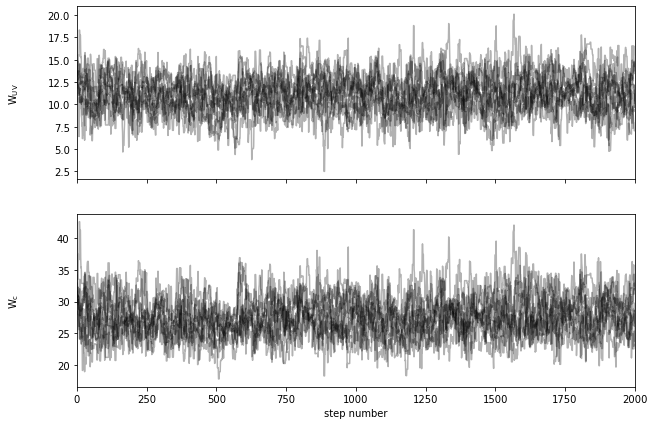

(20000, 2)


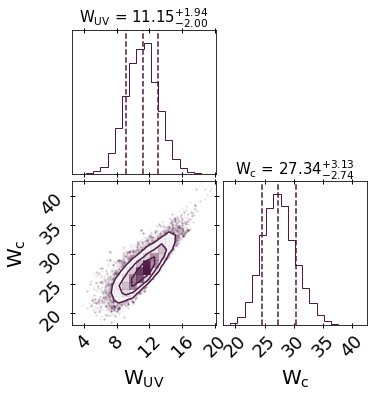

<IPython.core.display.Math object>

<IPython.core.display.Math object>

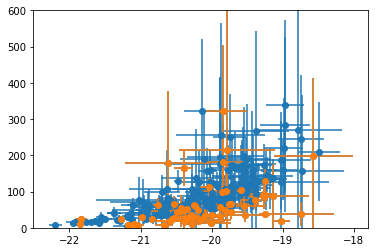

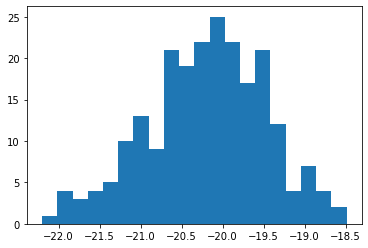

  0%|          | 0/3000 [00:00<?, ?it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
 35%|███▍      | 1047/3000 [02:12<09:18,  3.50it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [08:26<00:00,  5.92it/s]


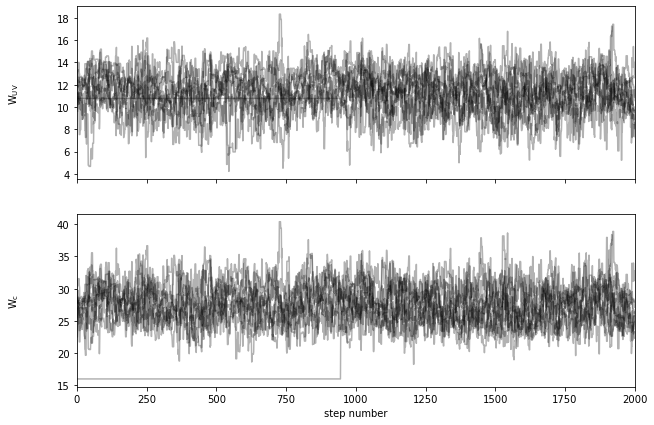

(20000, 2)


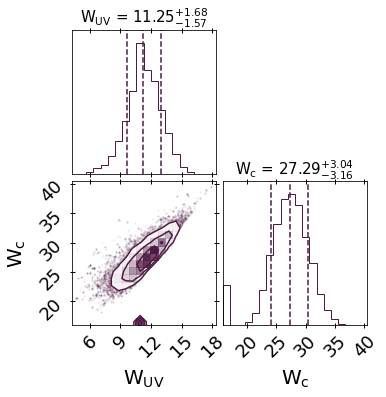

<IPython.core.display.Math object>

<IPython.core.display.Math object>

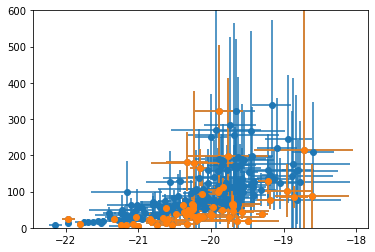

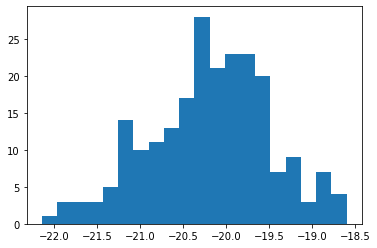

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 45/3000 [00:04<04:42, 10.45it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 334/3000 [00:50<07:25,  5.98it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

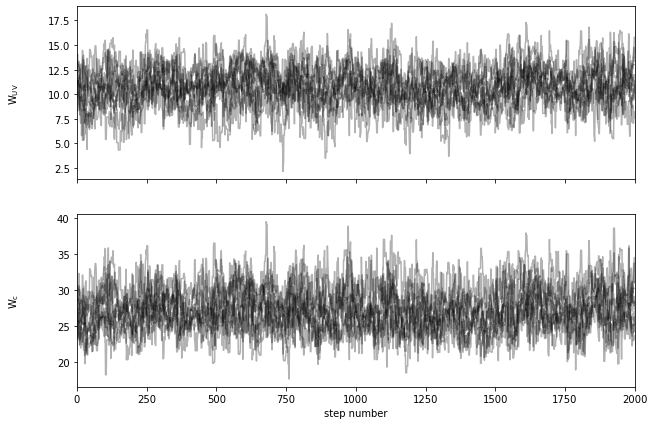

(20000, 2)


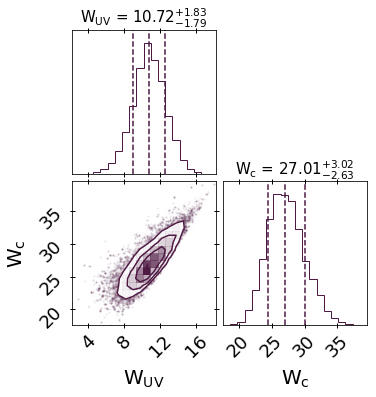

<IPython.core.display.Math object>

<IPython.core.display.Math object>

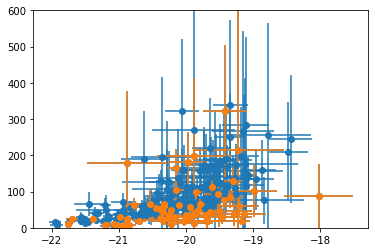

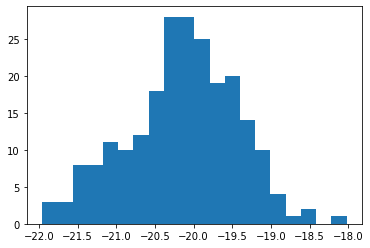

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  2%|▏         | 48/3000 [00:07<09:19,  5.28it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 59/3000 [00:09<08:29,  5.77it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 26%|██▌       | 786/3000 [02:29<07:36,  4.85it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

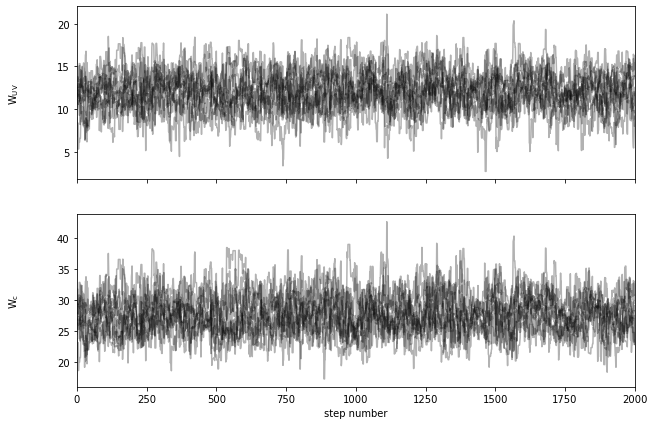

(20000, 2)


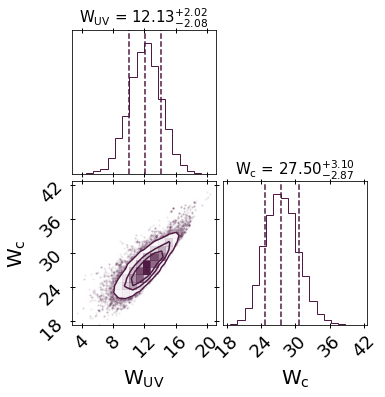

<IPython.core.display.Math object>

<IPython.core.display.Math object>

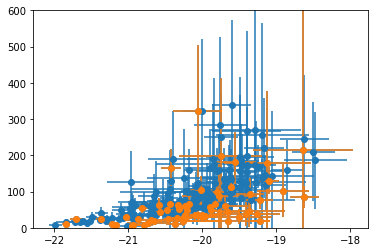

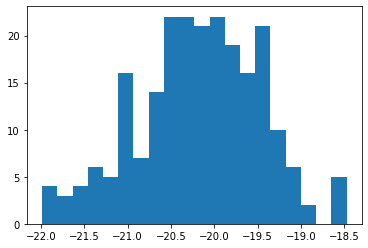

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  2%|▏         | 45/3000 [00:06<07:36,  6.47it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 147/3000 [00:23<07:58,  5.96it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

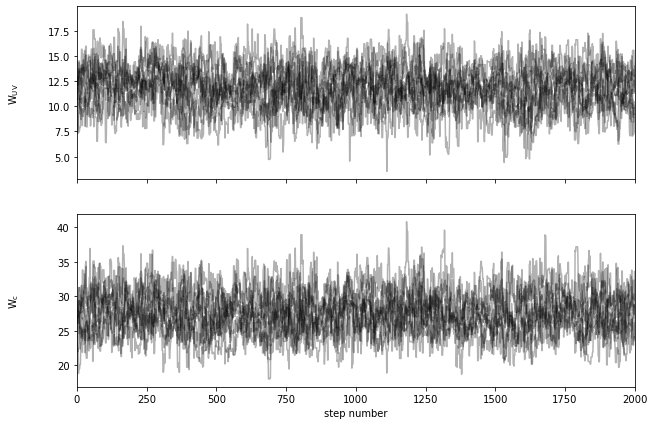

(20000, 2)


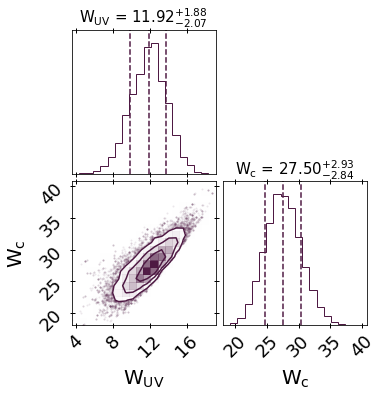

<IPython.core.display.Math object>

<IPython.core.display.Math object>

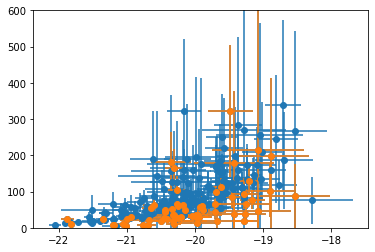

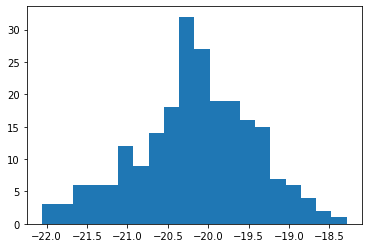

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 36/3000 [00:04<06:22,  7.75it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 55/3000 [00:06<06:38,  7.39it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 147/3000 [00:21<07:39,  6.20it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

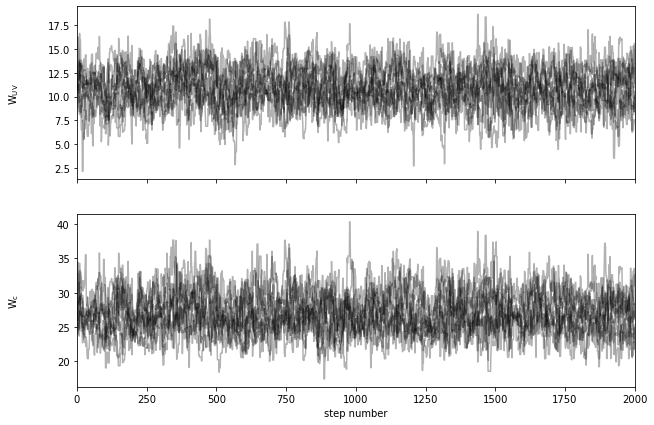

(20000, 2)


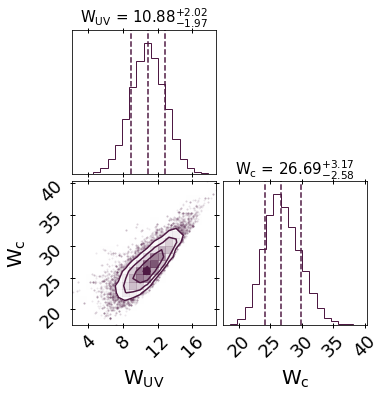

<IPython.core.display.Math object>

<IPython.core.display.Math object>

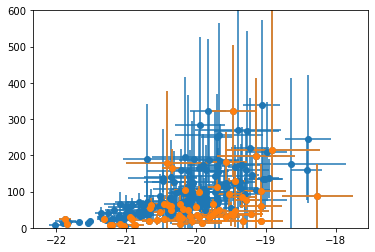

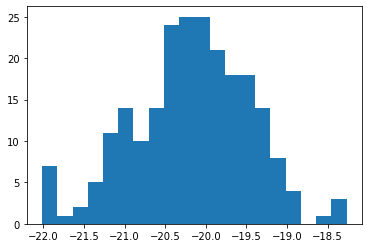

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 10/3000 [00:00<04:39, 10.68it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  3%|▎         | 103/3000 [00:13<07:17,  6.63it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 15%|█▍        | 442/3000 [01:13<07:14,  5.88it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dE

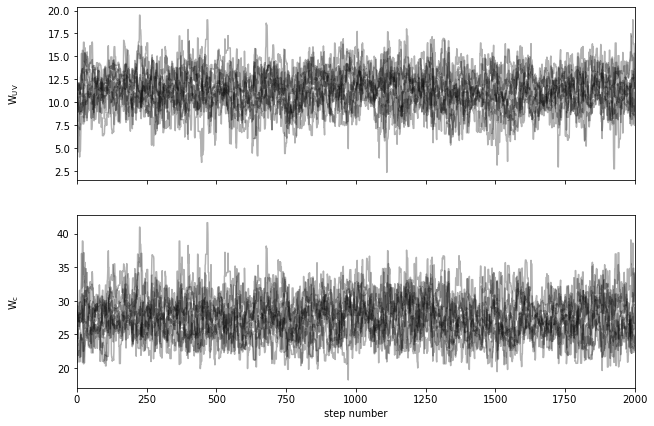

(20000, 2)


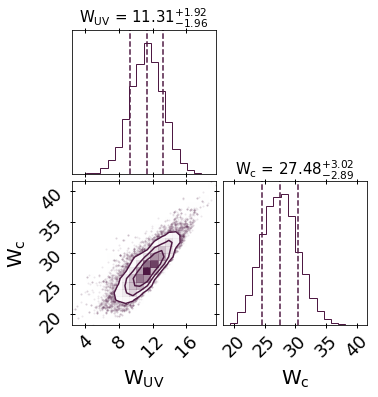

<IPython.core.display.Math object>

<IPython.core.display.Math object>

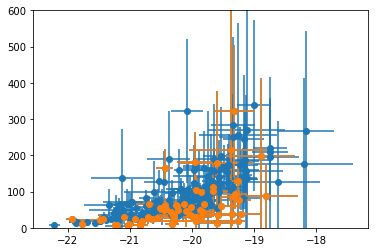

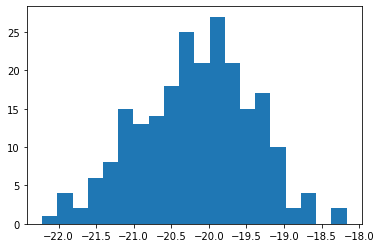

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 11/3000 [00:00<02:47, 17.90it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  1%|          | 25/3000 [00:01<04:23, 11.28it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 52%|█████▏    | 1566/3000 [03:45<04:02,  5.91it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dE

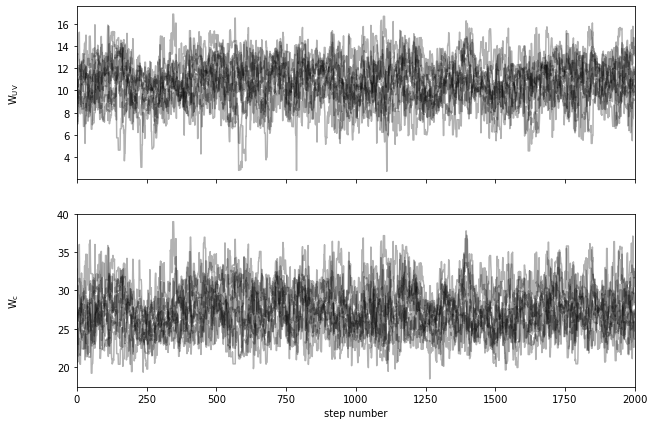

(20000, 2)


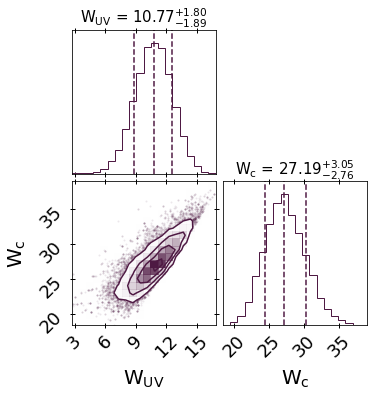

<IPython.core.display.Math object>

<IPython.core.display.Math object>

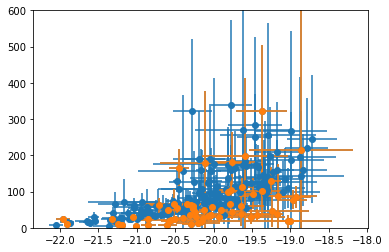

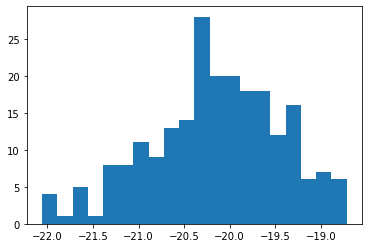

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 2/3000 [00:00<02:59, 16.74it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 12%|█▏        | 369/3000 [00:55<07:47,  5.63it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|█

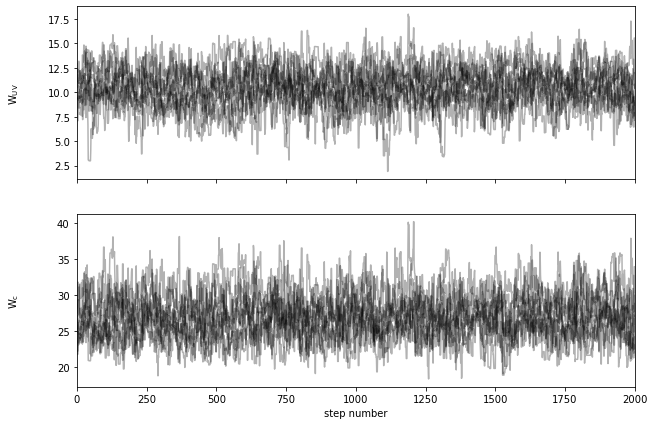

(20000, 2)


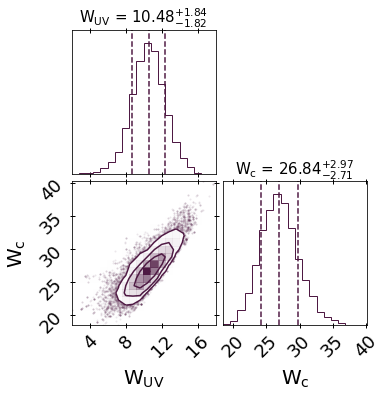

<IPython.core.display.Math object>

<IPython.core.display.Math object>

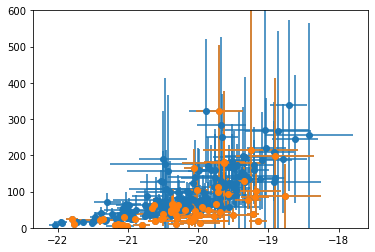

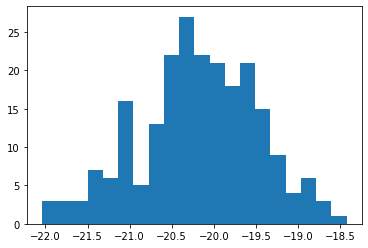

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
 14%|█▍        | 428/3000 [01:03<06:41,  6.40it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:40<00:00,  6.52it/s]


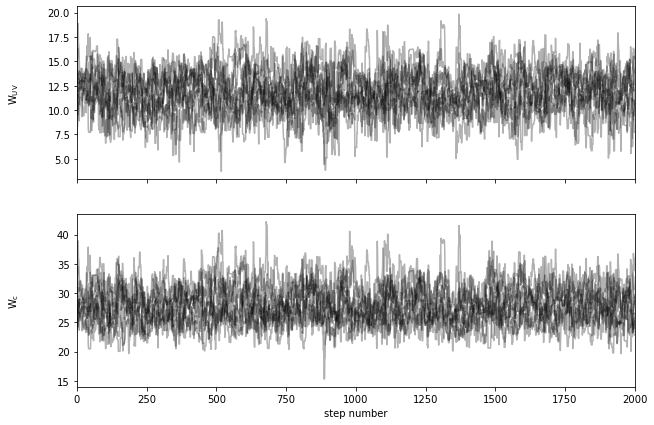

(20000, 2)


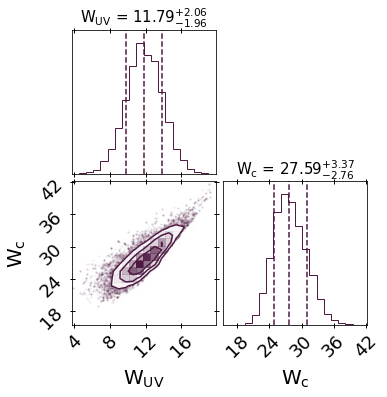

<IPython.core.display.Math object>

<IPython.core.display.Math object>

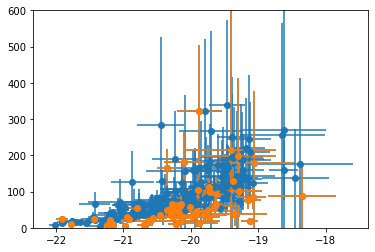

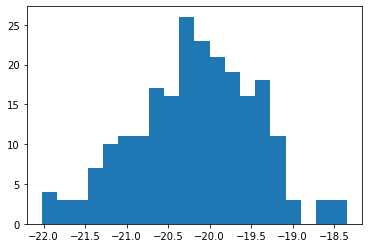

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 4/3000 [00:00<03:34, 13.95it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 322/3000 [00:49<07:14,  6.17it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|█

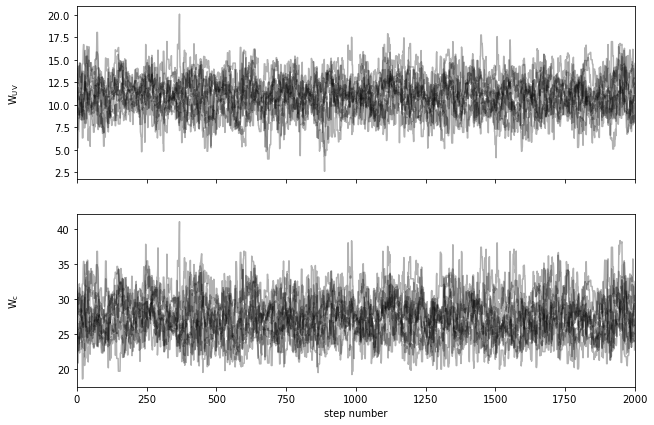

(20000, 2)


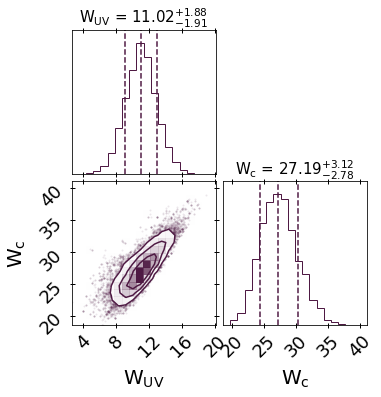

<IPython.core.display.Math object>

<IPython.core.display.Math object>

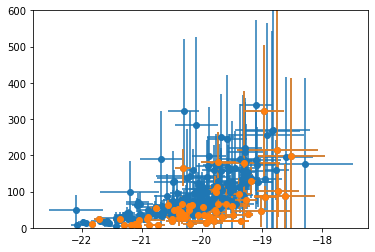

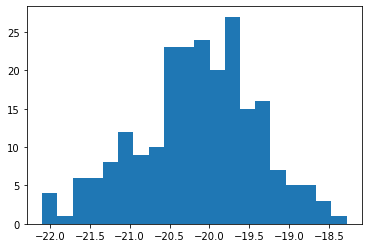

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
 38%|███▊      | 1145/3000 [02:39<04:13,  7.32it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:12<00:00,  6.93it/s]


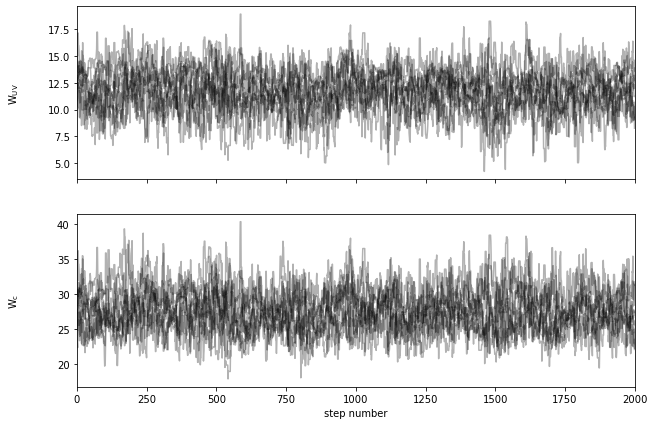

(20000, 2)


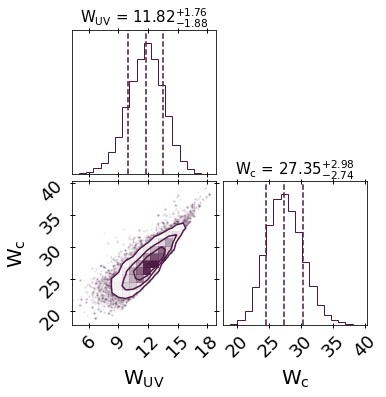

<IPython.core.display.Math object>

<IPython.core.display.Math object>

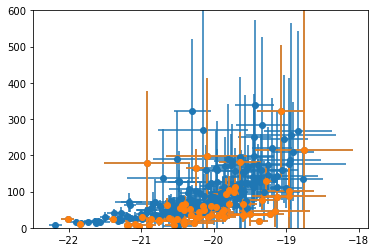

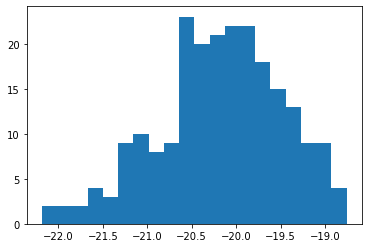

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  2%|▏         | 62/3000 [00:05<04:47, 10.21it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  4%|▍         | 133/3000 [00:13<05:16,  9.05it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  7%|▋         | 220/3000 [00:25<08:02,  5.76it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dE

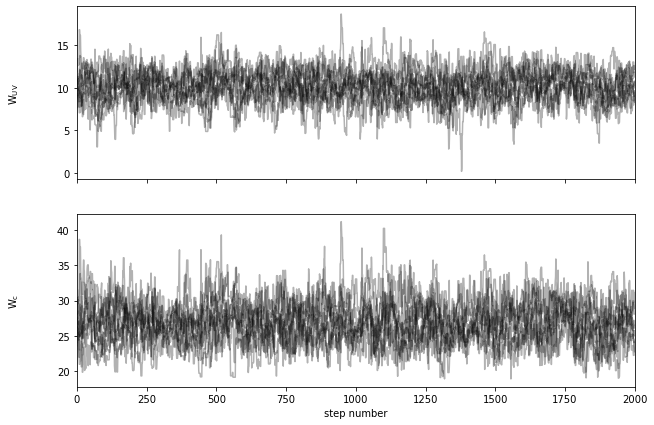

(20000, 2)


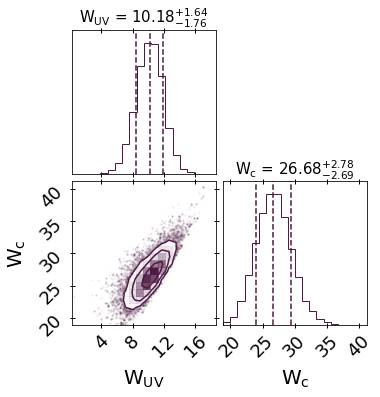

<IPython.core.display.Math object>

<IPython.core.display.Math object>

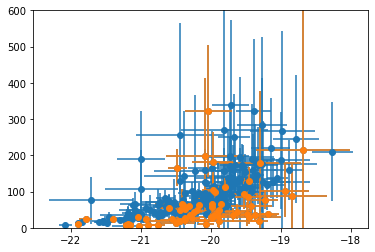

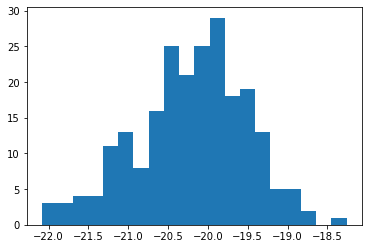

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 58/3000 [00:06<06:49,  7.18it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 28%|██▊       | 838/3000 [01:58<05:30,  6.53it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

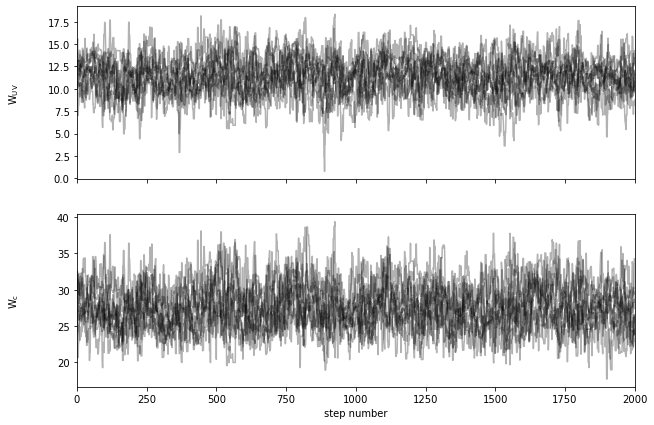

(20000, 2)


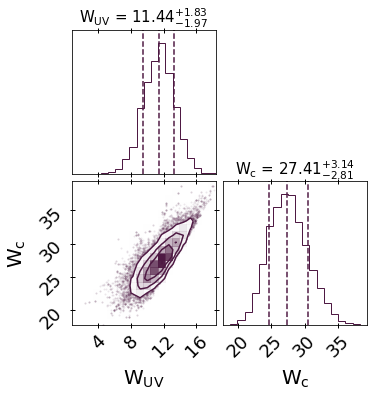

<IPython.core.display.Math object>

<IPython.core.display.Math object>

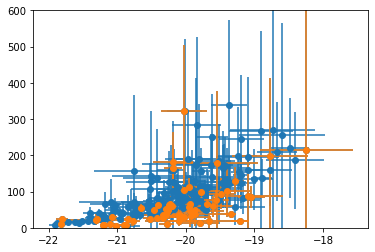

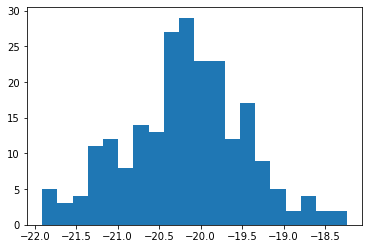

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 26/3000 [00:03<06:46,  7.32it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 15%|█▍        | 446/3000 [01:09<06:10,  6.89it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

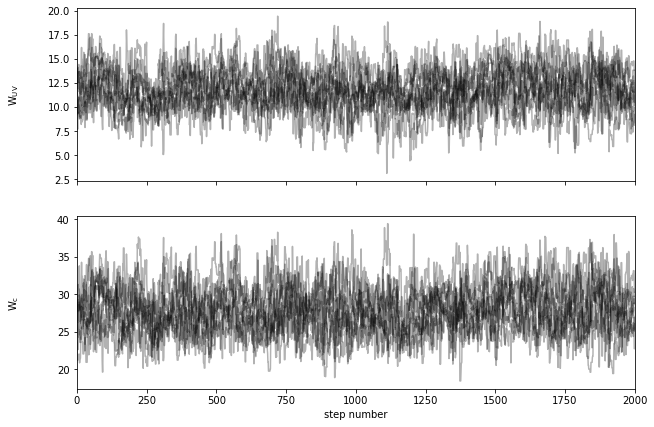

(20000, 2)


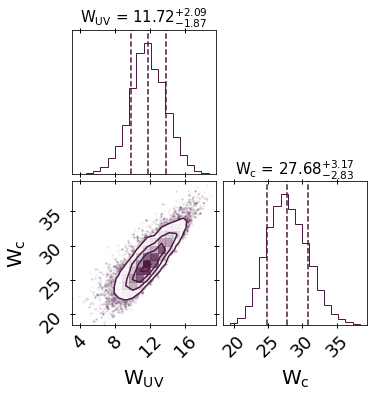

<IPython.core.display.Math object>

<IPython.core.display.Math object>

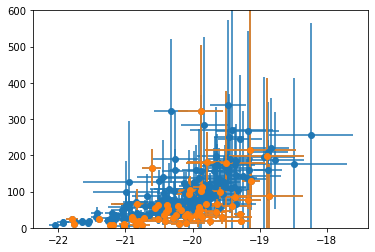

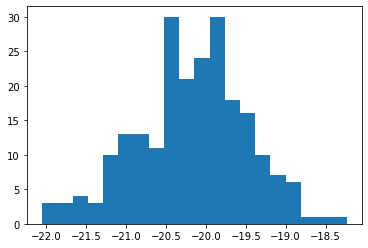

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|▏         | 39/3000 [00:03<05:15,  9.39it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 21%|██        | 624/3000 [01:32<06:05,  6.50it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

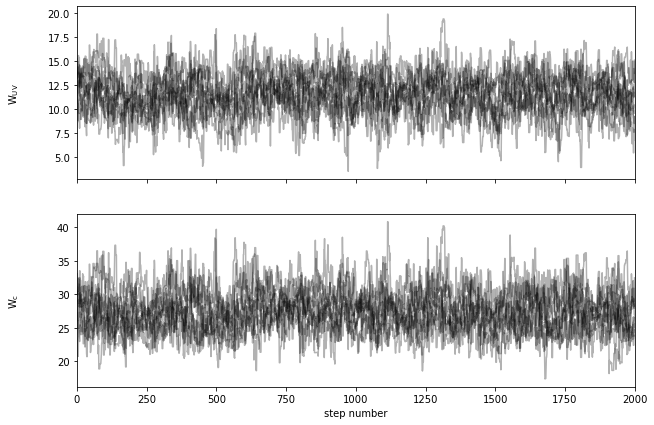

(20000, 2)


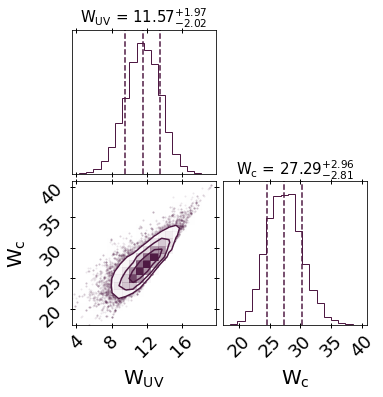

<IPython.core.display.Math object>

<IPython.core.display.Math object>

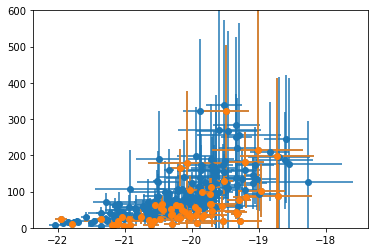

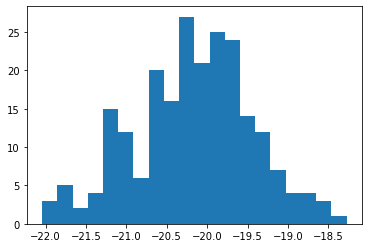

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 10/3000 [00:00<03:54, 12.76it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  7%|▋         | 220/3000 [00:31<08:32,  5.43it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

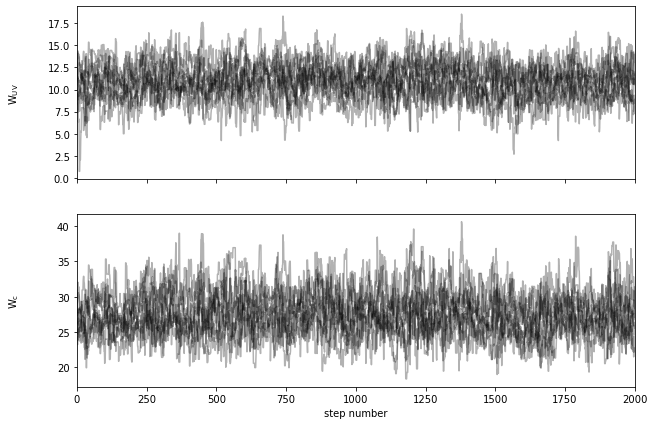

(20000, 2)


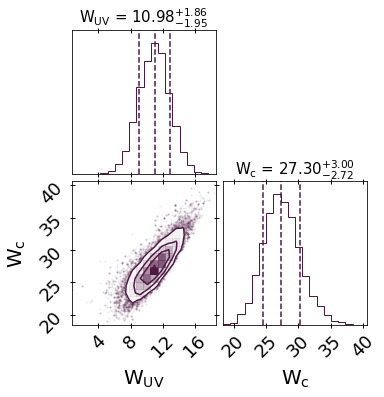

<IPython.core.display.Math object>

<IPython.core.display.Math object>

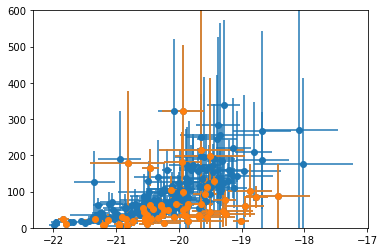

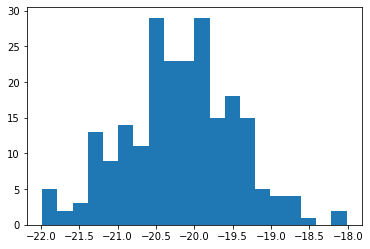

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
 13%|█▎        | 384/3000 [00:57<06:46,  6.44it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:49<00:00,  6.40it/s]


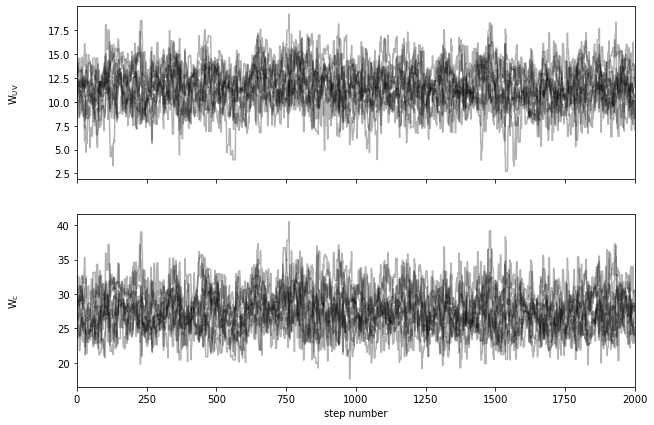

(20000, 2)


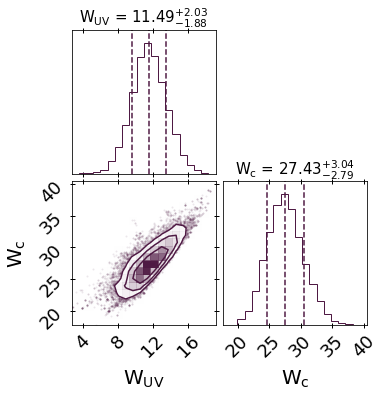

<IPython.core.display.Math object>

<IPython.core.display.Math object>

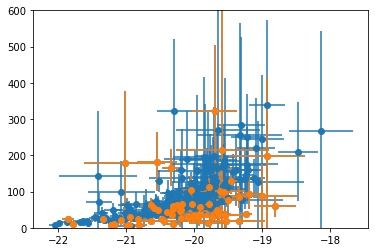

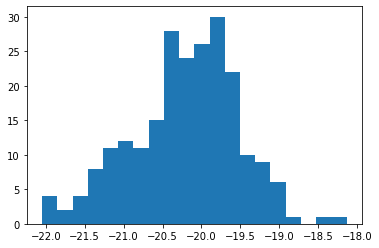

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|▏         | 41/3000 [00:04<06:18,  7.82it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 69/3000 [00:07<06:06,  7.99it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  8%|▊         | 229/3000 [00:28<06:23,  7.23it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

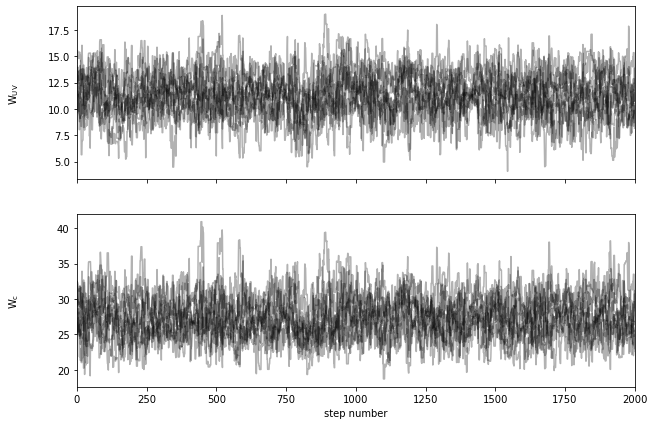

(20000, 2)


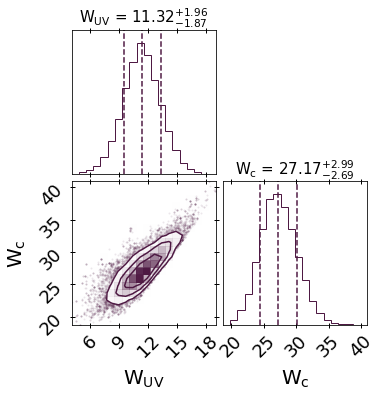

<IPython.core.display.Math object>

<IPython.core.display.Math object>

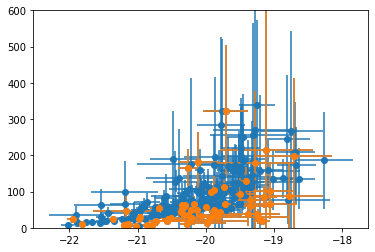

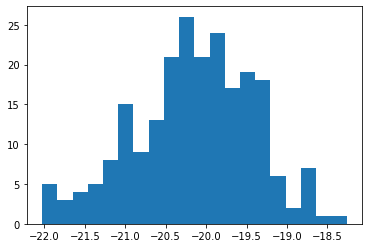

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 4/3000 [00:00<03:30, 14.20it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 10/3000 [00:00<04:01, 12.37it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█▏        | 339/3000 [00:50<12:31,  3.54it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_

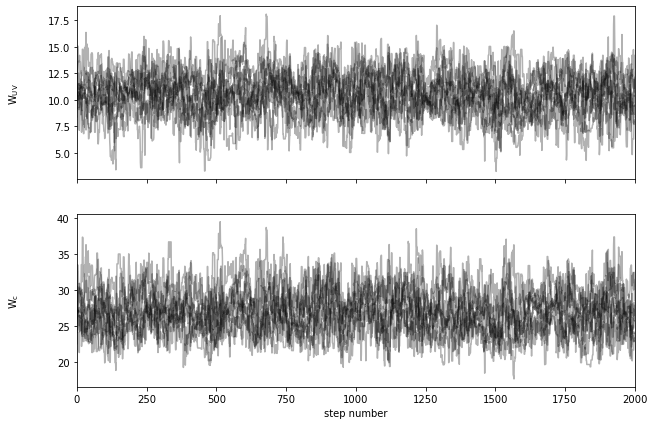

(20000, 2)


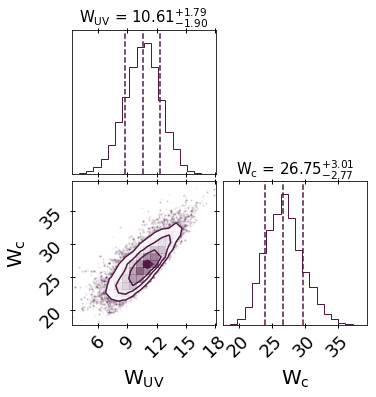

<IPython.core.display.Math object>

<IPython.core.display.Math object>

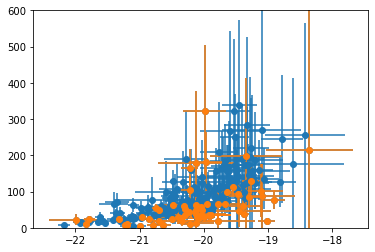

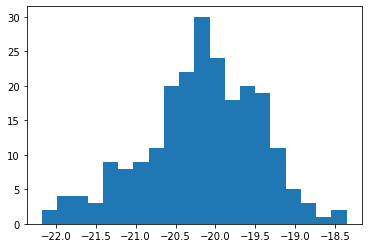

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 1/3000 [00:00<06:48,  7.35it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 10/3000 [00:00<03:17, 15.11it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 51%|█████     | 1536/3000 [03:00<03:46,  6.46it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

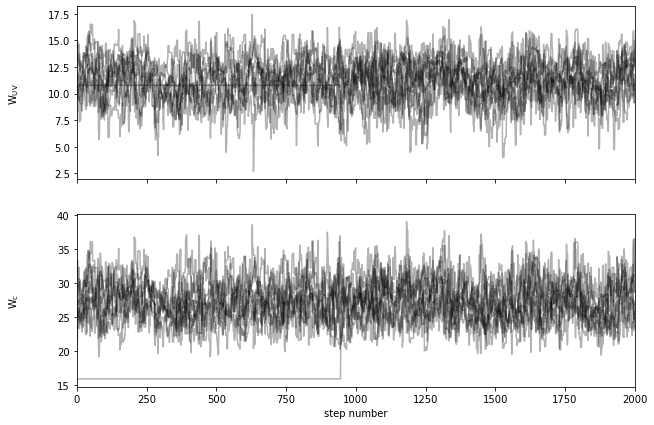

(20000, 2)


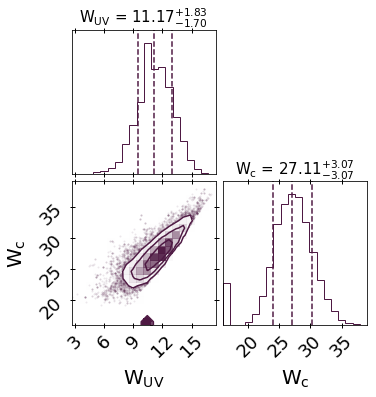

<IPython.core.display.Math object>

<IPython.core.display.Math object>

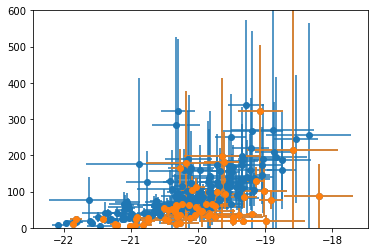

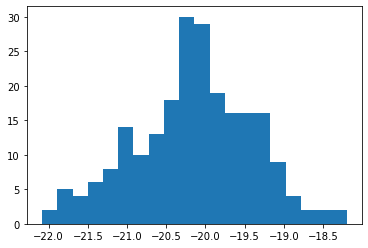

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 142/3000 [00:14<04:26, 10.71it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 19%|█▊        | 558/3000 [01:12<05:41,  7.15it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%

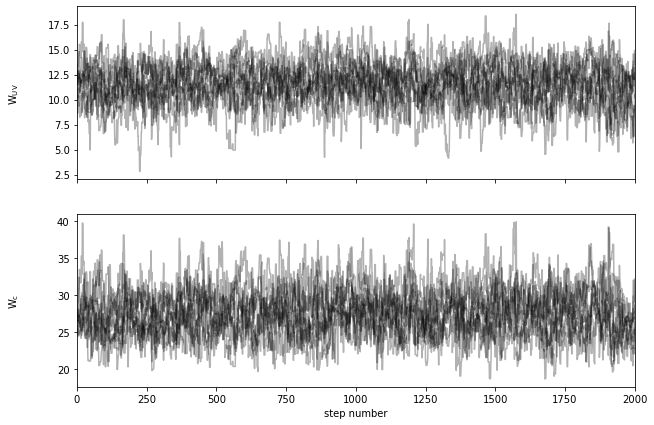

(20000, 2)


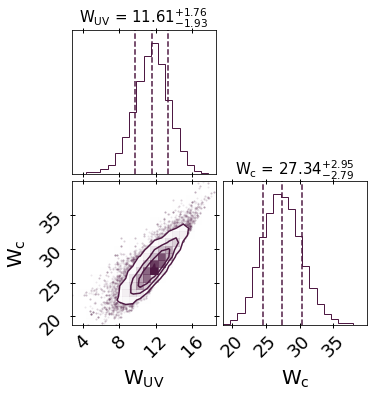

<IPython.core.display.Math object>

<IPython.core.display.Math object>

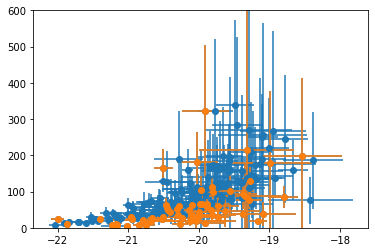

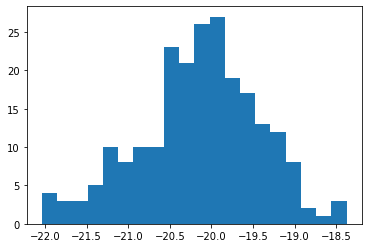

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 11/3000 [00:01<04:22, 11.39it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  7%|▋         | 201/3000 [00:29<07:03,  6.61it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 18%|█▊        | 544/3000 [01:24<06:37,  6.18it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dE

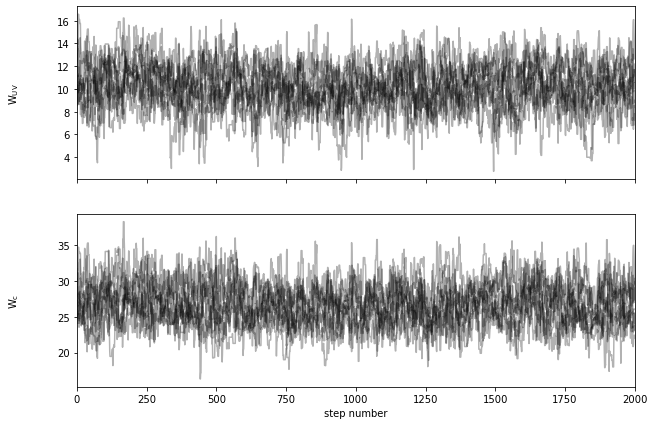

(20000, 2)


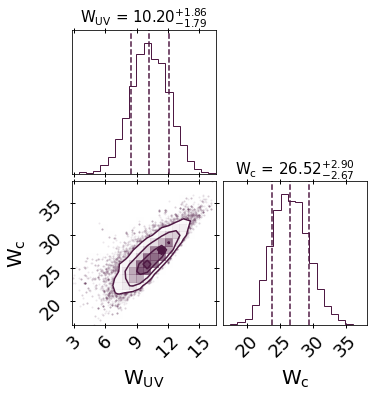

<IPython.core.display.Math object>

<IPython.core.display.Math object>

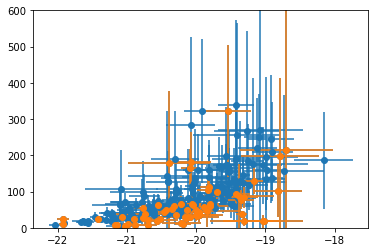

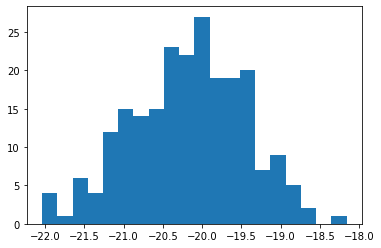

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
 11%|█         | 316/3000 [00:46<06:40,  6.71it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:36<00:00,  6.57it/s]


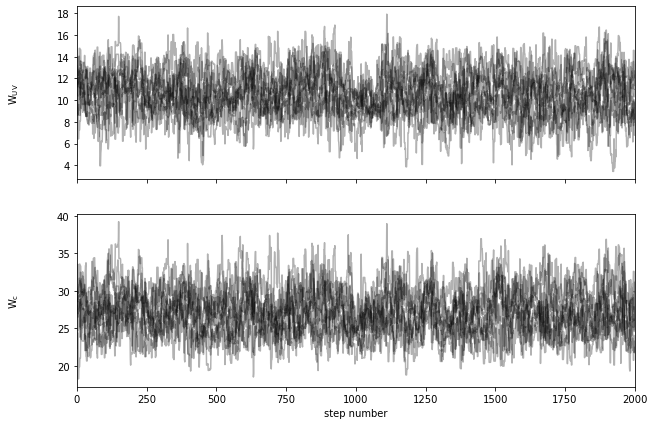

(20000, 2)


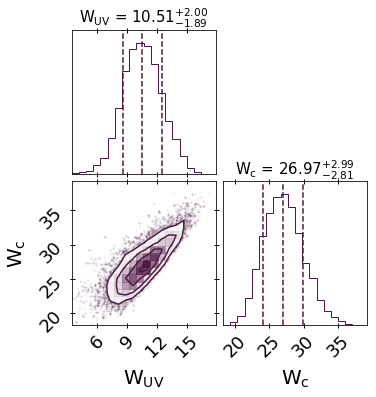

<IPython.core.display.Math object>

<IPython.core.display.Math object>

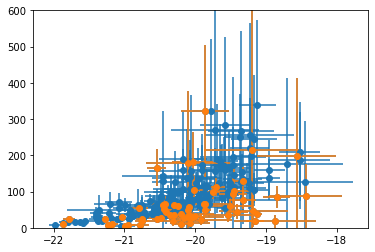

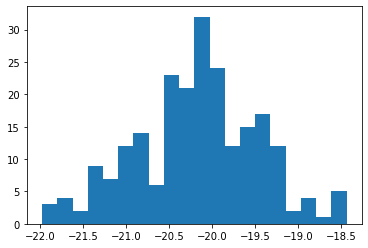

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 12%|█▏        | 369/3000 [00:52<07:16,  6.03it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:25<00:00,  6.73it/s]


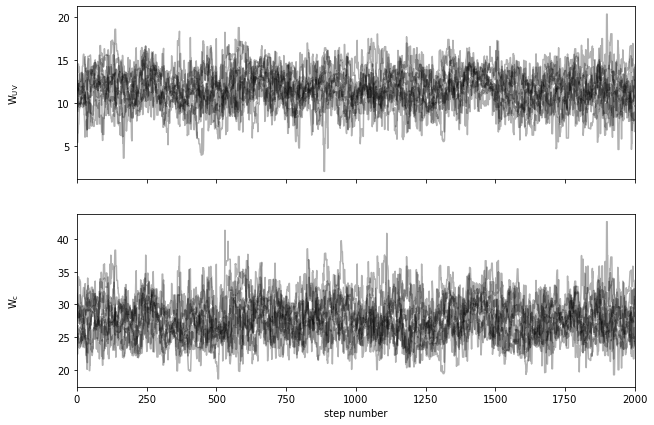

(20000, 2)


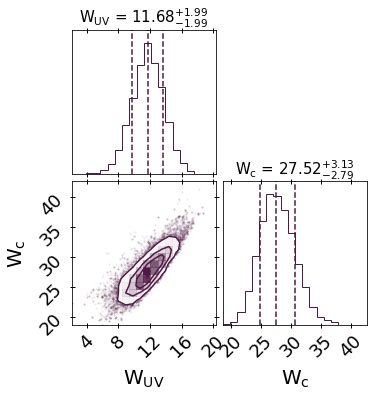

<IPython.core.display.Math object>

<IPython.core.display.Math object>

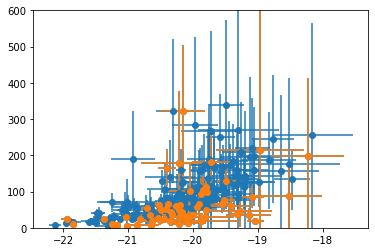

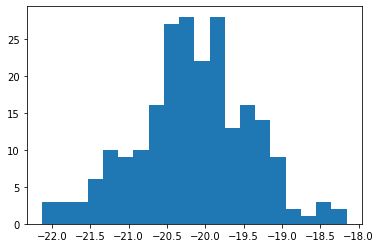

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 10/3000 [00:00<03:15, 15.27it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  1%|          | 18/3000 [00:01<04:34, 10.85it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 337/3000 [00:45<06:10,  7.20it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

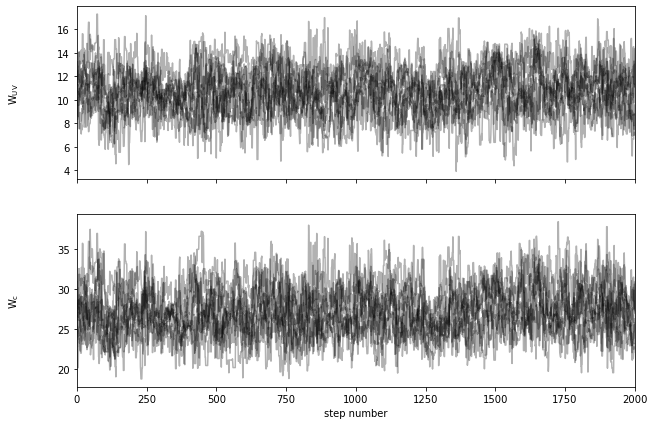

(20000, 2)


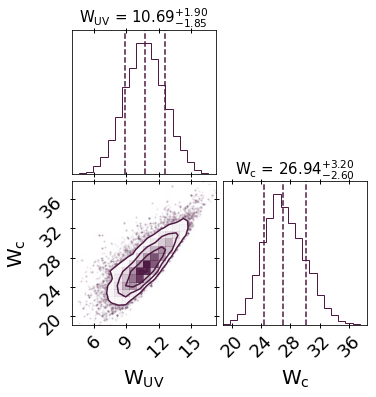

<IPython.core.display.Math object>

<IPython.core.display.Math object>

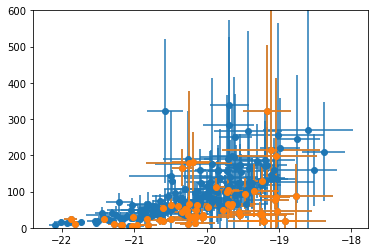

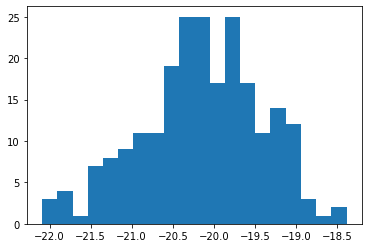

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|▏         | 44/3000 [00:04<05:04,  9.70it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  8%|▊         | 227/3000 [00:30<06:29,  7.12it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

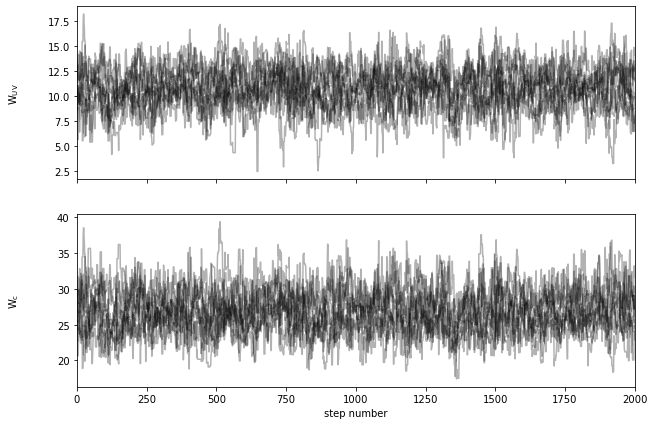

(20000, 2)


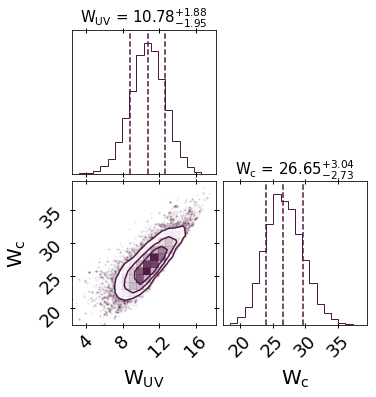

<IPython.core.display.Math object>

<IPython.core.display.Math object>

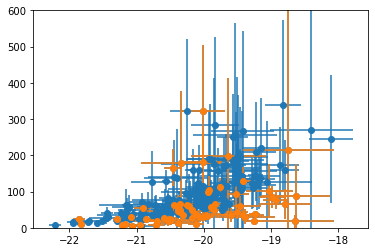

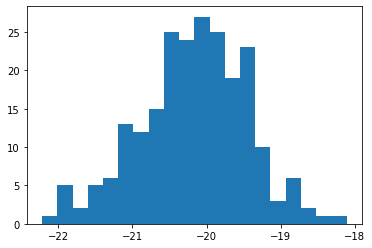

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 9/3000 [00:00<02:31, 19.74it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 142/3000 [00:10<03:30, 13.57it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 85%|████████▍ | 2537/3000 [05:35<01:02,  7.45it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dE

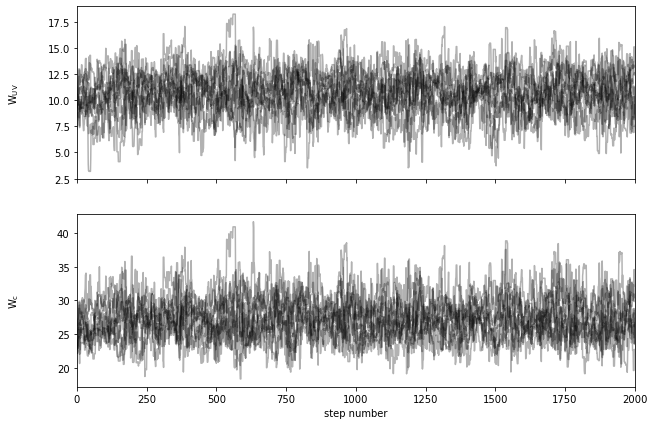

(20000, 2)


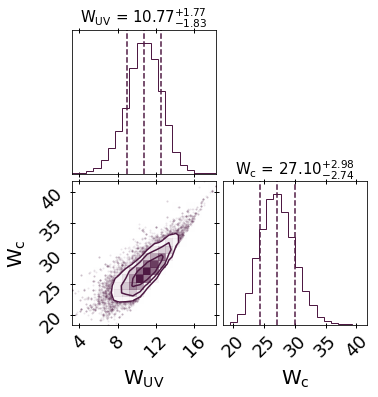

<IPython.core.display.Math object>

<IPython.core.display.Math object>

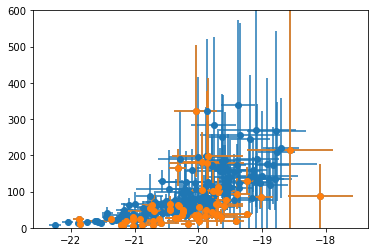

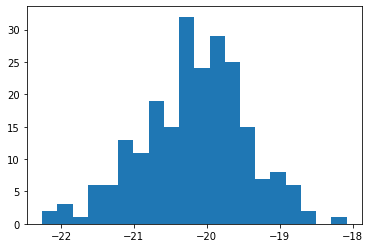

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 4/3000 [00:00<01:17, 38.48it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 63/3000 [00:04<04:07, 11.88it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 15%|█▍        | 445/3000 [00:39<04:03, 10.50it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_

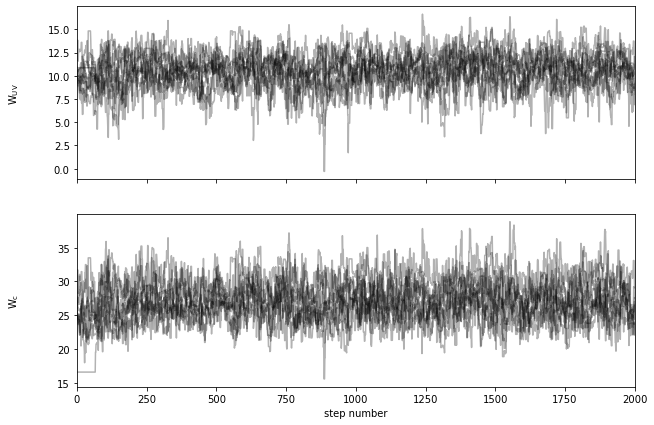

(20000, 2)


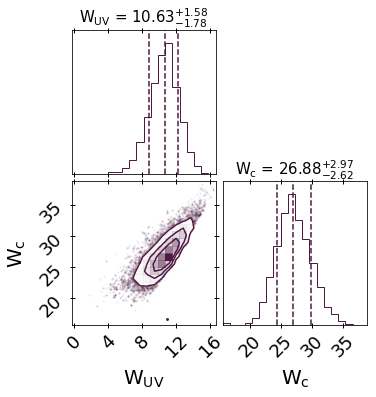

<IPython.core.display.Math object>

<IPython.core.display.Math object>

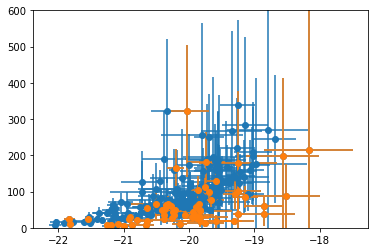

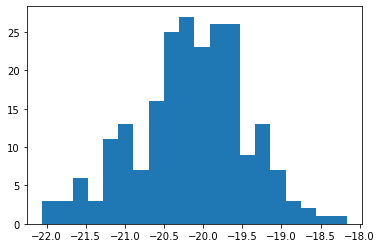

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 33/3000 [00:03<06:21,  7.78it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 21%|██        | 616/3000 [01:25<05:39,  7.03it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

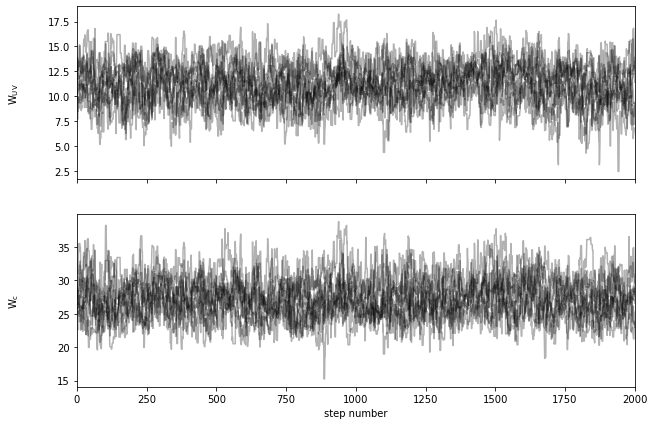

(20000, 2)


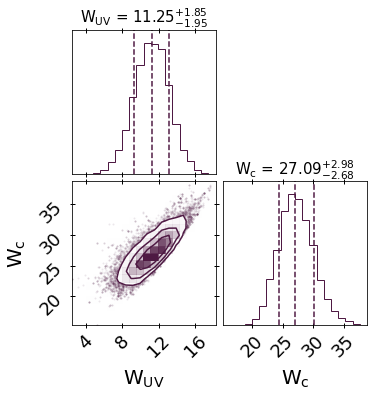

<IPython.core.display.Math object>

<IPython.core.display.Math object>

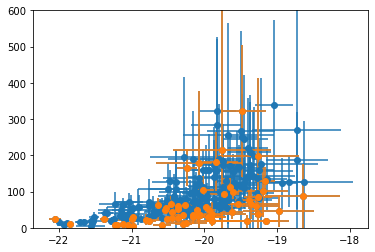

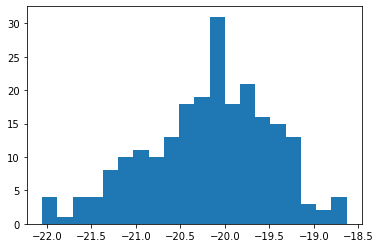

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  5%|▌         | 163/3000 [00:22<07:01,  6.73it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 12%|█▏        | 369/3000 [00:52<05:39,  7.76it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 21%|██        | 628/3000 [01:27<05:46,  6.85it/s]<ipython-input-5-ccb42e6453df>:74: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(model))
 96

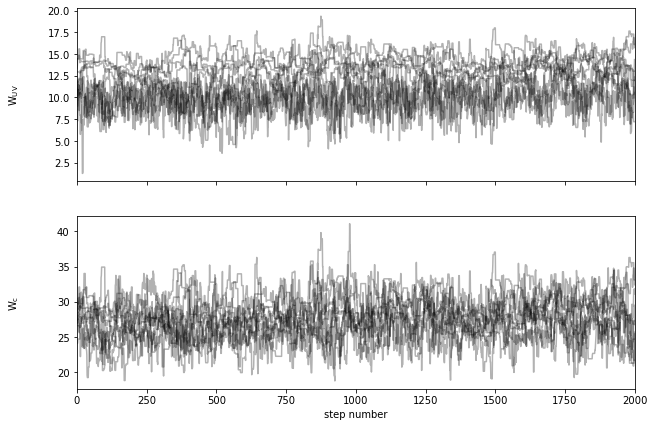

(20000, 2)


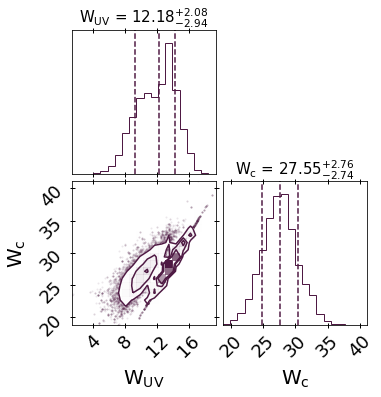

<IPython.core.display.Math object>

<IPython.core.display.Math object>

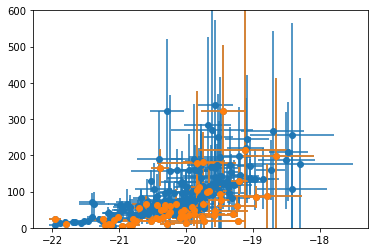

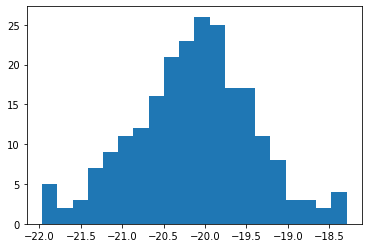

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  2%|▏         | 56/3000 [00:07<07:37,  6.44it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  6%|▌         | 177/3000 [00:25<07:23,  6.36it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 18%|

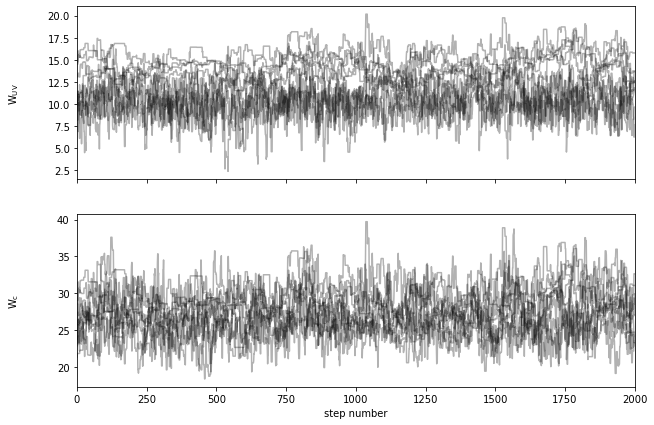

(20000, 2)


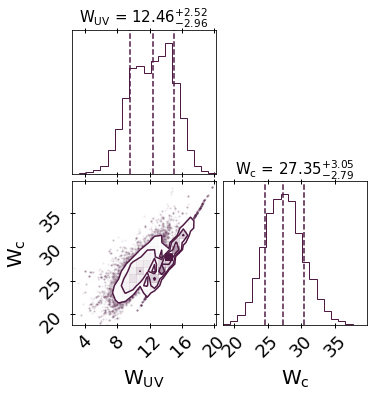

<IPython.core.display.Math object>

<IPython.core.display.Math object>

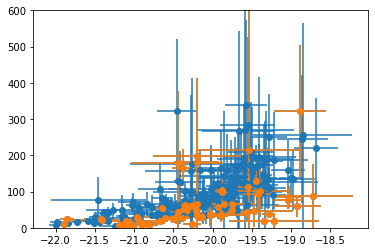

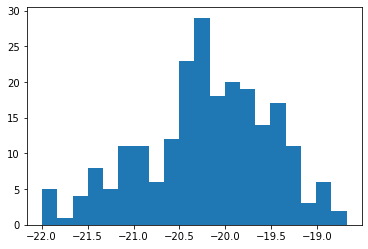

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 36/3000 [00:03<05:42,  8.66it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 49/3000 [00:05<06:29,  7.58it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 140/3000 [00:19<06:44,  7.07it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

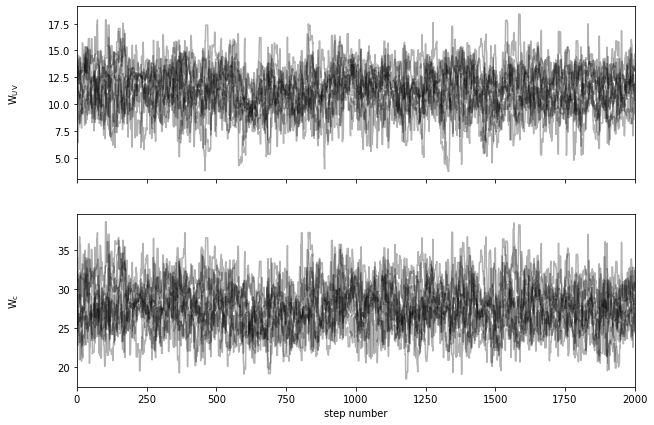

(20000, 2)


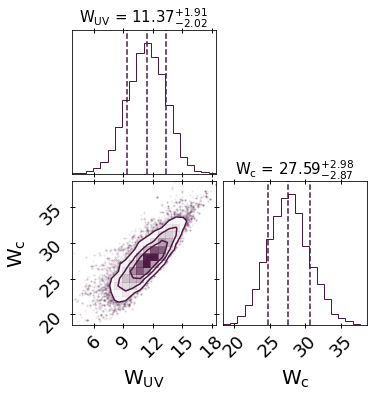

<IPython.core.display.Math object>

<IPython.core.display.Math object>

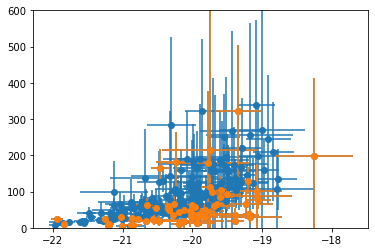

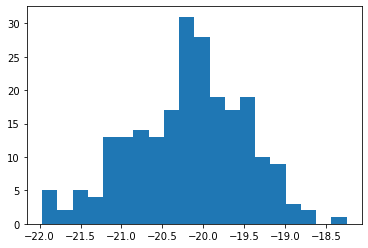

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  5%|▍         | 142/3000 [00:20<07:02,  6.76it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 22%|██▏       | 650/3000 [01:38<05:42,  6.85it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 34%|███▎      | 1009/3000 [02:33<05:05,  6.52it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(

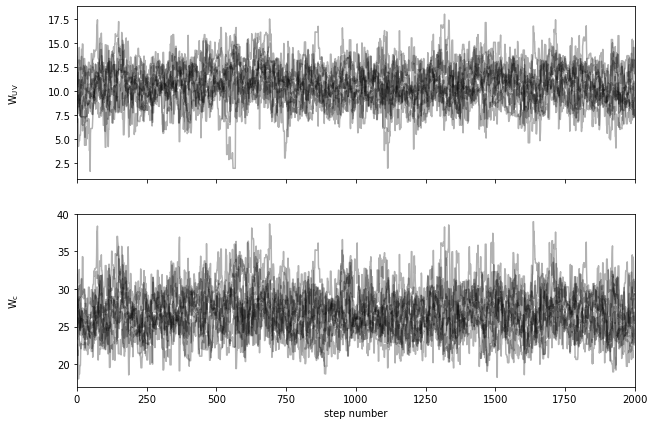

(20000, 2)


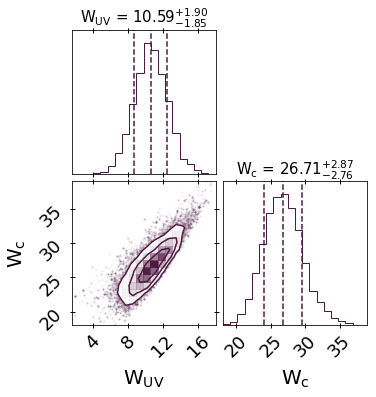

<IPython.core.display.Math object>

<IPython.core.display.Math object>

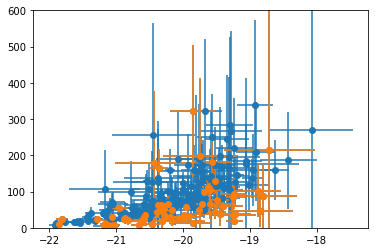

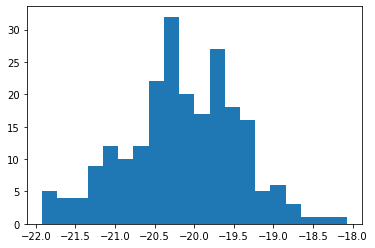

  0%|          | 0/3000 [00:00<?, ?it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  7%|▋         | 207/3000 [00:30<07:05,  6.57it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:36<00:00,  6.57it/s]


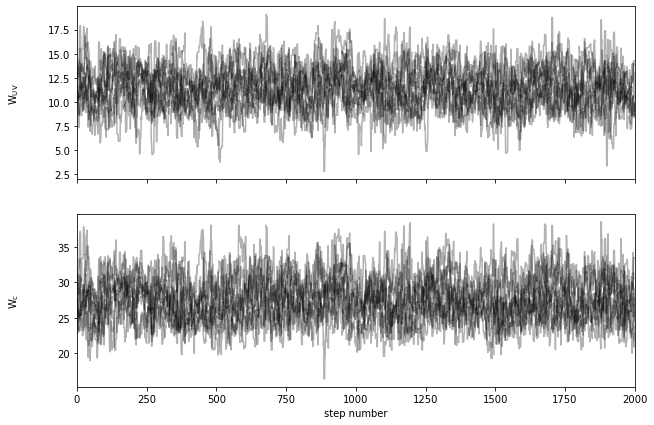

(20000, 2)


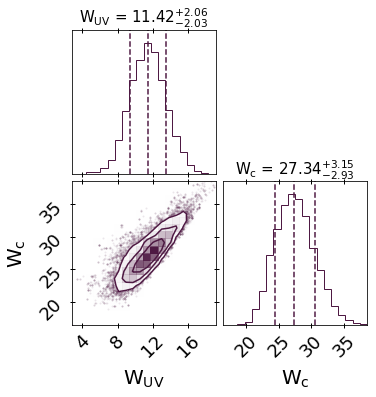

<IPython.core.display.Math object>

<IPython.core.display.Math object>

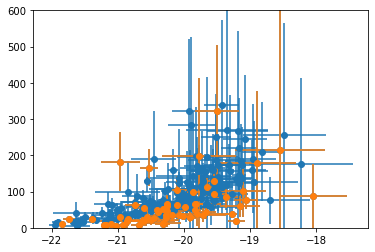

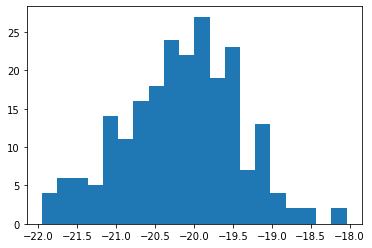

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
 12%|█▏        | 369/3000 [00:52<06:26,  6.81it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 13%|█▎        | 391/3000 [00:56<06:23,  6.80it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%

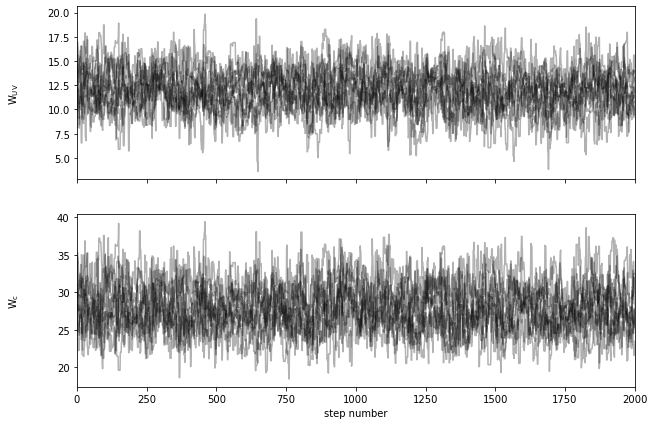

(20000, 2)


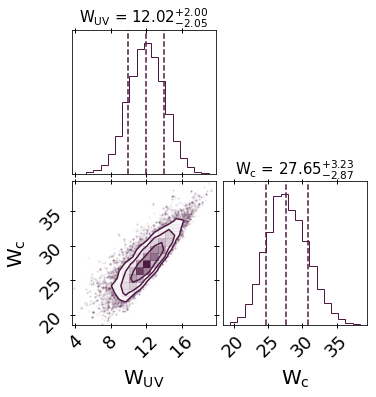

<IPython.core.display.Math object>

<IPython.core.display.Math object>

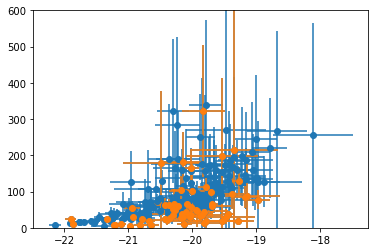

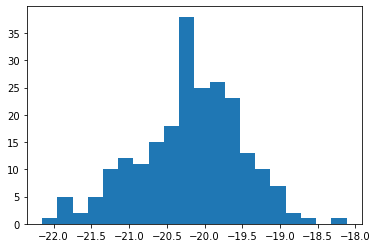

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 2/3000 [00:00<03:54, 12.77it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 16%|█▌        | 474/3000 [00:52<05:38,  7.47it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|█

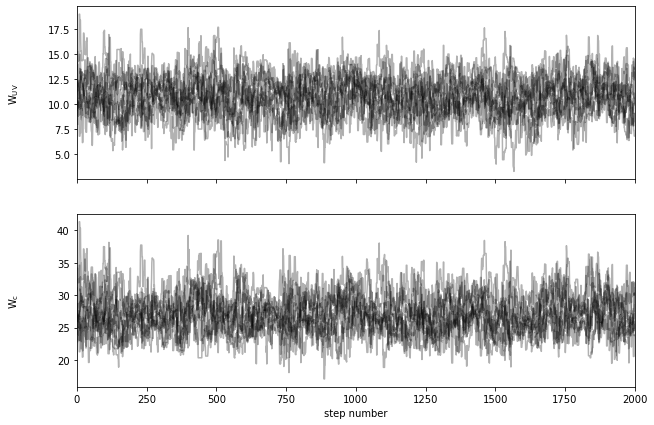

(20000, 2)


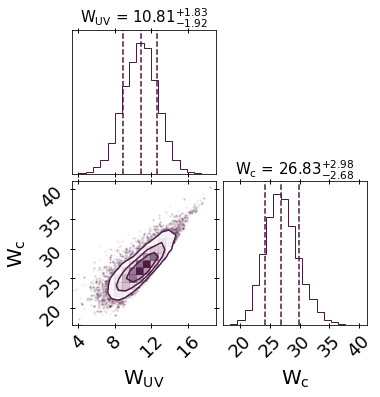

<IPython.core.display.Math object>

<IPython.core.display.Math object>

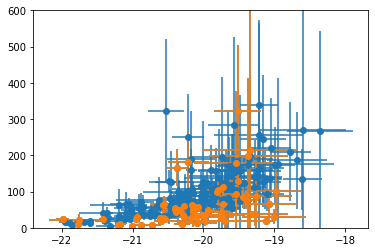

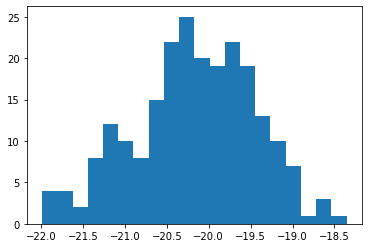

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  7%|▋         | 201/3000 [00:27<06:44,  6.93it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 10%|█         | 314/3000 [00:43<06:10,  7.26it/s]<ipython-input-5-ccb42e6453df>:74: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(model))
 40%|████      | 1208/3000 [02:47<04:13,  7.08it/s]<i

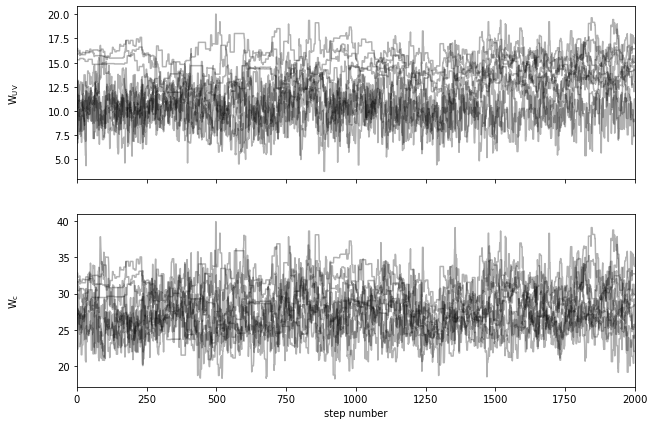

(20000, 2)


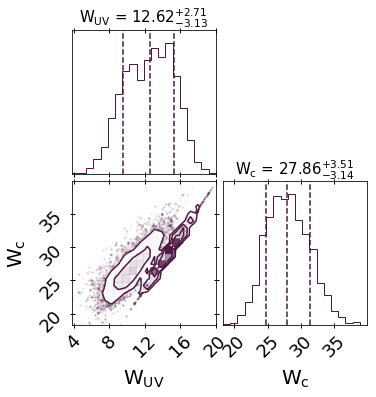

<IPython.core.display.Math object>

<IPython.core.display.Math object>

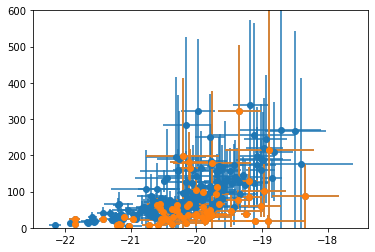

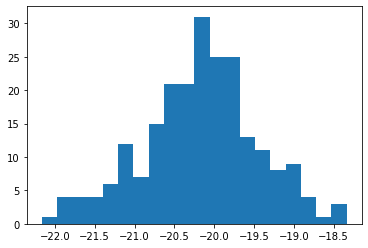

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 3/3000 [00:00<01:48, 27.67it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 13/3000 [00:00<03:30, 14.21it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  7%|▋         | 207/3000 [00:16<04:25, 10.50it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_

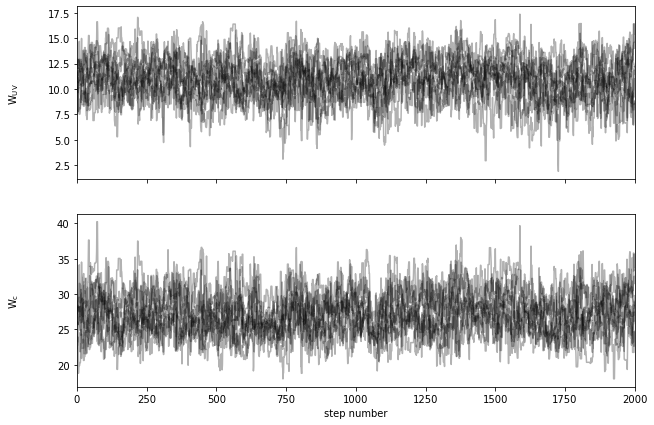

(20000, 2)


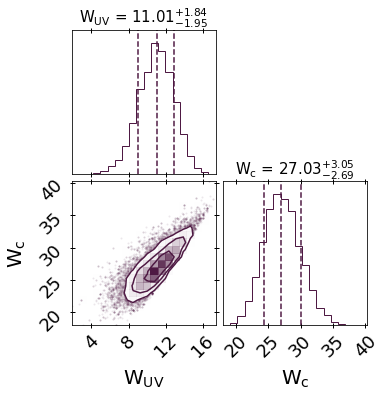

<IPython.core.display.Math object>

<IPython.core.display.Math object>

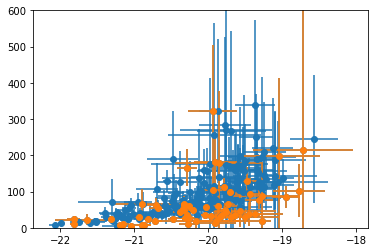

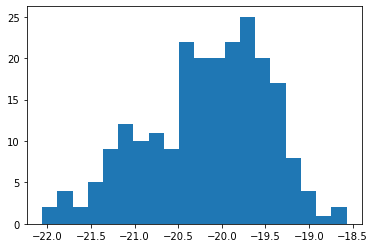

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 3/3000 [00:00<04:48, 10.37it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 9/3000 [00:00<03:51, 12.94it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 322/3000 [00:39<05:45,  7.75it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2

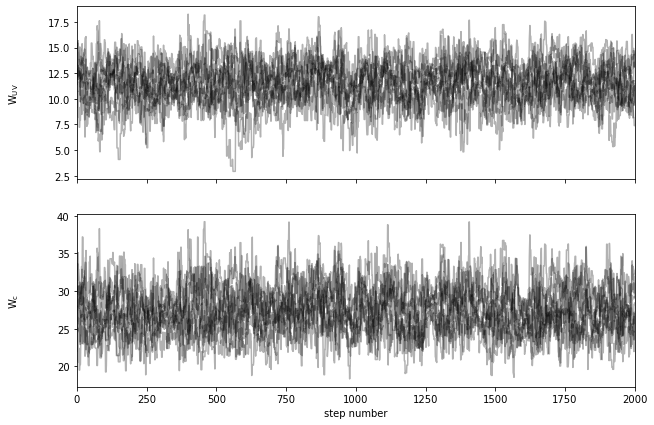

(20000, 2)


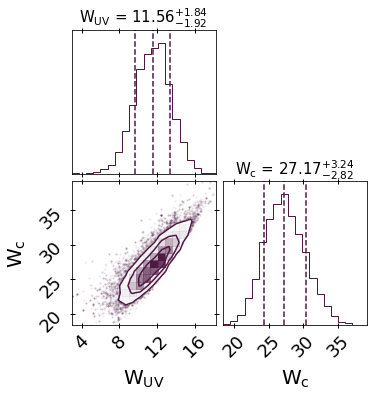

<IPython.core.display.Math object>

<IPython.core.display.Math object>

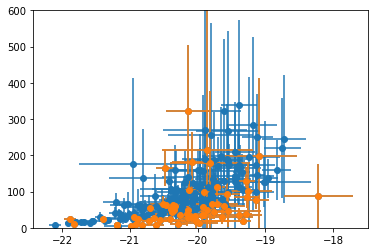

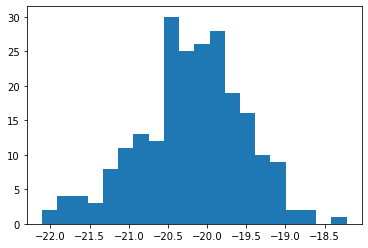

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 35/3000 [00:03<04:57,  9.97it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 45/3000 [00:04<04:40, 10.52it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  7%|▋         | 201/3000 [00:24<06:11,  7.54it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

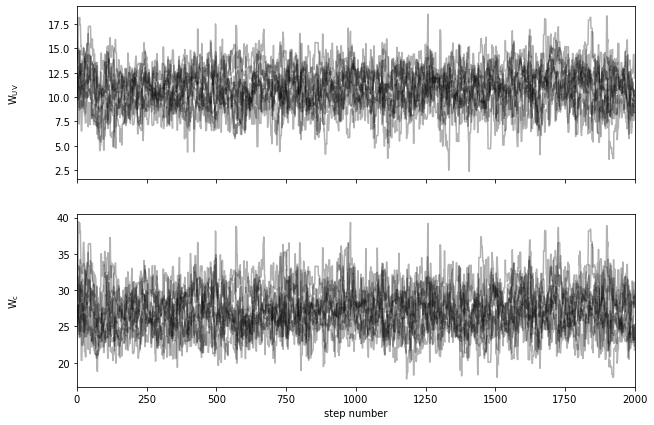

(20000, 2)


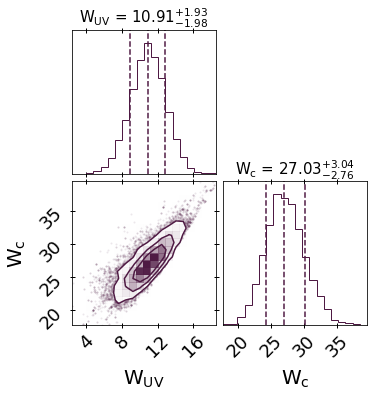

<IPython.core.display.Math object>

<IPython.core.display.Math object>

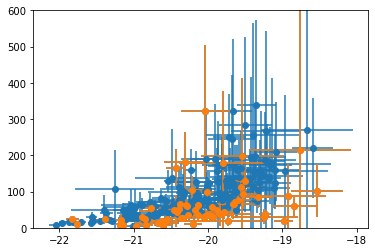

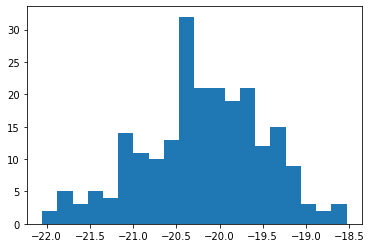

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  2%|▏         | 47/3000 [00:04<05:12,  9.45it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  3%|▎         | 88/3000 [00:10<06:32,  7.41it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 16%|█▋        | 488/3000 [01:07<05:35,  7.48it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

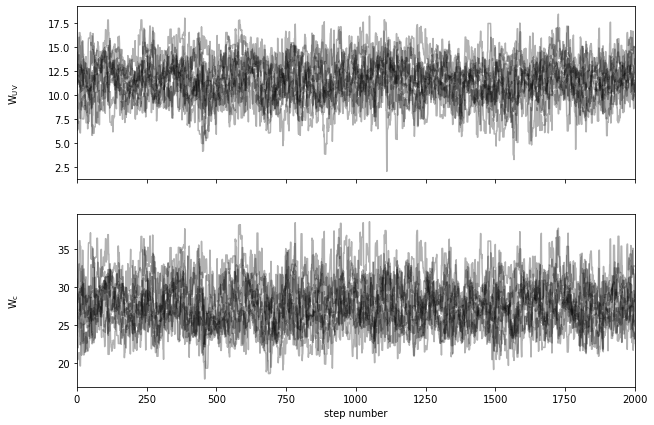

(20000, 2)


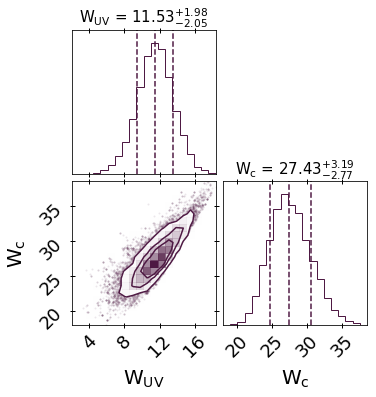

<IPython.core.display.Math object>

<IPython.core.display.Math object>

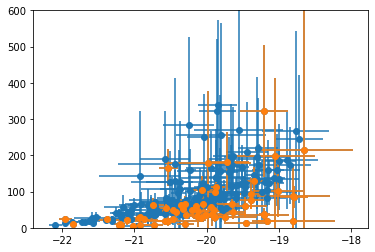

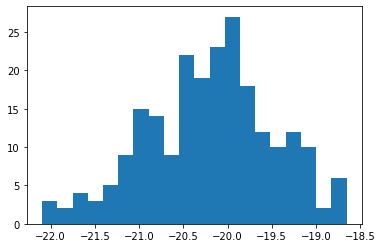

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 36/3000 [00:03<05:03,  9.75it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  4%|▎         | 112/3000 [00:13<06:42,  7.18it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 12%|█▏        | 360/3000 [00:50<06:43,  6.54it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dE

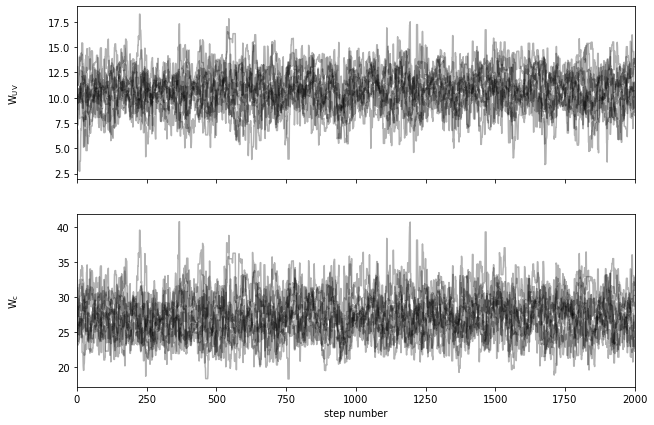

(20000, 2)


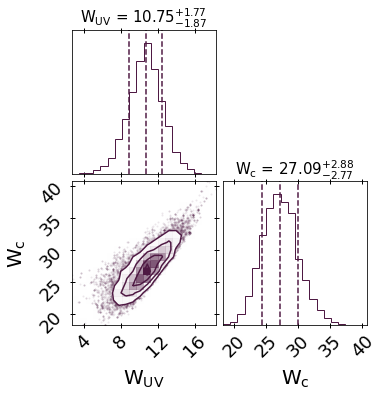

<IPython.core.display.Math object>

<IPython.core.display.Math object>

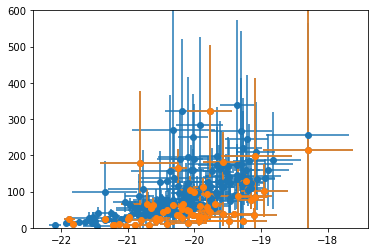

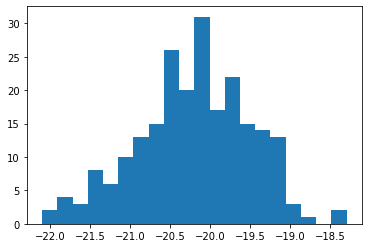

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 35/3000 [00:03<04:55, 10.03it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 334/3000 [00:43<06:29,  6.85it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

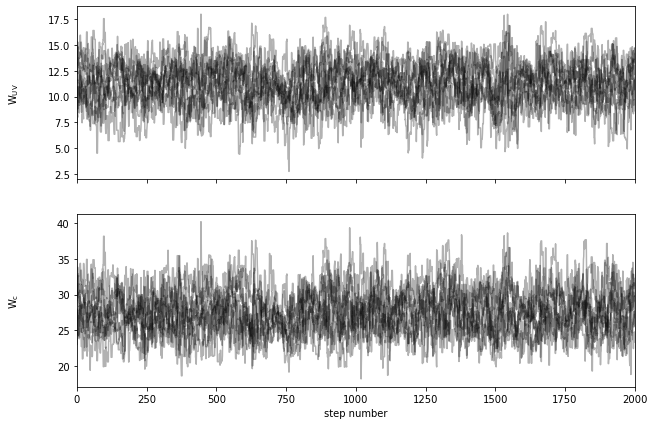

(20000, 2)


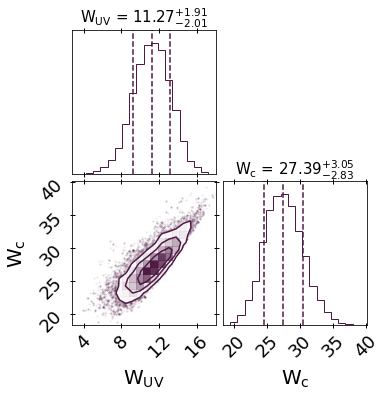

<IPython.core.display.Math object>

<IPython.core.display.Math object>

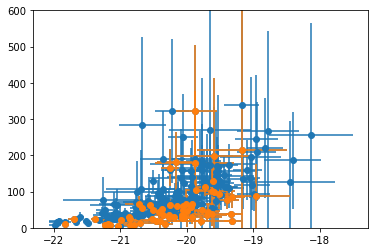

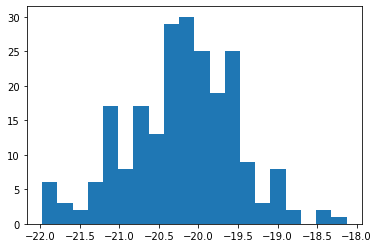

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  5%|▌         | 160/3000 [00:20<06:53,  6.87it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 34%|███▎      | 1010/3000 [02:25<04:37,  7.18it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100

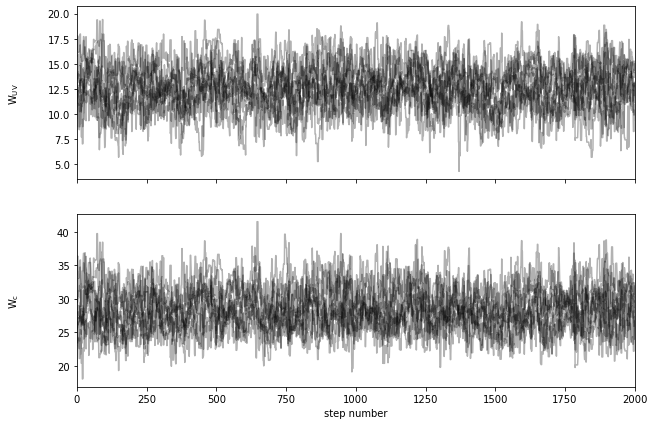

(20000, 2)


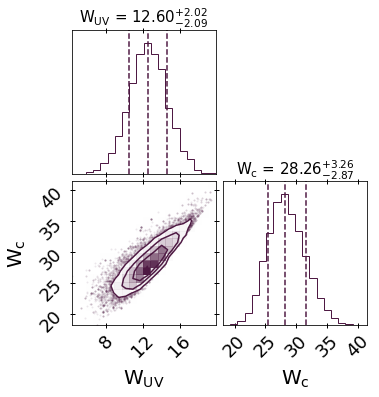

<IPython.core.display.Math object>

<IPython.core.display.Math object>

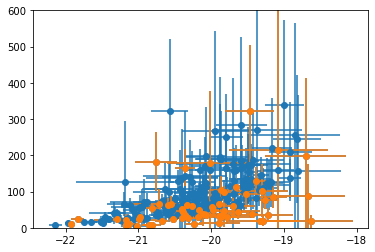

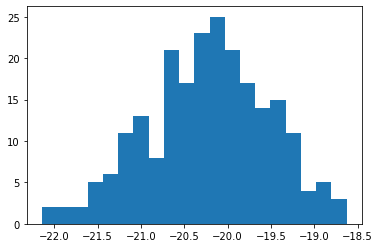

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 13%|█▎        | 385/3000 [00:43<06:52,  6.33it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:03<00:00,  7.08it/s]


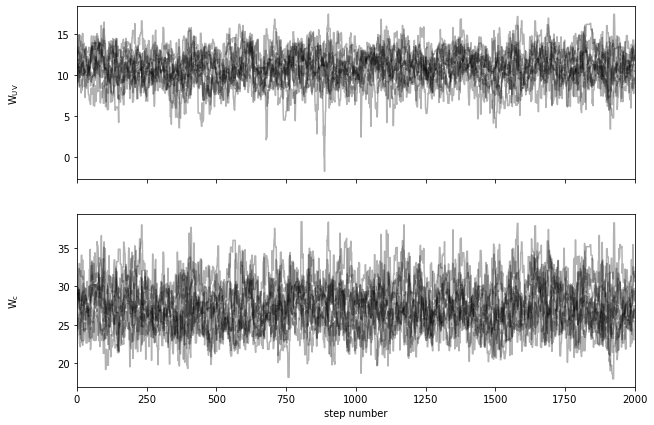

(20000, 2)


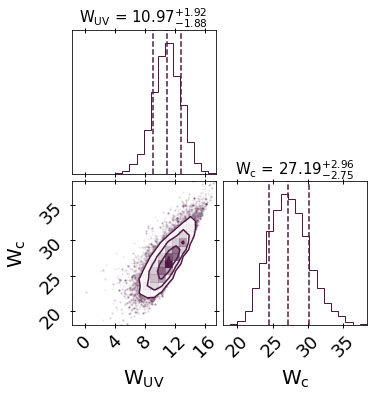

<IPython.core.display.Math object>

<IPython.core.display.Math object>

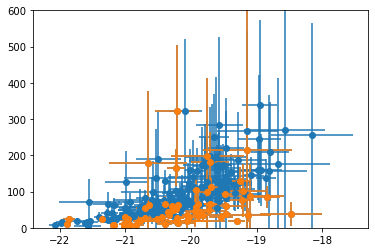

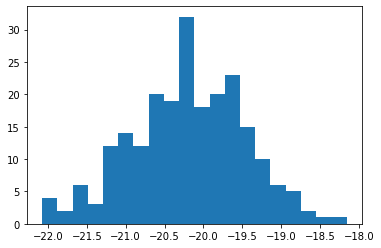

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 10%|▉         | 286/3000 [00:39<05:43,  7.89it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:19<00:00,  6.83it/s]


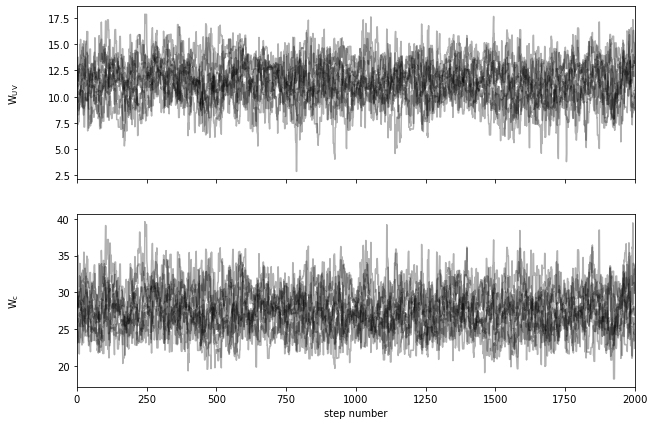

(20000, 2)


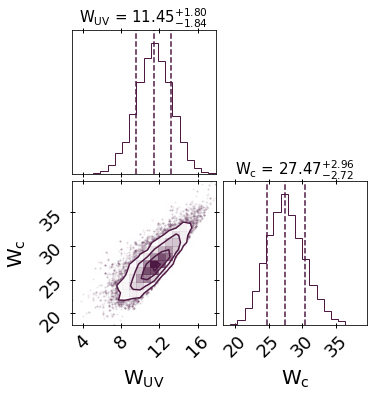

<IPython.core.display.Math object>

<IPython.core.display.Math object>

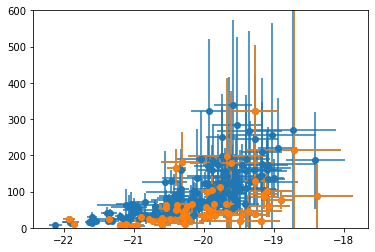

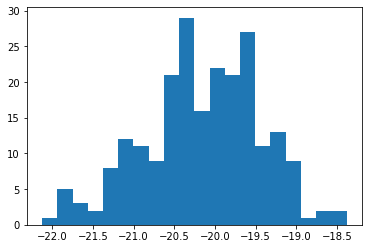

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 10/3000 [00:00<03:36, 13.81it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  3%|▎         | 83/3000 [00:09<06:04,  8.01it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 15%|█▍        | 446/3000 [00:58<05:56,  7.17it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

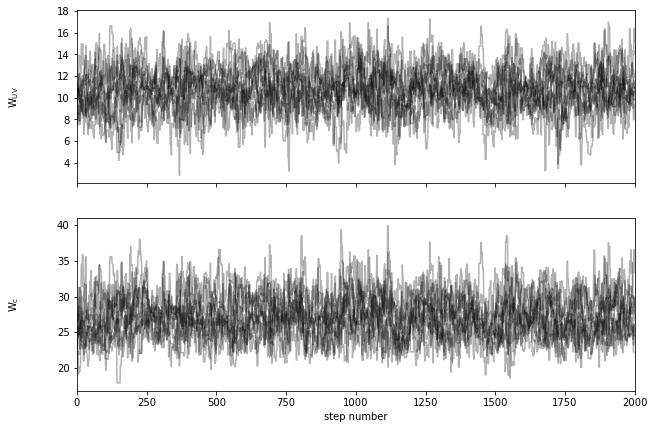

(20000, 2)


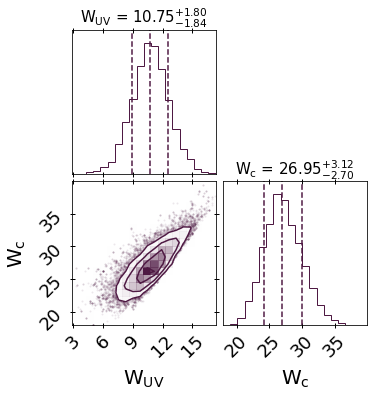

<IPython.core.display.Math object>

<IPython.core.display.Math object>

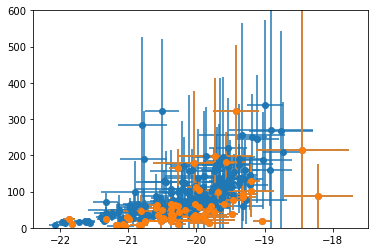

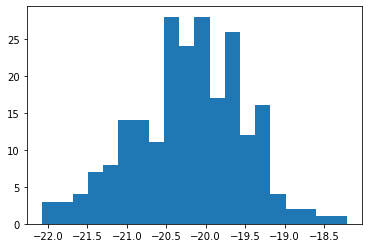

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 39%|███▉      | 1171/3000 [02:29<05:19,  5.73it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [06:58<00:00,  7.17it/s]


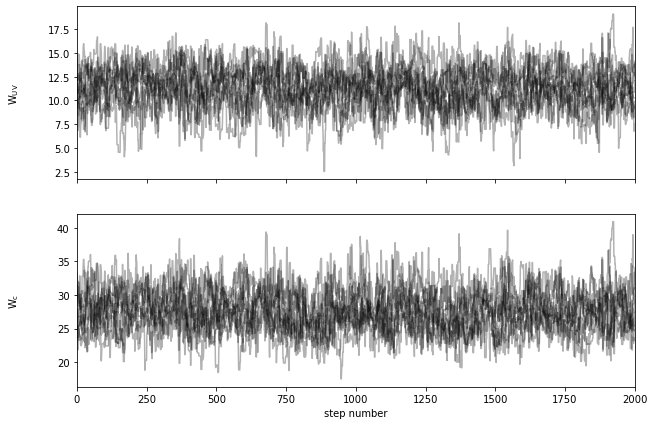

(20000, 2)


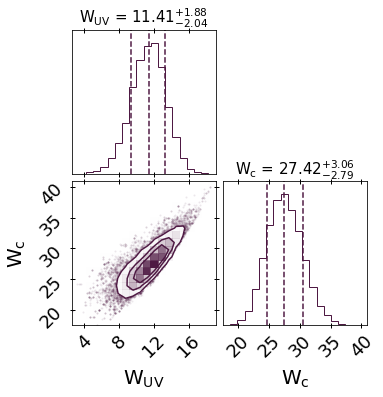

<IPython.core.display.Math object>

<IPython.core.display.Math object>

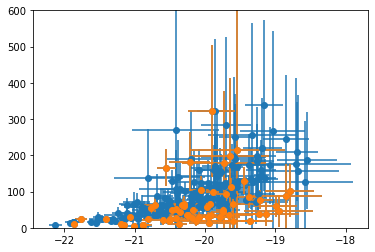

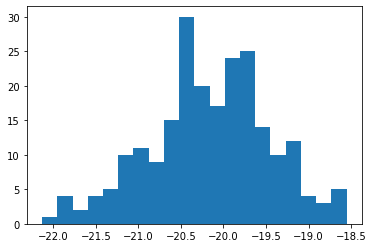

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 8/3000 [00:00<03:40, 13.58it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 46%|████▌     | 1369/3000 [02:46<03:36,  7.52it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

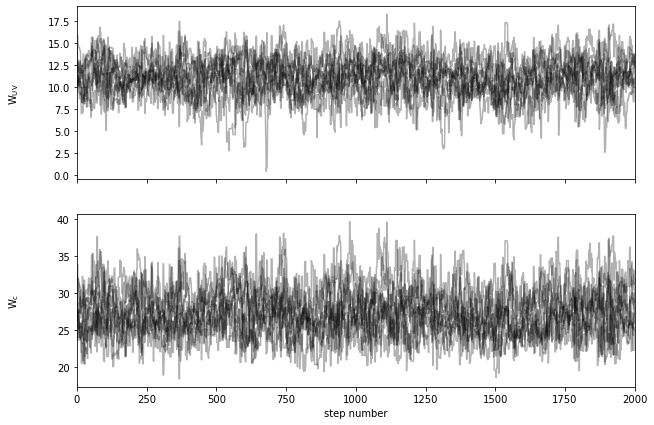

(20000, 2)


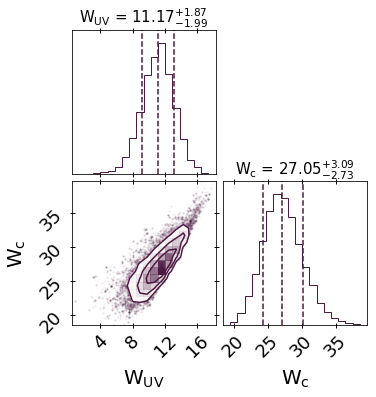

<IPython.core.display.Math object>

<IPython.core.display.Math object>

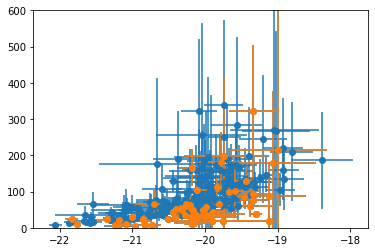

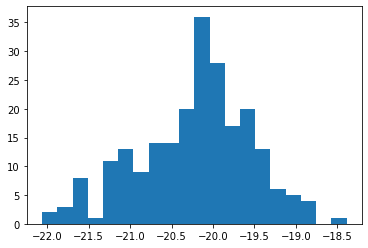

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 3/3000 [00:00<05:07,  9.73it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 8/3000 [00:00<05:13,  9.55it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 23%|██▎       | 696/3000 [01:37<05:19,  7.20it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2

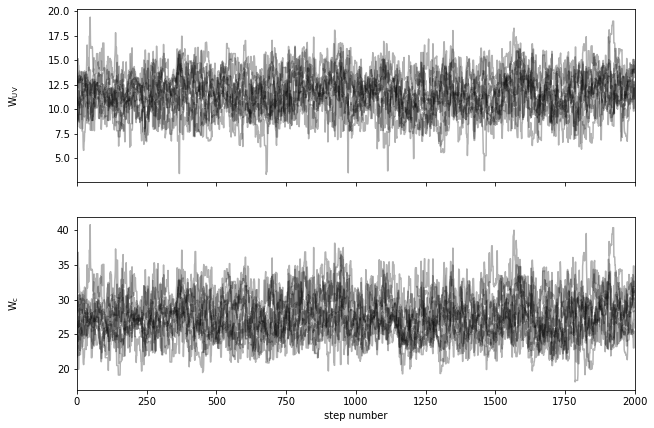

(20000, 2)


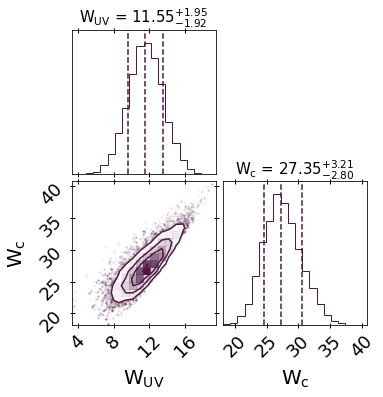

<IPython.core.display.Math object>

<IPython.core.display.Math object>

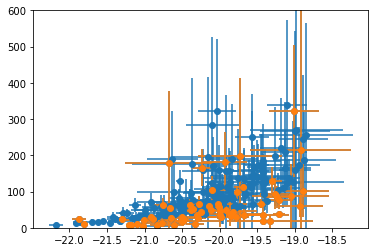

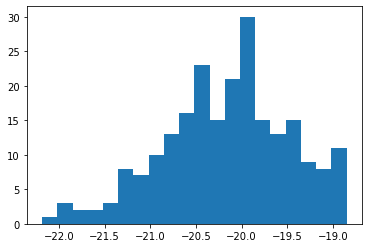

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 10/3000 [00:00<03:15, 15.29it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [06:45<00:00,  7.40it/s]


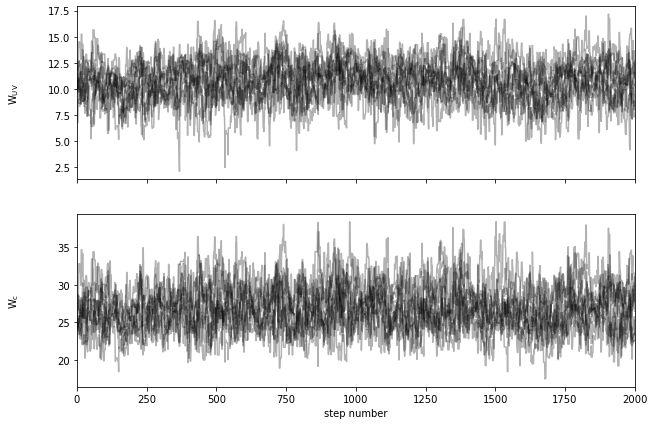

(20000, 2)


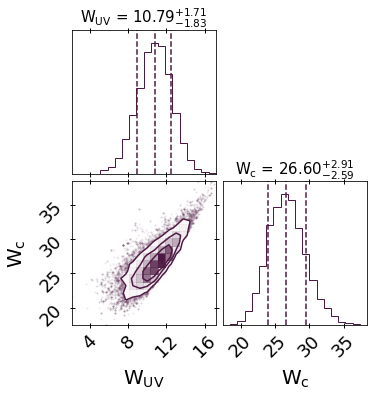

<IPython.core.display.Math object>

<IPython.core.display.Math object>

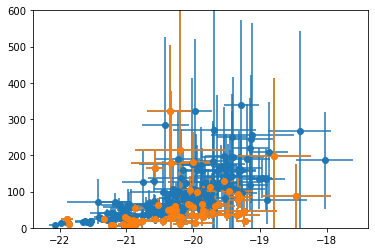

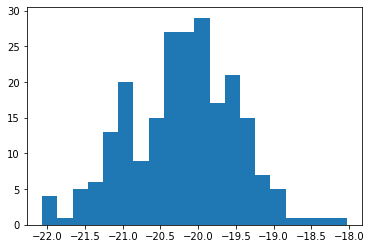

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 32/3000 [00:02<04:57,  9.97it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  4%|▍         | 127/3000 [00:15<05:46,  8.30it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  9%|▉         | 280/3000 [00:36<06:37,  6.85it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dE

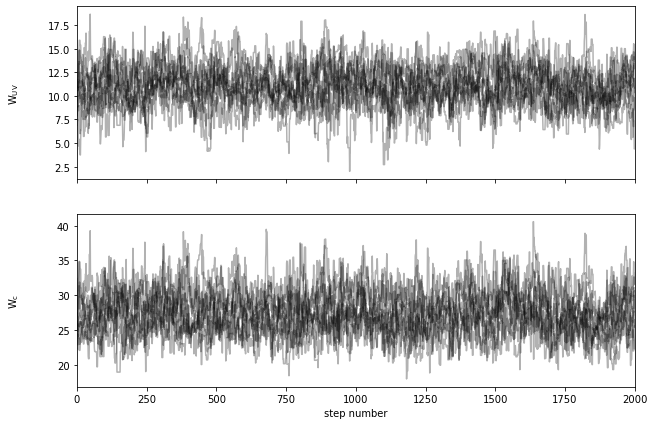

(20000, 2)


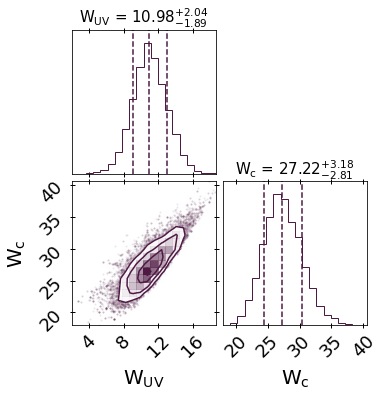

<IPython.core.display.Math object>

<IPython.core.display.Math object>

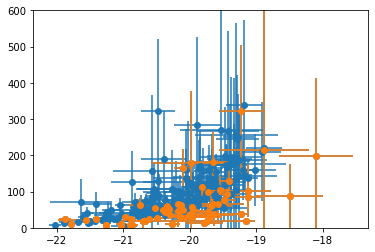

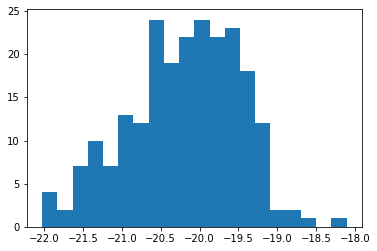

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 4/3000 [00:00<03:26, 14.52it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  1%|          | 24/3000 [00:02<04:57,  9.99it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  8%|▊         | 227/3000 [00:31<08:51,  5.21it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_

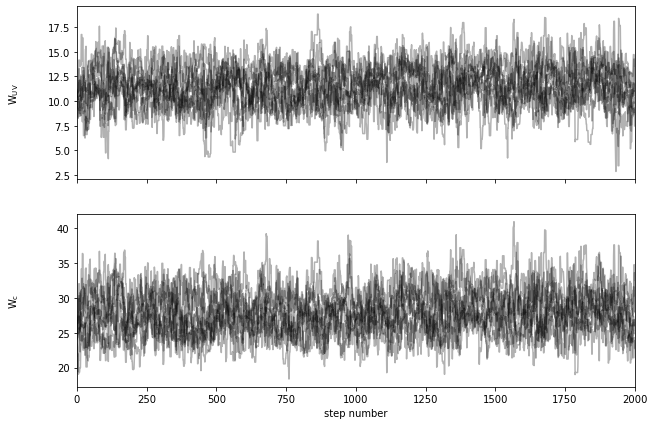

(20000, 2)


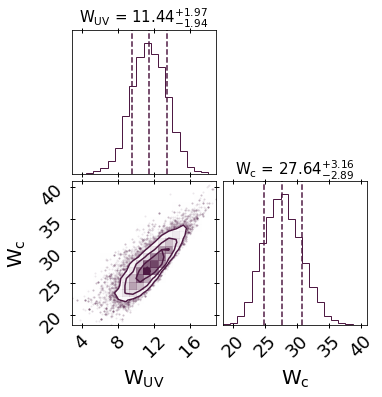

<IPython.core.display.Math object>

<IPython.core.display.Math object>

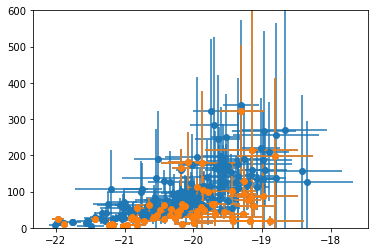

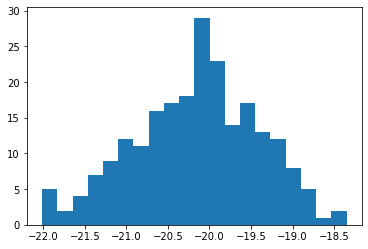

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  4%|▍         | 129/3000 [00:17<06:42,  7.14it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▌         | 154/3000 [00:21<07:00,  6.77it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%

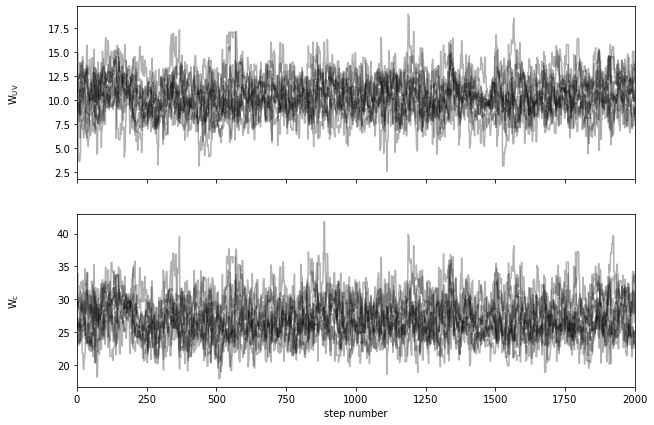

(20000, 2)


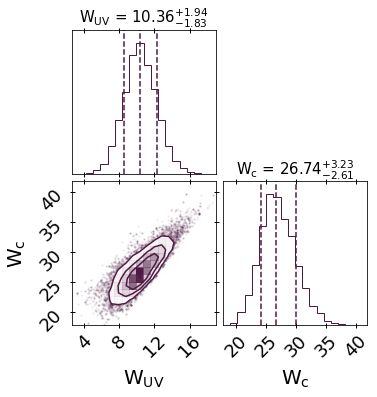

<IPython.core.display.Math object>

<IPython.core.display.Math object>

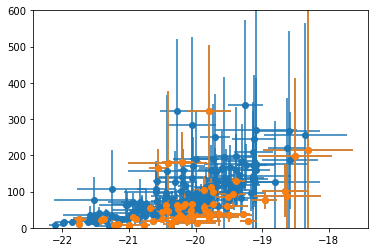

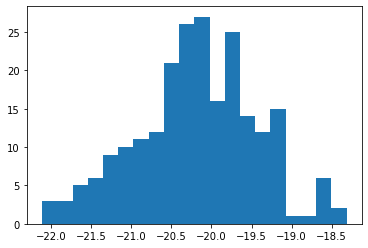

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
 24%|██▎       | 711/3000 [01:21<05:03,  7.53it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [06:45<00:00,  7.40it/s]


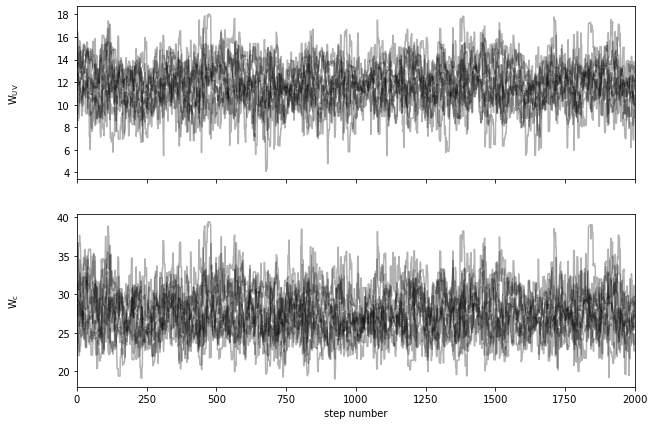

(20000, 2)


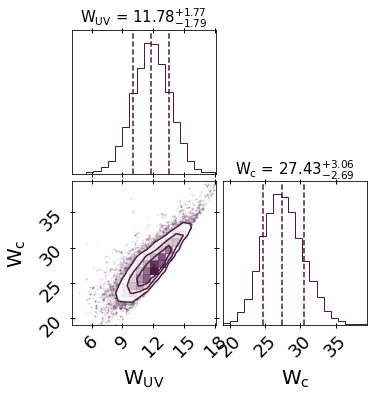

<IPython.core.display.Math object>

<IPython.core.display.Math object>

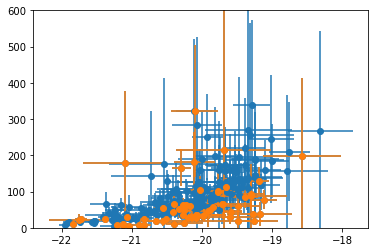

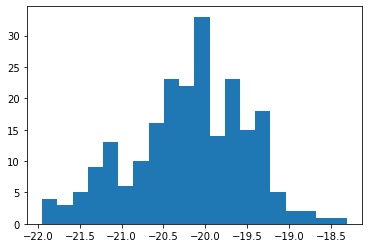

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 30/3000 [00:02<04:57,  9.98it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 140/3000 [00:18<07:04,  6.74it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

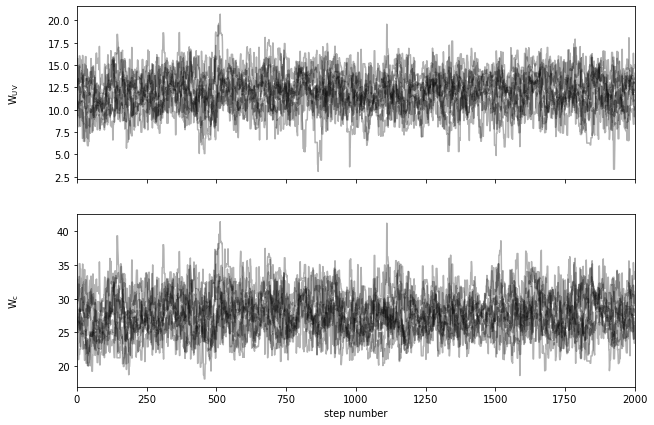

(20000, 2)


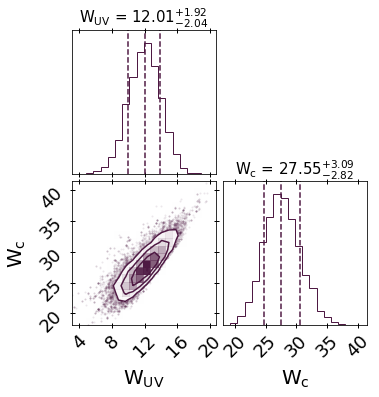

<IPython.core.display.Math object>

<IPython.core.display.Math object>

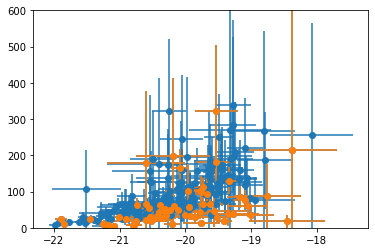

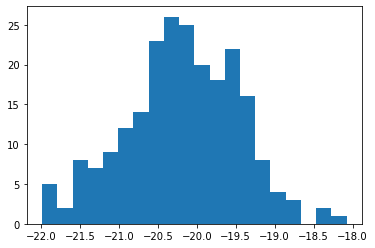

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  4%|▎         | 107/3000 [00:14<06:51,  7.03it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 16%|█▌        | 482/3000 [01:11<06:51,  6.12it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%

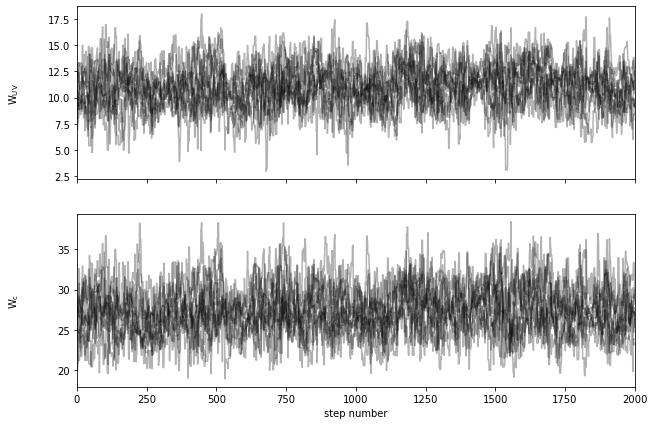

(20000, 2)


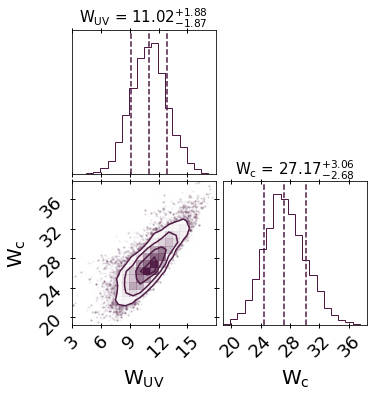

<IPython.core.display.Math object>

<IPython.core.display.Math object>

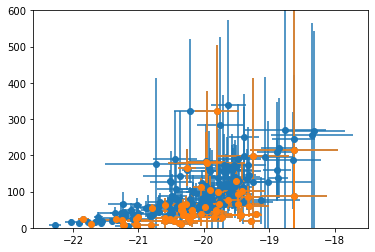

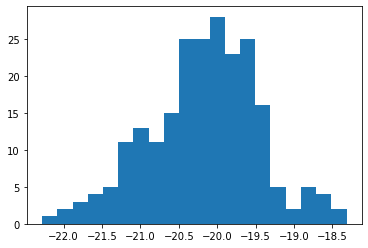

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 7/3000 [00:00<02:39, 18.72it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 11/3000 [00:00<02:58, 16.78it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 34%|███▎      | 1008/3000 [01:52<04:46,  6.95it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

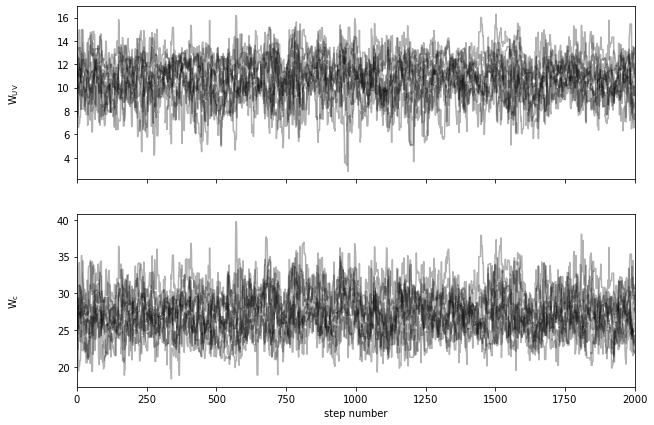

(20000, 2)


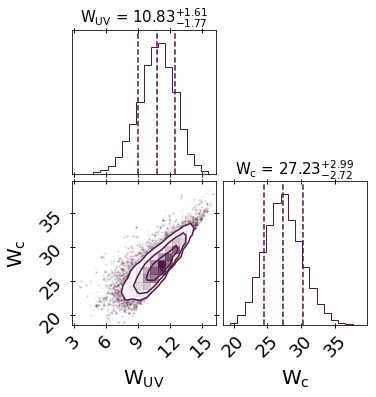

<IPython.core.display.Math object>

<IPython.core.display.Math object>

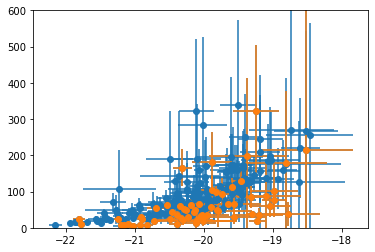

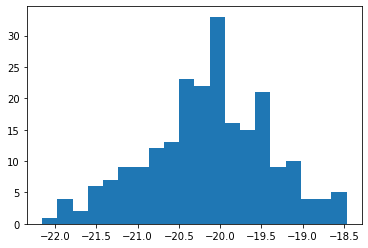

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 2/3000 [00:00<02:55, 17.12it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 12%|█▏        | 368/3000 [00:31<04:05, 10.72it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|█

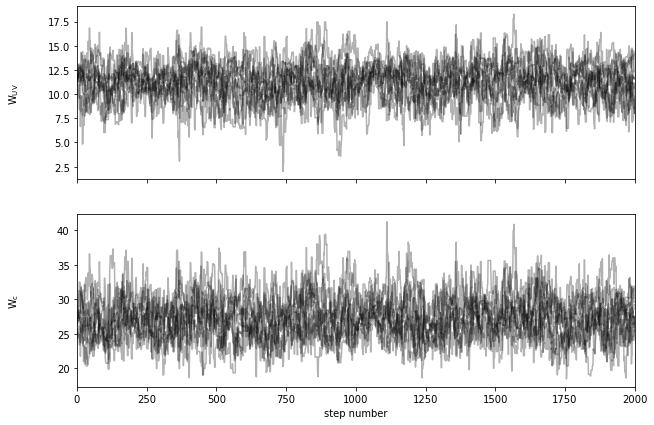

(20000, 2)


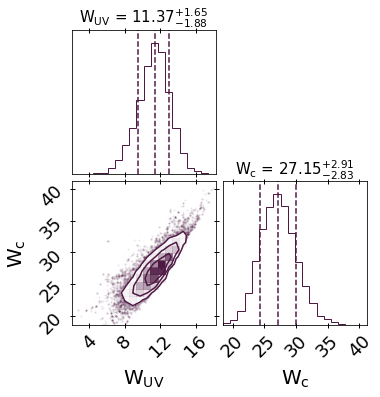

<IPython.core.display.Math object>

<IPython.core.display.Math object>

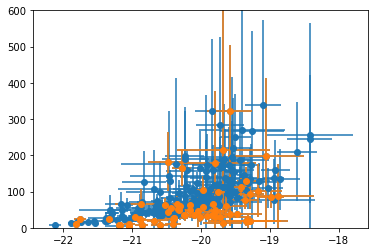

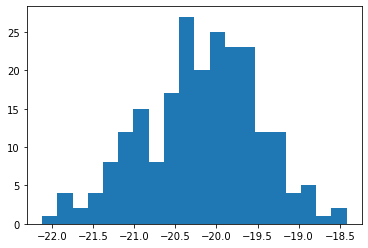

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  3%|▎         | 83/3000 [00:08<05:05,  9.55it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 29%|██▉       | 867/3000 [01:41<05:16,  6.74it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

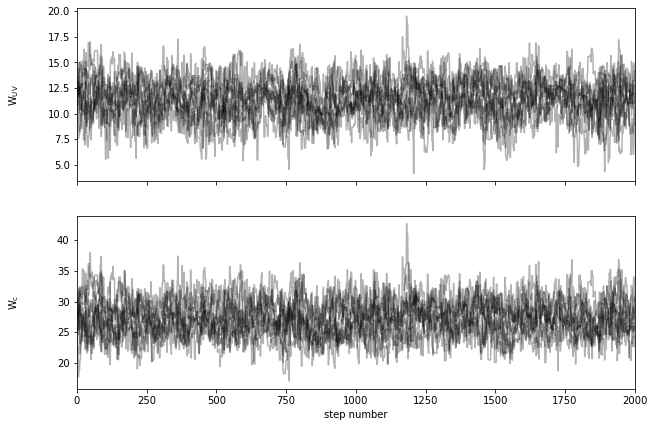

(20000, 2)


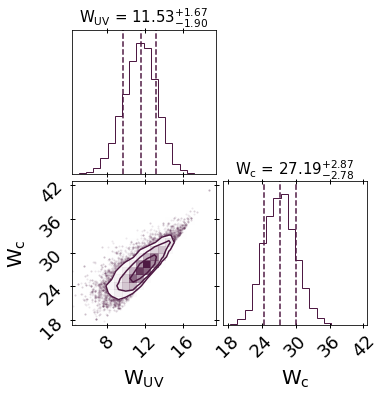

<IPython.core.display.Math object>

<IPython.core.display.Math object>

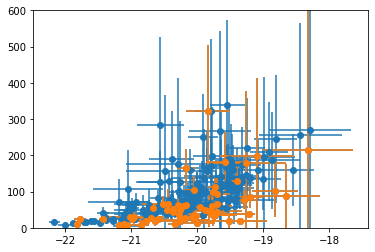

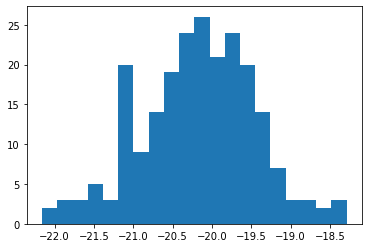

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 1/3000 [00:00<07:19,  6.82it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  1%|▏         | 40/3000 [00:03<03:59, 12.34it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 52%|█████▏    | 1566/3000 [03:02<03:08,  7.61it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

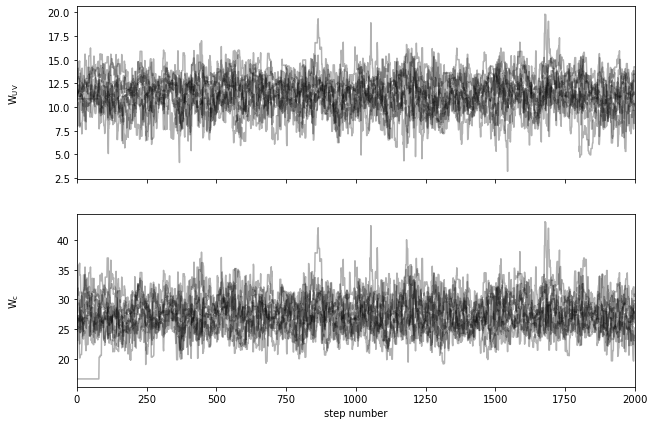

(20000, 2)


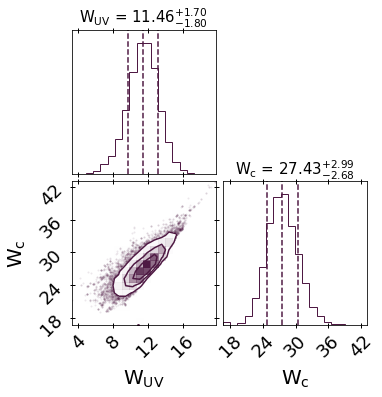

<IPython.core.display.Math object>

<IPython.core.display.Math object>

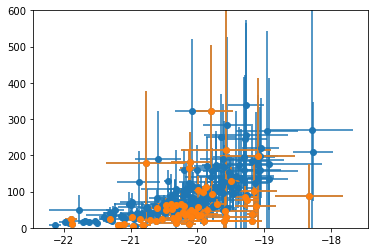

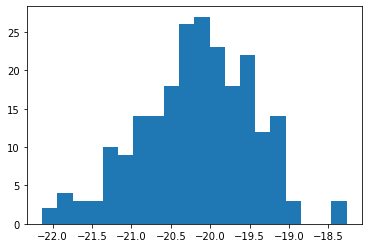

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 8/3000 [00:00<03:40, 13.57it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 336/3000 [00:40<06:09,  7.20it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|█

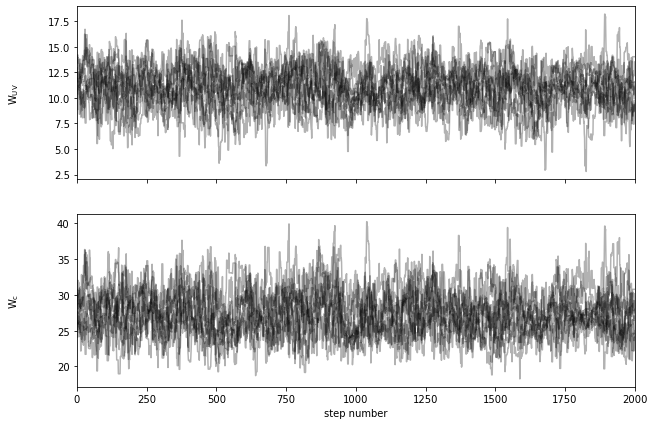

(20000, 2)


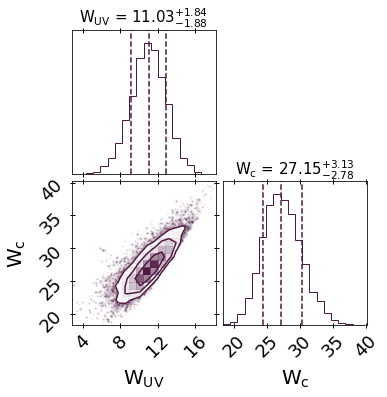

<IPython.core.display.Math object>

<IPython.core.display.Math object>

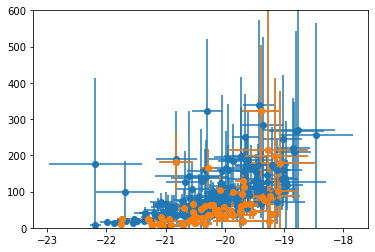

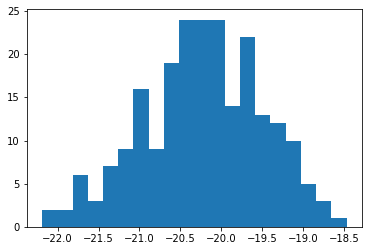

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 10/3000 [00:00<03:06, 16.02it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 52%|█████▏    | 1565/3000 [02:06<01:53, 12.67it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%

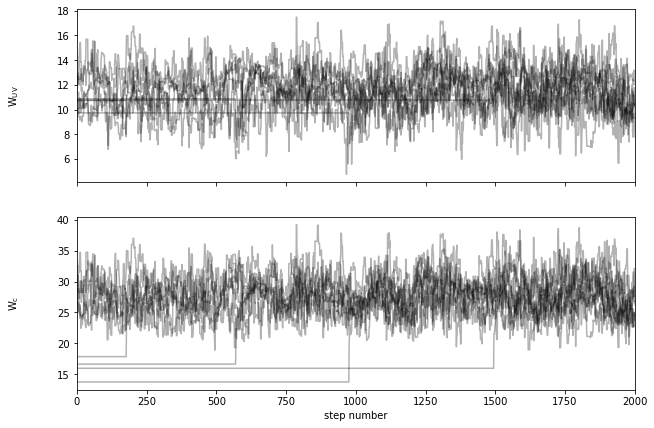

(20000, 2)


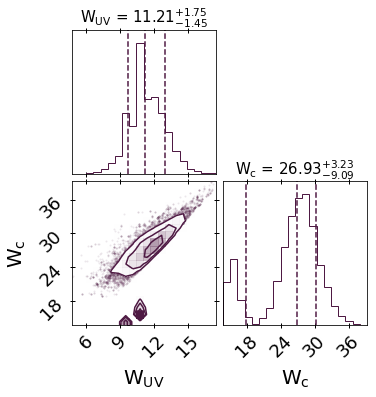

<IPython.core.display.Math object>

<IPython.core.display.Math object>

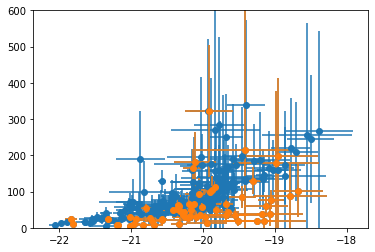

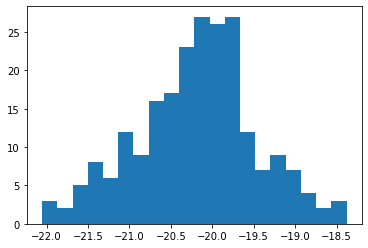

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|▏         | 42/3000 [00:03<04:34, 10.76it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 23%|██▎       | 687/3000 [01:33<07:03,  5.46it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

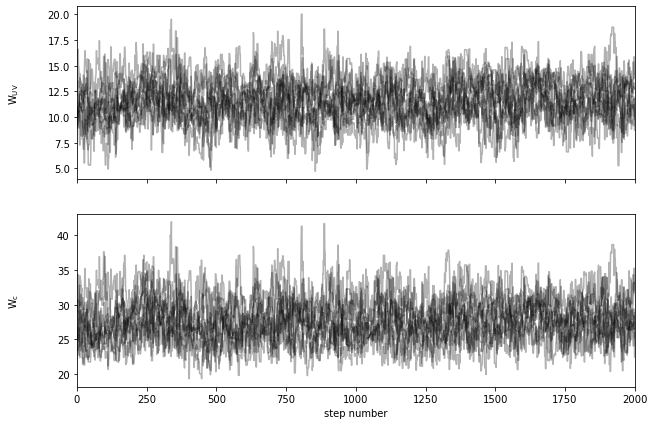

(20000, 2)


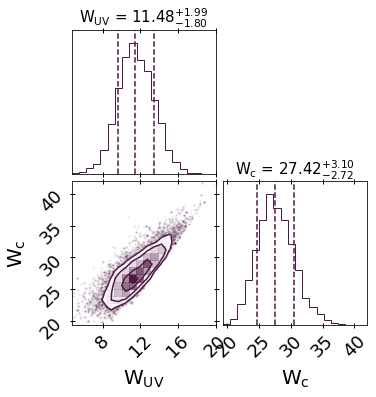

<IPython.core.display.Math object>

<IPython.core.display.Math object>

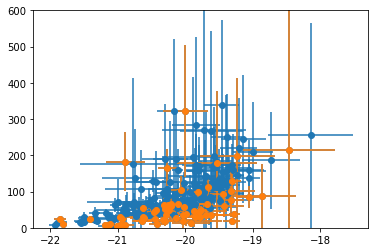

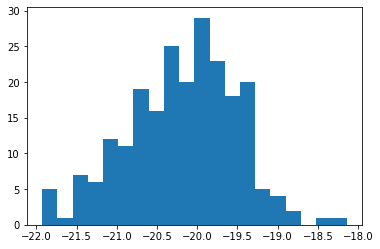

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 26/3000 [00:02<06:19,  7.84it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 63/3000 [00:08<07:02,  6.95it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 147/3000 [00:20<07:07,  6.67it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

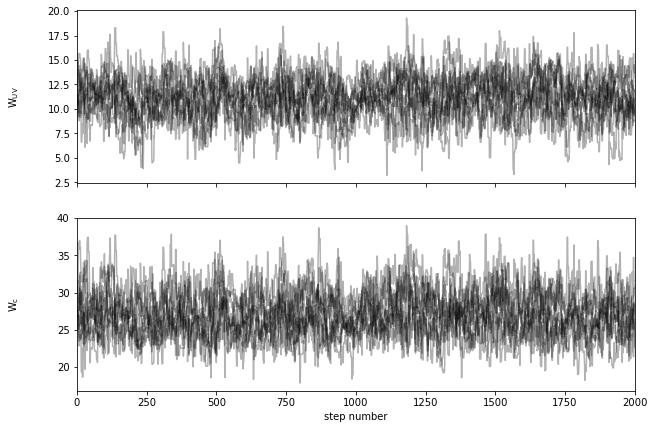

(20000, 2)


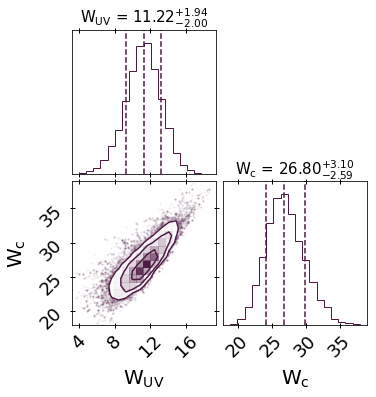

<IPython.core.display.Math object>

<IPython.core.display.Math object>

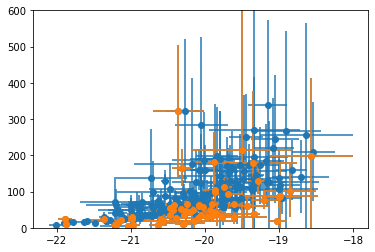

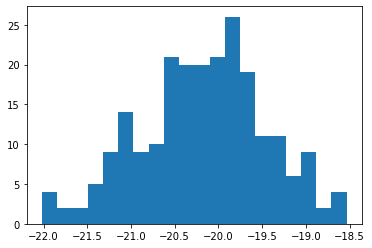

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 3/3000 [00:00<05:07,  9.76it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 140/3000 [00:18<07:21,  6.48it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|█

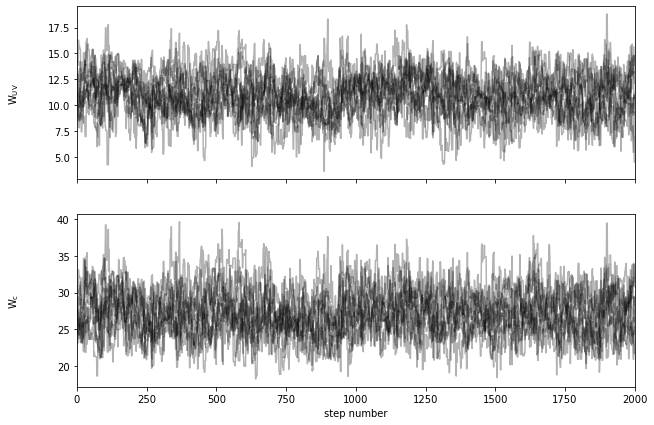

(20000, 2)


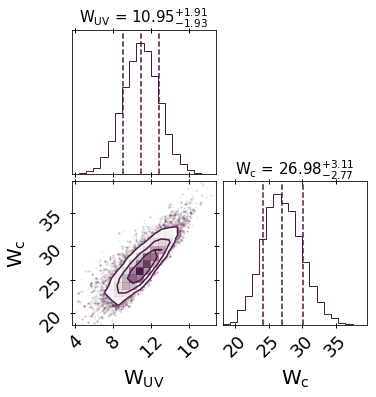

<IPython.core.display.Math object>

<IPython.core.display.Math object>

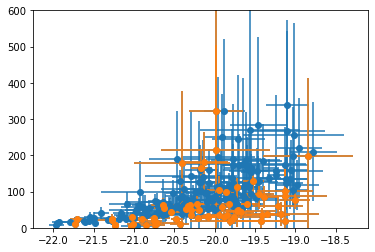

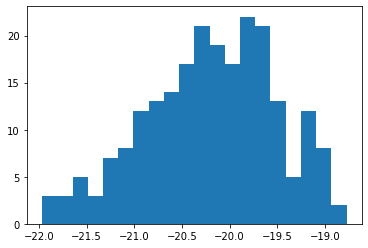

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  3%|▎         | 96/3000 [00:11<06:18,  7.67it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 141/3000 [00:17<06:31,  7.30it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  6%|▌         | 185/3000 [00:24<06:12,  7.56it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dE

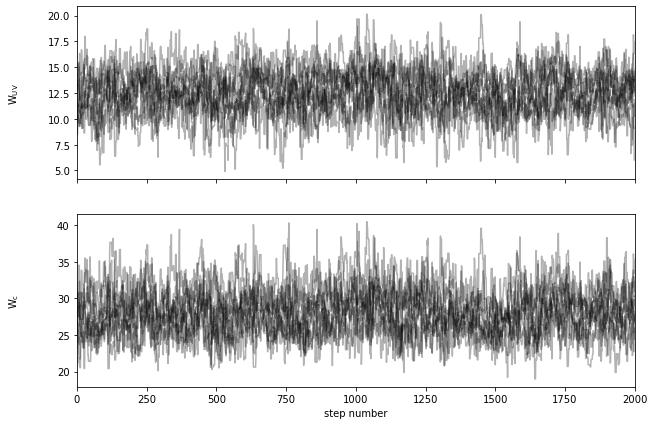

(20000, 2)


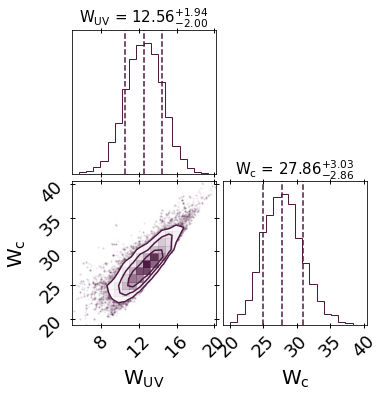

<IPython.core.display.Math object>

<IPython.core.display.Math object>

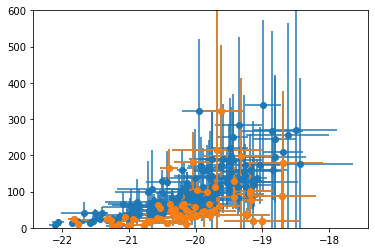

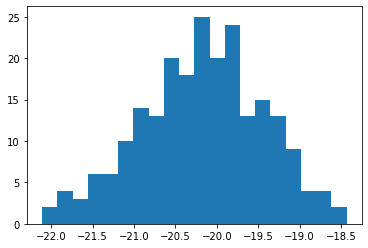

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 6/3000 [00:00<03:59, 12.50it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 335/3000 [00:37<05:03,  8.79it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|█

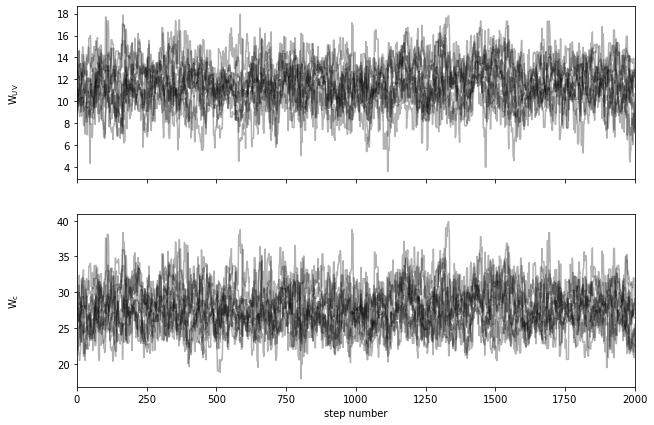

(20000, 2)


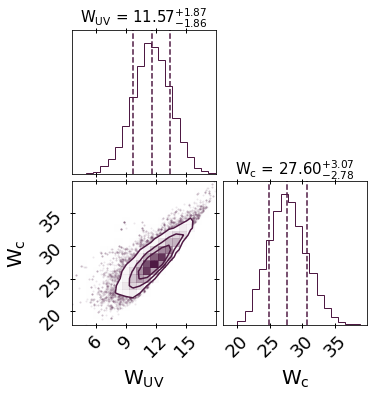

<IPython.core.display.Math object>

<IPython.core.display.Math object>

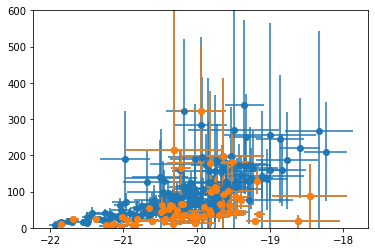

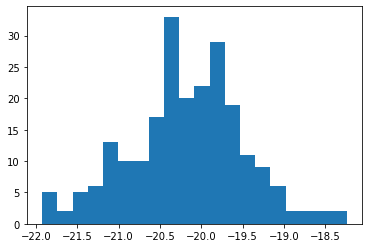

  0%|          | 0/3000 [00:00<?, ?it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|▏         | 41/3000 [00:04<07:11,  6.85it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▌         | 159/3000 [00:21<06:27,  7.33it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

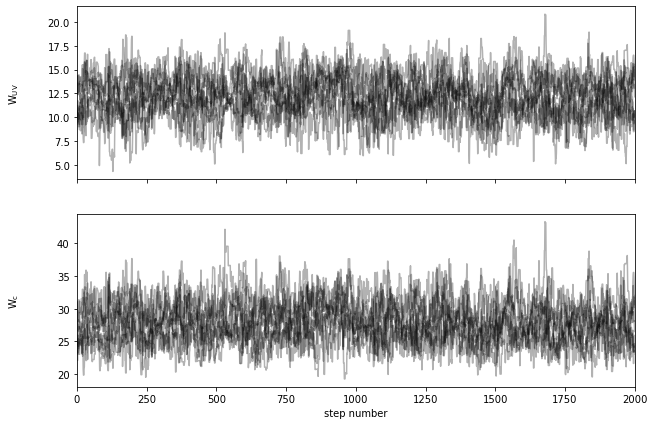

(20000, 2)


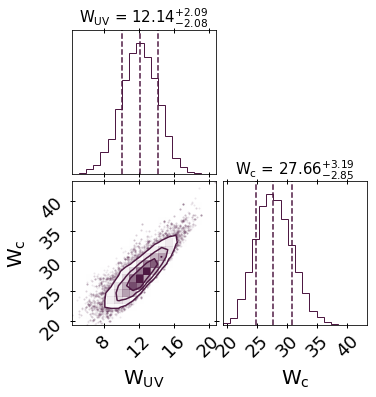

<IPython.core.display.Math object>

<IPython.core.display.Math object>

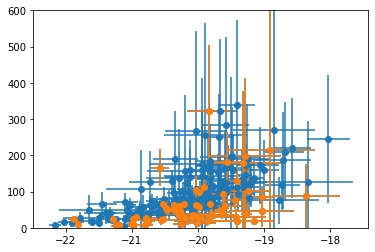

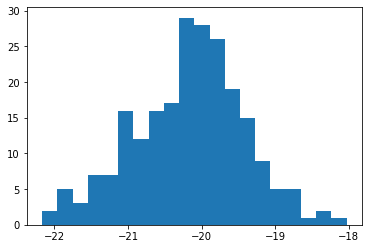

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 11/3000 [00:00<03:46, 13.19it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 322/3000 [00:35<05:17,  8.44it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

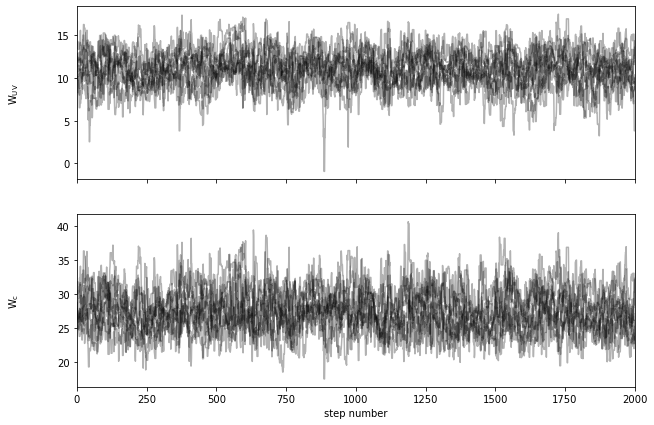

(20000, 2)


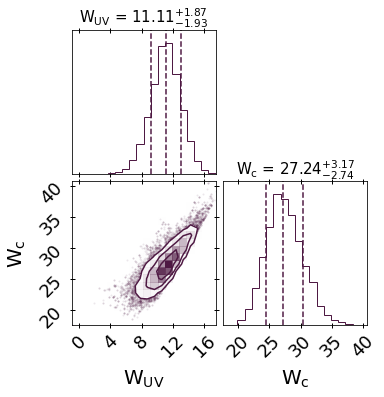

<IPython.core.display.Math object>

<IPython.core.display.Math object>

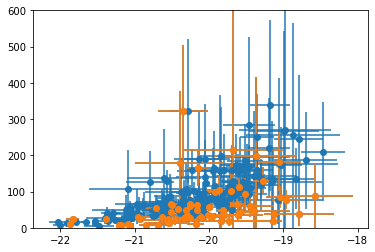

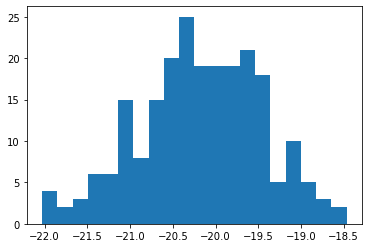

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  8%|▊         | 227/3000 [00:30<07:06,  6.50it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:17<00:00,  6.85it/s]


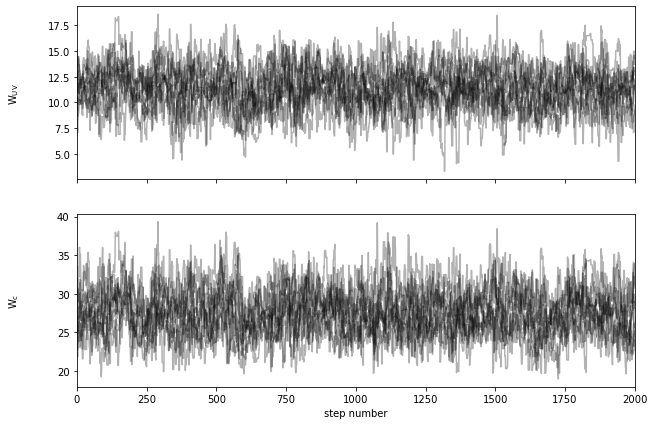

(20000, 2)


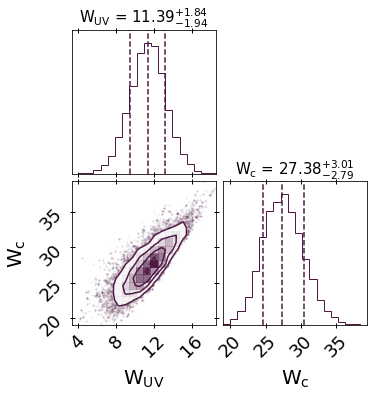

<IPython.core.display.Math object>

<IPython.core.display.Math object>

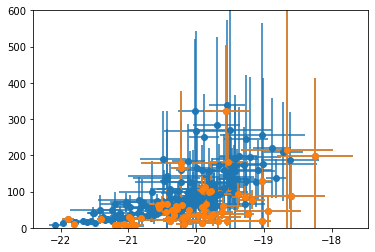

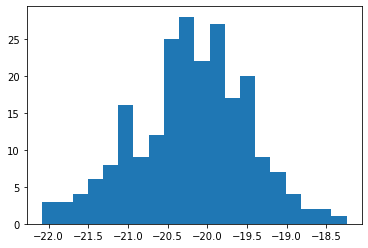

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  1%|▏         | 40/3000 [00:03<04:52, 10.11it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  7%|▋         | 206/3000 [00:25<06:38,  7.01it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

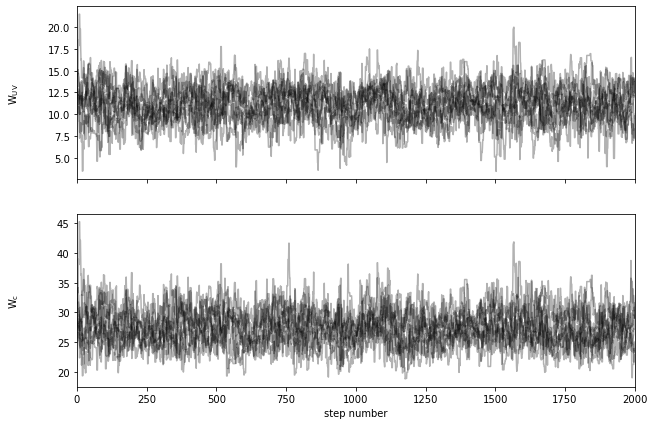

(20000, 2)


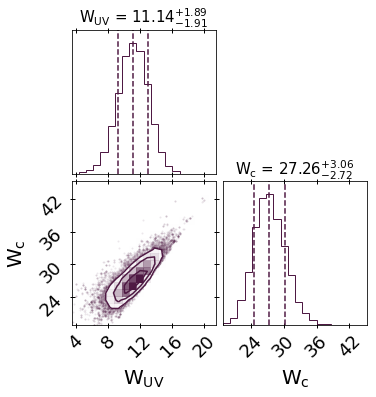

<IPython.core.display.Math object>

<IPython.core.display.Math object>

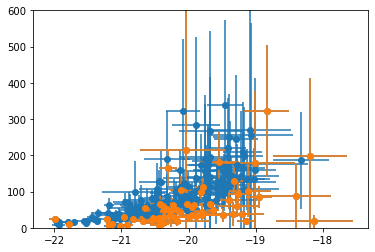

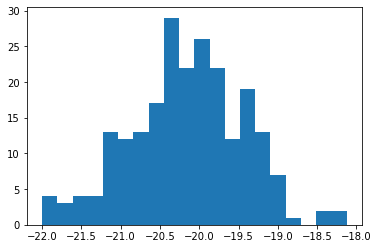

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  2%|▏         | 54/3000 [00:05<06:59,  7.03it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 336/3000 [00:45<05:37,  7.90it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 26%|██▋       | 793/3000 [01:47<05:03,  7.26it/s]<ipython-input-5-ccb42e6453df>:74: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(model))
 71%

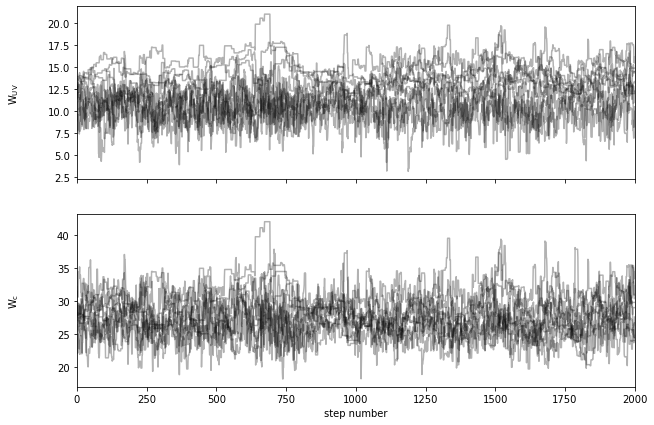

(20000, 2)


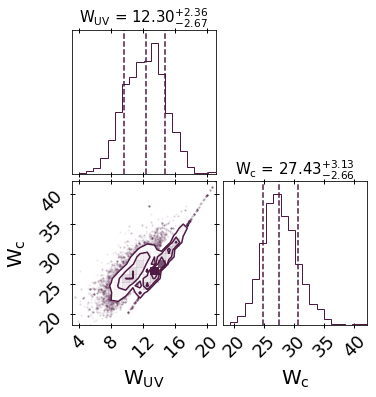

<IPython.core.display.Math object>

<IPython.core.display.Math object>

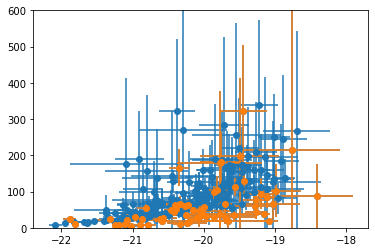

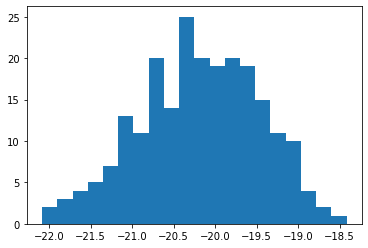

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  3%|▎         | 79/3000 [00:08<06:08,  7.93it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 140/3000 [00:17<06:20,  7.51it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

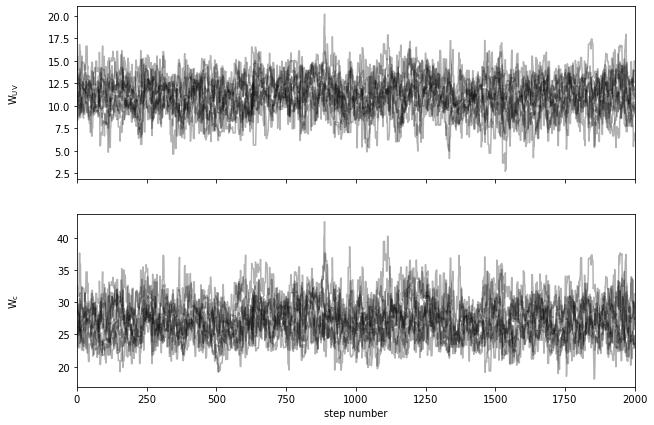

(20000, 2)


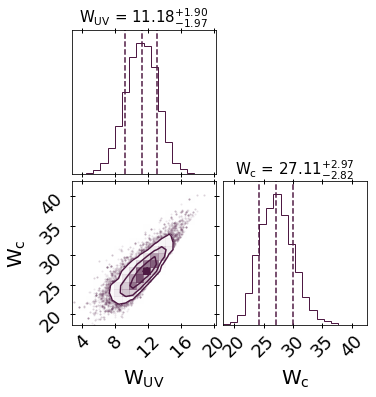

<IPython.core.display.Math object>

<IPython.core.display.Math object>

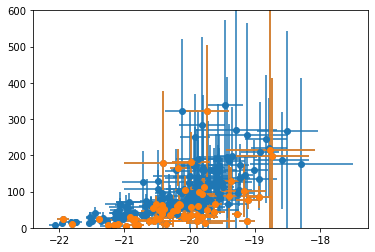

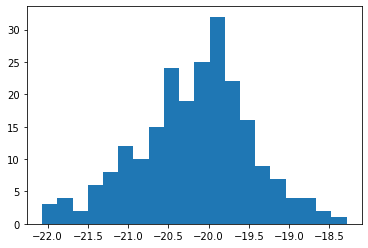

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 2/3000 [00:00<04:23, 11.37it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 46/3000 [00:04<04:57,  9.93it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  7%|▋         | 201/3000 [00:25<06:57,  6.71it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_

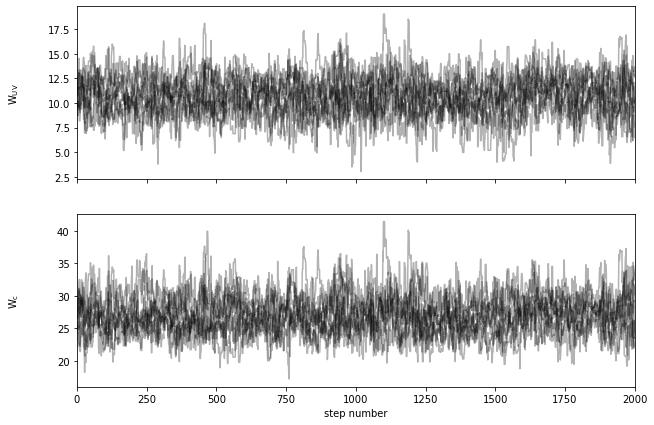

(20000, 2)


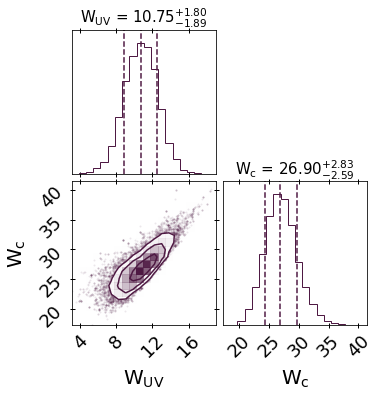

<IPython.core.display.Math object>

<IPython.core.display.Math object>

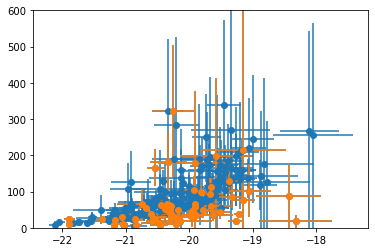

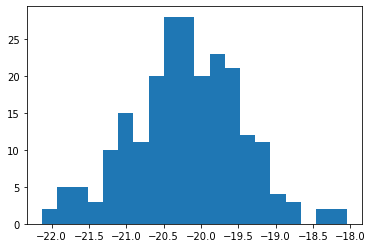

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 9/3000 [00:00<04:02, 12.32it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 72/3000 [00:06<04:38, 10.51it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 18%|█▊        | 552/3000 [01:11<05:16,  7.74it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_

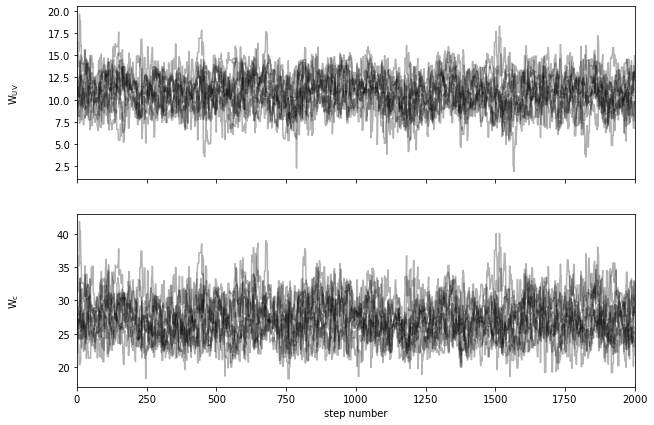

(20000, 2)


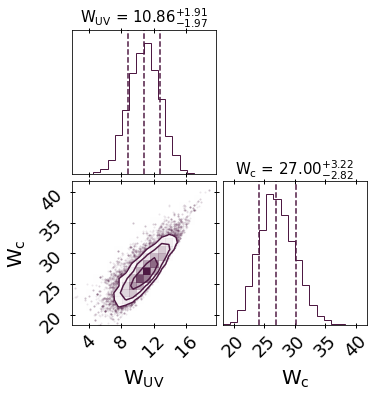

<IPython.core.display.Math object>

<IPython.core.display.Math object>

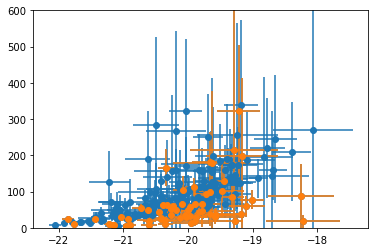

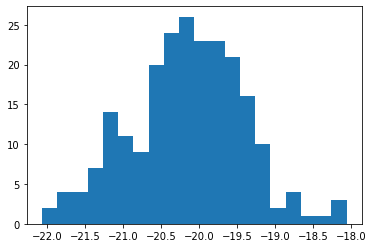

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 3/3000 [00:00<05:39,  8.83it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  3%|▎         | 87/3000 [00:08<04:39, 10.43it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 25%|██▍       | 749/3000 [01:45<07:31,  4.99it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_

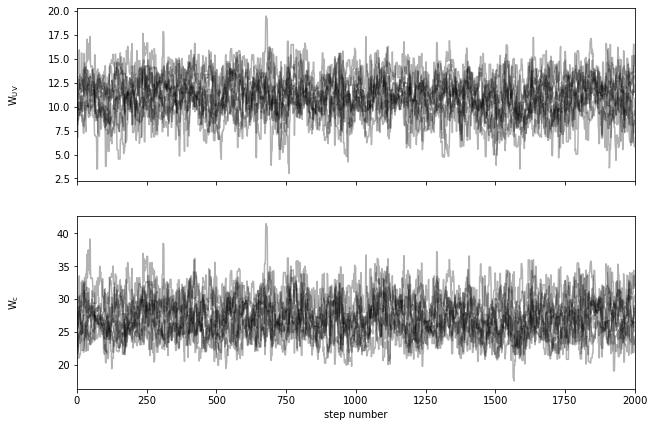

(20000, 2)


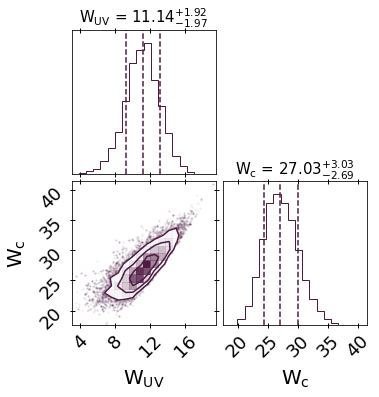

<IPython.core.display.Math object>

<IPython.core.display.Math object>

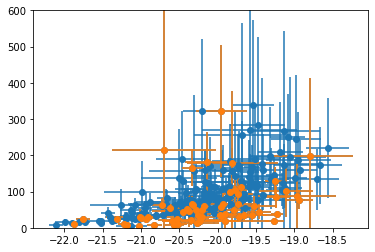

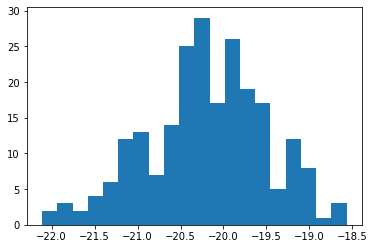

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  2%|▏         | 56/3000 [00:05<06:34,  7.46it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:12<00:00,  6.93it/s]


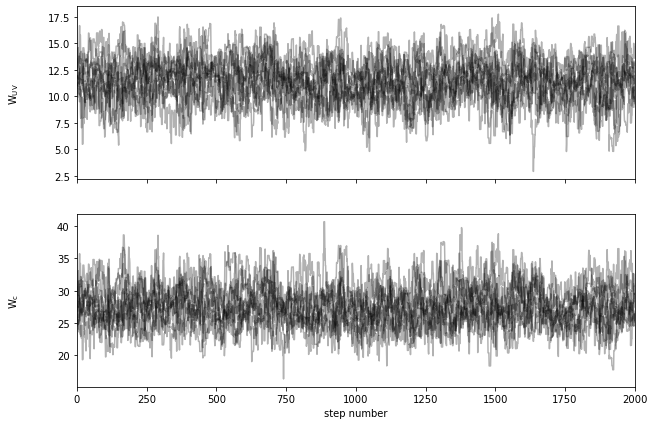

(20000, 2)


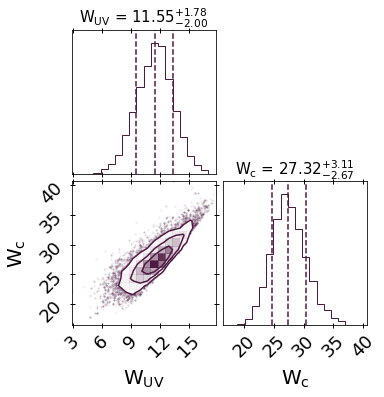

<IPython.core.display.Math object>

<IPython.core.display.Math object>

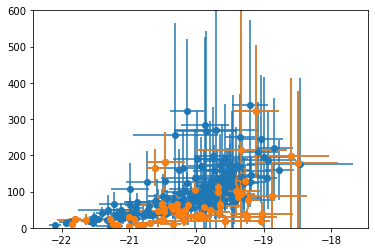

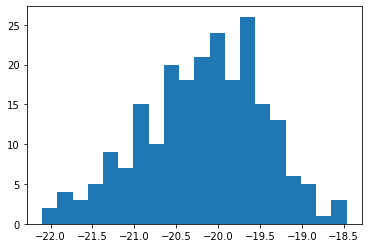

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 28/3000 [00:02<04:54, 10.10it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█▏        | 341/3000 [00:39<05:12,  8.52it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

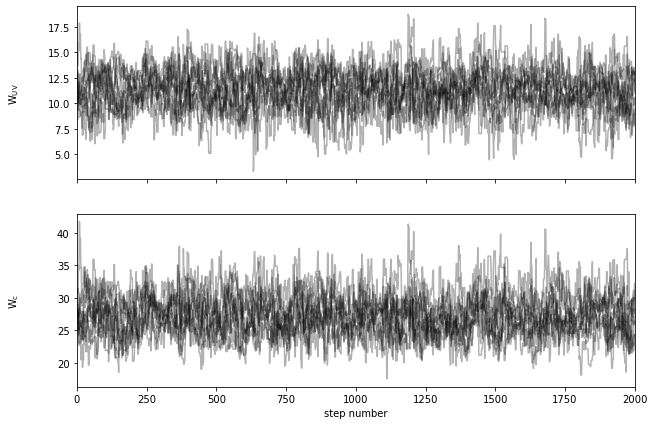

(20000, 2)


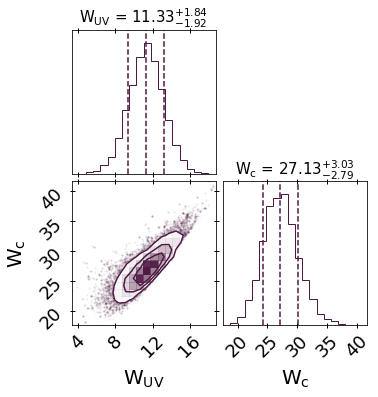

<IPython.core.display.Math object>

<IPython.core.display.Math object>

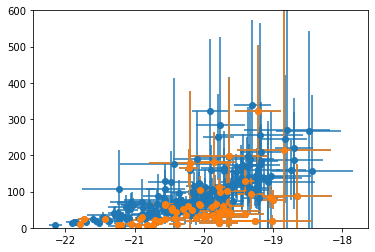

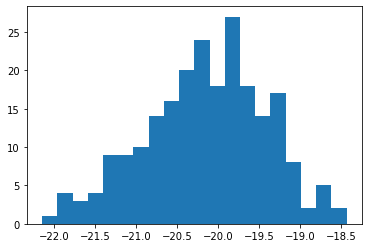

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 56/3000 [00:04<04:08, 11.83it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 24%|██▍       | 720/3000 [01:08<05:26,  6.99it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

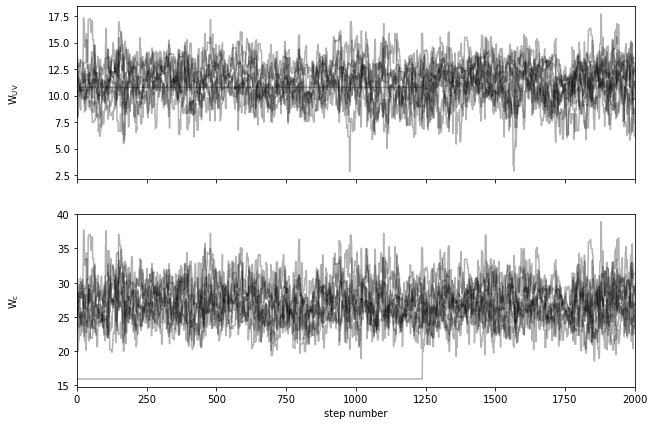

(20000, 2)


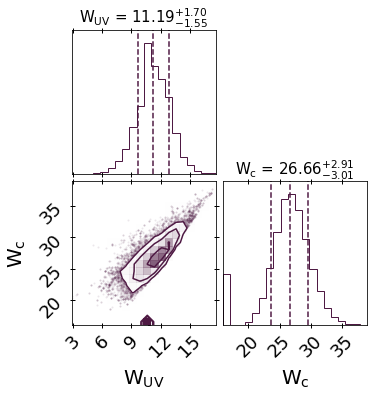

<IPython.core.display.Math object>

<IPython.core.display.Math object>

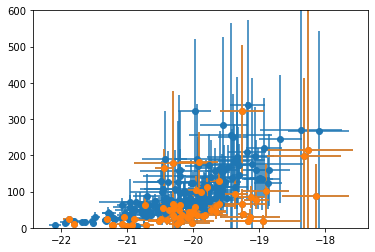

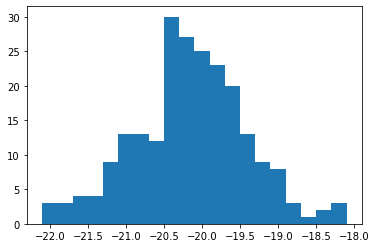

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 35/3000 [00:03<04:55, 10.03it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  3%|▎         | 104/3000 [00:11<06:22,  7.57it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  7%|▋         | 201/3000 [00:25<06:37,  7.03it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dE

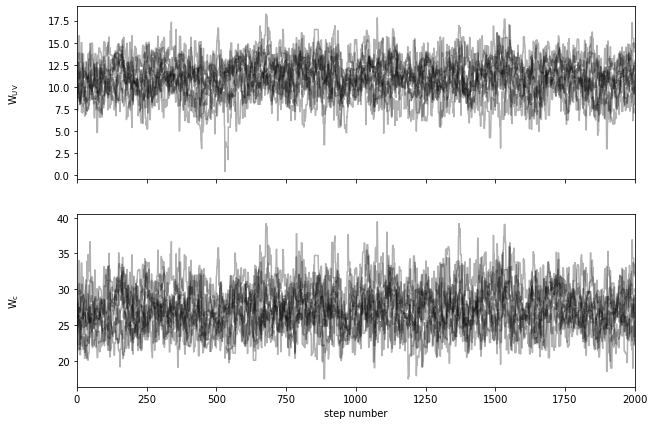

(20000, 2)


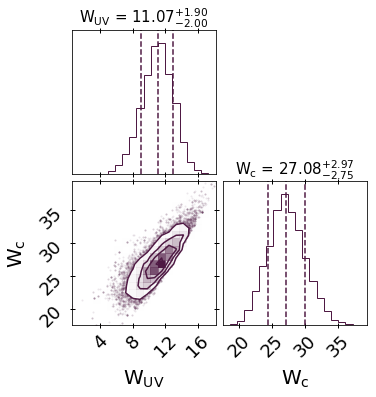

<IPython.core.display.Math object>

<IPython.core.display.Math object>

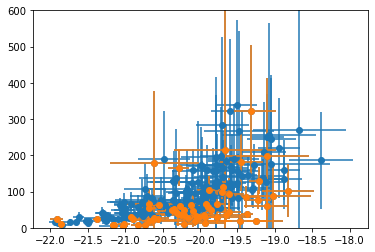

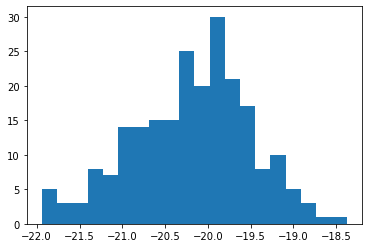

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  5%|▍         | 147/3000 [00:20<06:52,  6.92it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|██████████| 3000/3000 [07:36<00:00,  6.57it/s]


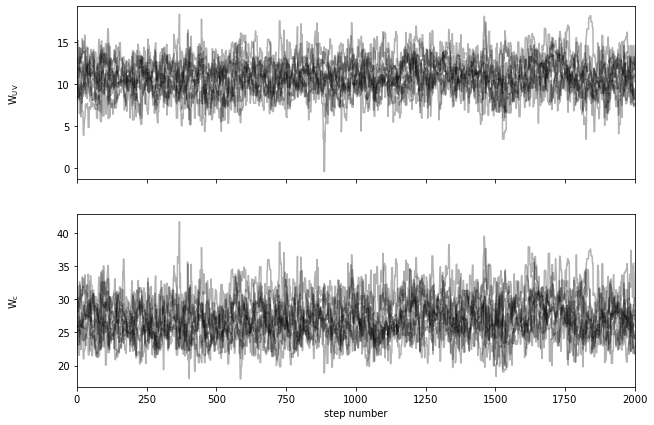

(20000, 2)


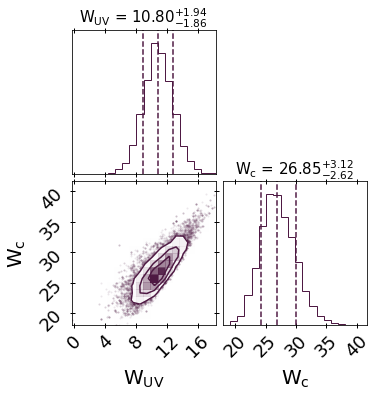

<IPython.core.display.Math object>

<IPython.core.display.Math object>

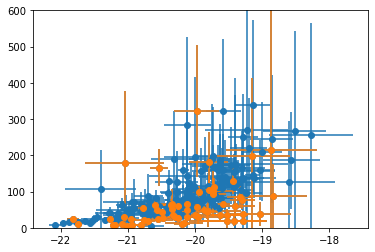

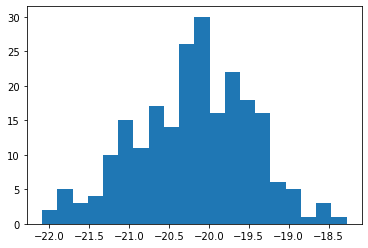

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  3%|▎         | 86/3000 [00:08<05:11,  9.36it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 147/3000 [00:15<05:55,  8.03it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▌         | 155/3000 [00:16<05:51,  8.10it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dE

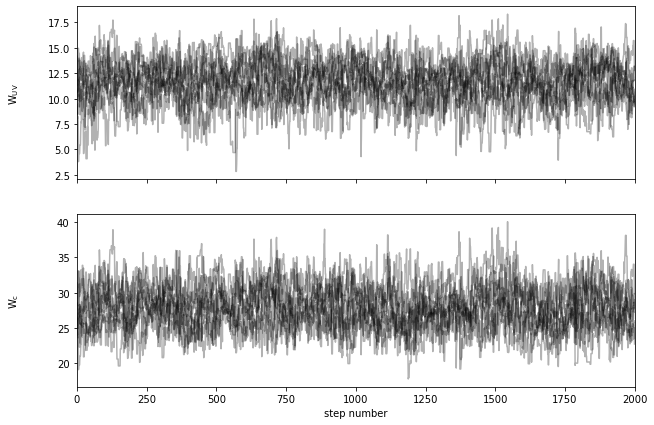

(20000, 2)


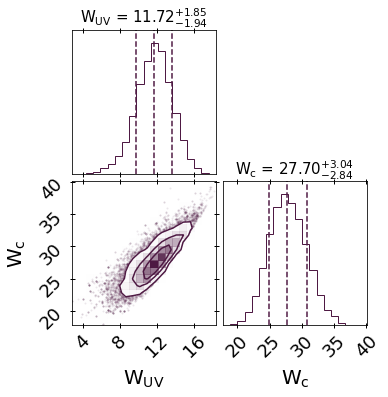

<IPython.core.display.Math object>

<IPython.core.display.Math object>

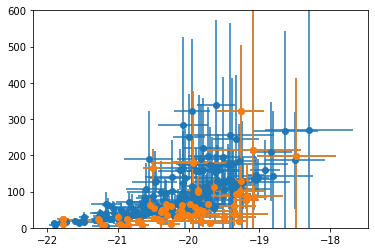

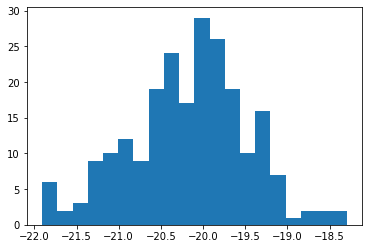

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|          | 27/3000 [00:02<05:51,  8.46it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 322/3000 [00:46<06:51,  6.51it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

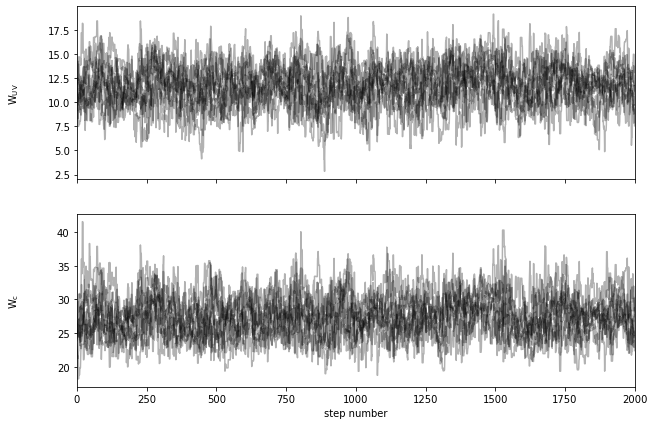

(20000, 2)


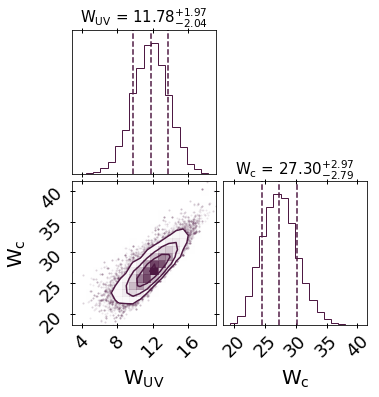

<IPython.core.display.Math object>

<IPython.core.display.Math object>

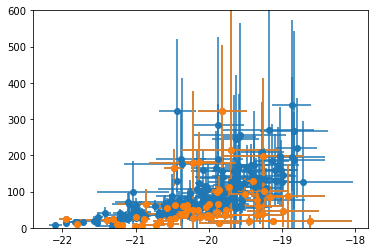

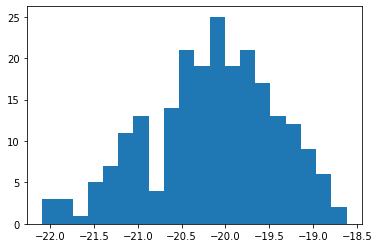

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  1%|▏         | 44/3000 [00:04<04:44, 10.40it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  2%|▏         | 46/3000 [00:04<04:45, 10.34it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 140/3000 [00:16<06:54,  6.89it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW

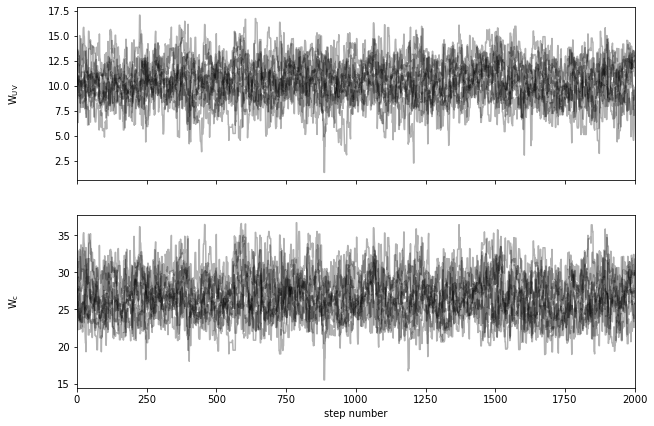

(20000, 2)


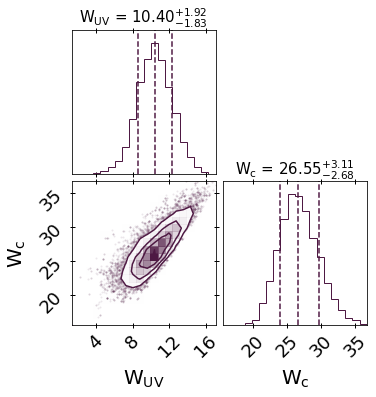

<IPython.core.display.Math object>

<IPython.core.display.Math object>

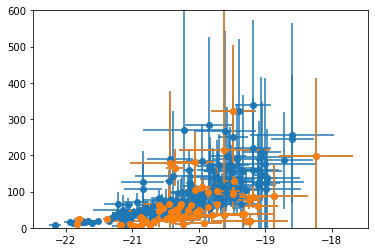

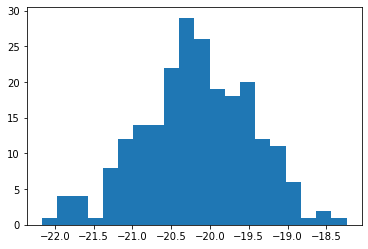

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 3/3000 [00:00<01:49, 27.41it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 14/3000 [00:01<03:37, 13.76it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 334/3000 [00:30<05:51,  7.58it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_

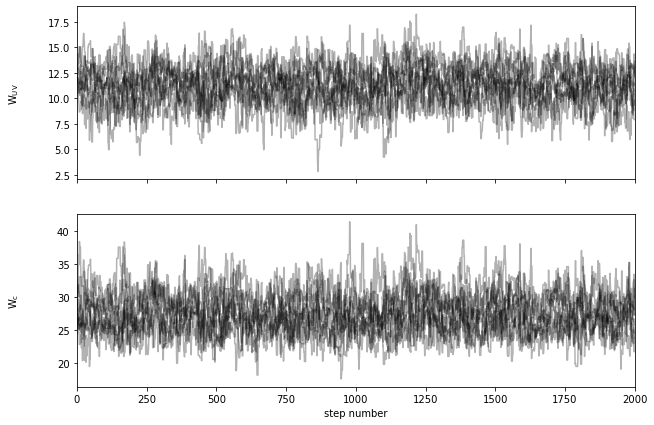

(20000, 2)


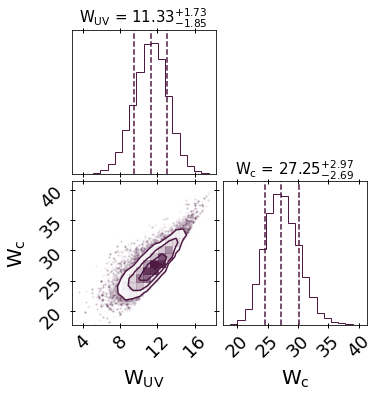

<IPython.core.display.Math object>

<IPython.core.display.Math object>

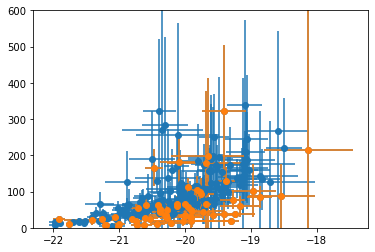

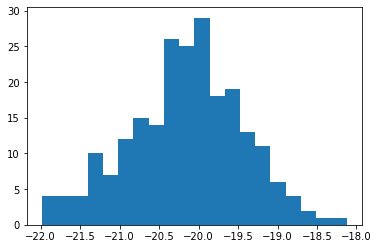

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 1/3000 [00:00<07:36,  6.56it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  7%|▋         | 220/3000 [00:32<06:55,  6.69it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|█

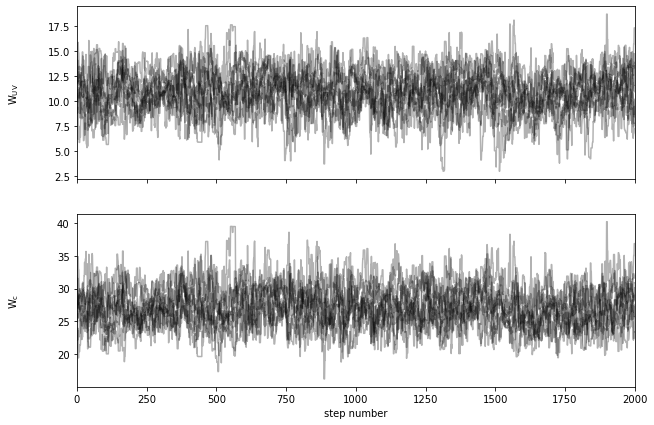

(20000, 2)


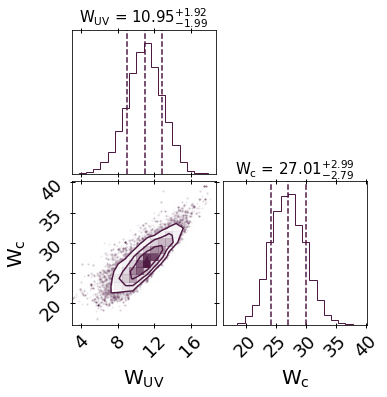

<IPython.core.display.Math object>

<IPython.core.display.Math object>

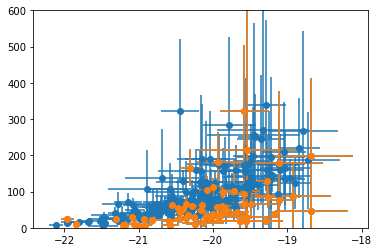

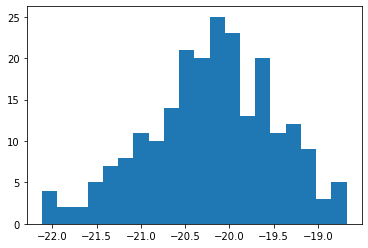

<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 10/3000 [00:00<03:41, 13.51it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 11%|█         | 334/3000 [00:44<06:24,  6.93it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|

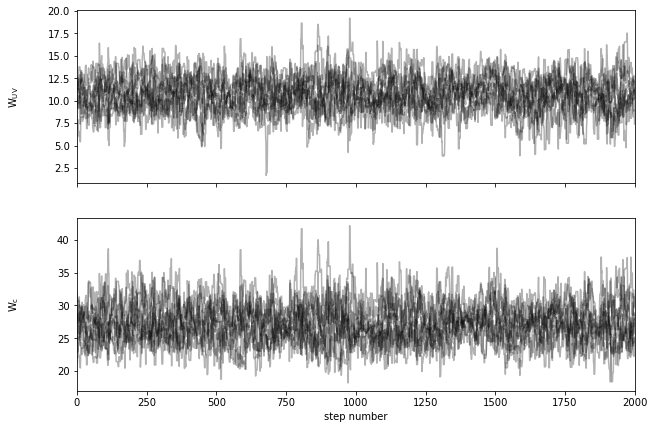

(20000, 2)


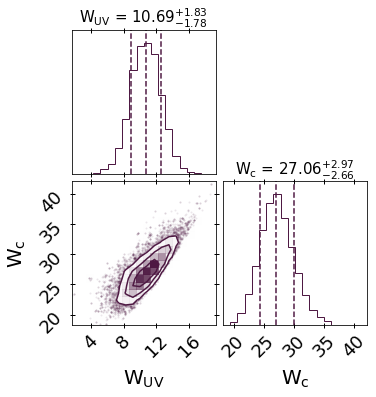

<IPython.core.display.Math object>

<IPython.core.display.Math object>

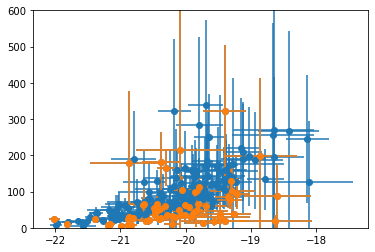

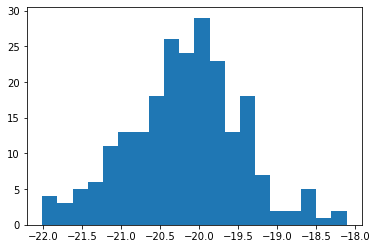

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  5%|▍         | 143/3000 [00:16<06:14,  7.62it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  9%|▉         | 275/3000 [00:34<05:58,  7.59it/s]<ipython-input-5-ccb42e6453df>:74: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(model))
 10%|▉         | 299/3000 [00:37<05:55,  7.60it/s]<ip

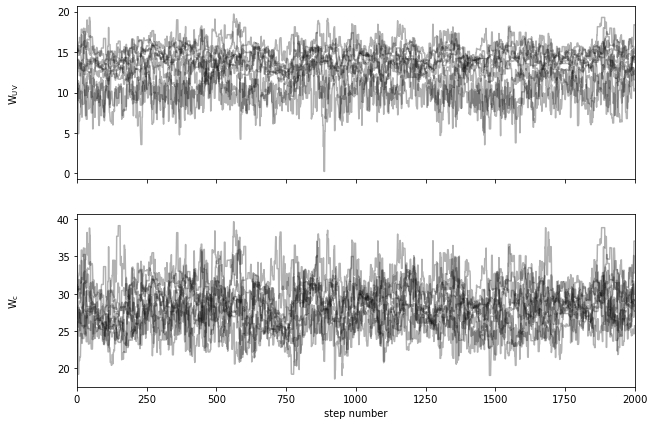

(20000, 2)


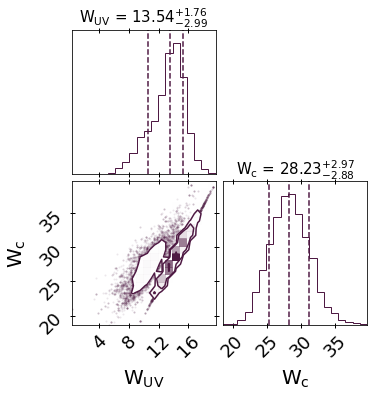

<IPython.core.display.Math object>

<IPython.core.display.Math object>

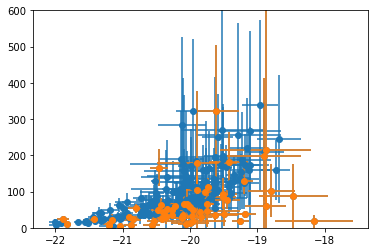

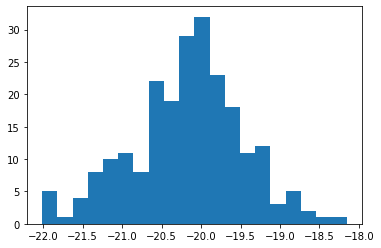

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
  0%|          | 4/3000 [00:00<06:05,  8.20it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 8/3000 [00:00<04:22, 11.42it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 12%|█▏        | 347/3000 [00:49<07:01,  6.29it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2

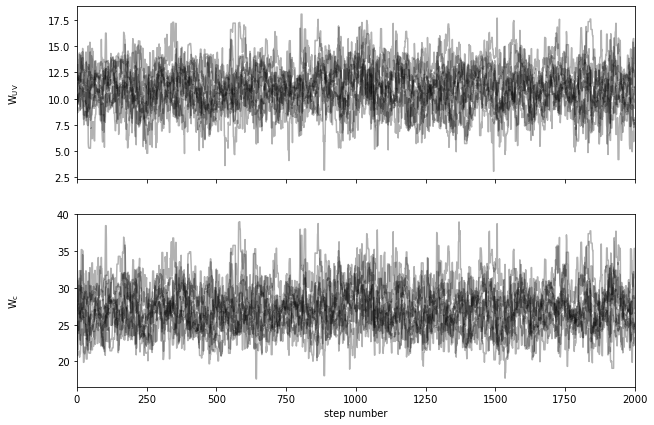

(20000, 2)


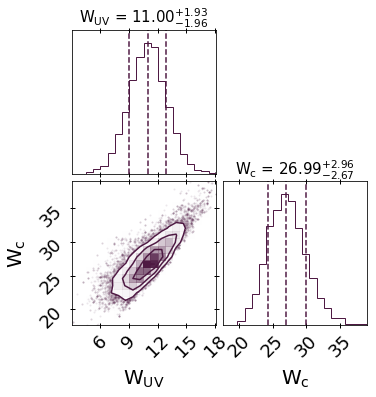

<IPython.core.display.Math object>

<IPython.core.display.Math object>

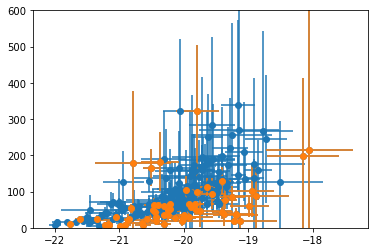

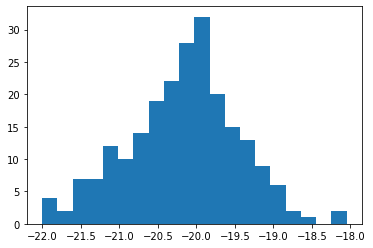

  0%|          | 0/3000 [00:00<?, ?it/s]/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in exp
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
  0%|          | 9/3000 [00:01<04:56, 10.07it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: overflow encountered in multiply
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
 27%|██▋       | 821/3000 [01:48<04:56,  7.35it/s]<ipython-input-5-ccb42e6453df>:14: RuntimeWarning: invalid value encountered in double_scalars
  p2 = 0.5 * A / Wo * np.exp(0.5*(dEW_2 - 2*ew*Wo)/Wo**2.)*scipy.special.erfc(X)
100%|█

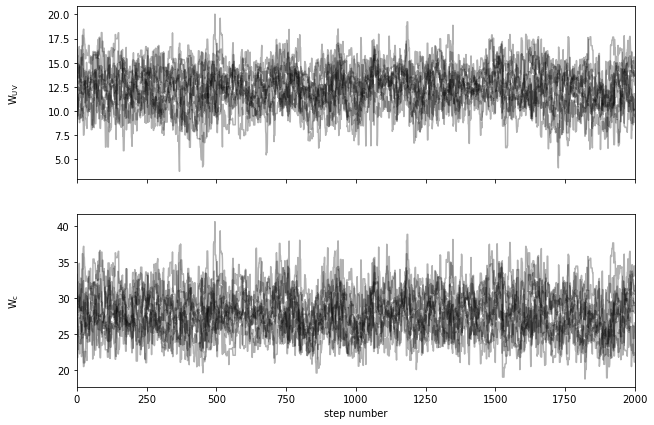

(20000, 2)


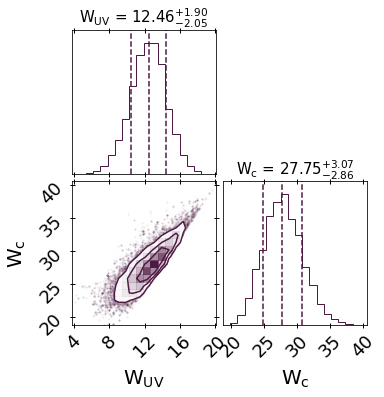

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [6]:

Muv=np.array(Muv)

dMuv=np.array(dMuv)
EW_obs=np.array(EW_obs)
dEW=np.array(dEW)
steps=3000
nwalkers=10
inValuesW=[10,20]
dis=1000
inValues=inValuesW


pos = inValues+ [2,5] * np.random.randn(nwalkers,len(inValues) )
nwalkers, ndim = np.shape(pos)

runs=1
Muv_draws = []
Beta_draws = []

for iter in range(0,100):
    tempM=[]
    tempB=[]
    for m,dm in zip(Muv,dMuv):
        new_m= np.random.normal(m,dm)
        while new_m < -23.5 or new_m > -18:
            new_m= np.random.normal(m,dm)
        tempM.append(new_m)
    Muv_draws.append(tempM)
    print("Muv_ready")




for iter in range(0,100):

    Muv_i=np.array(Muv_draws[iter])

    plt.errorbar(Muv_i,EW_obs,xerr=dMuv,yerr=dEW,fmt='o')
    plt.errorbar(Muv_i[Detection_type=="LAE"],EW_obs[Detection_type=="LAE"],xerr=dMuv[Detection_type=="LAE"],yerr=dEW[Detection_type=="LAE"],fmt='o')
    plt.ylim(0,600)
    plt.show()
    plt.hist(Muv_i,bins=20)
    plt.show()

    
    sampler = emcee.EnsembleSampler(
        nwalkers, ndim, log_probability, args=(EW_obs,dEW,Muv_i)
    )
    sampler.run_mcmc(pos, steps, progress=True)



    labels = [r"W$_{\mathrm{UV}}$",r"W$_{\mathrm{c}}$"]
    fig, axes = plt.subplots(len(labels), figsize=(10, 7), sharex=True)
    samples = sampler.get_chain(discard=dis)
    logProb=sampler.get_log_prob(discard=dis)
    maskWalkers=[False if np.isinf(logProb[steps-dis-10,i]) else True for i in range(0,nwalkers)]
    samples=np.array([s[maskWalkers] for s in samples])
    for i in range(len(labels)):
        ax = axes[i]
        ax.plot(samples[:, :, i], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[i])
        ax.yaxis.set_label_coords(-0.1, 0.5)
    axes[-1].set_xlabel("step number")
    plt.show()



    ndim=len(labels)
    samples = sampler.get_chain(discard=dis)
    samples=np.array([s[maskWalkers] for s in samples])
    samples=samples.reshape(np.shape(samples)[0]*np.shape(samples)[1],np.shape(samples)[2])
    print(np.shape(samples))

    cmap=cmocean.sequential.Matter_3_r.mpl_colormap

    labels = [r"W$_{\mathrm{UV}}$",r"W$_{\mathrm{c}}$"]

    fig = corner.corner(
        samples, labels=labels,quantiles=[.16,.50,.84],label_kwargs={"fontsize": 20},color=cmap(0.1), show_titles=True, title_kwargs={"fontsize": 15}
    )
    axes = np.array(fig.axes).reshape((ndim, ndim))
    for i in range(ndim):
        for j in range(ndim):
            ax = axes[i, j]
            ax.tick_params(axis='both', direction='inout', length=5, width=1., which='both', top=True, right=True, labelsize=18)


    #plt.savefig("/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/A-Project/E-Plots/MakeFigures/Figures/CornerPlot.png",dpi=300,bbox_inches='tight')
    plt.show()
    labels = ["W_{UV}","W_c"]

    results=[]
    r16,r84=[],[]
    for i in range(ndim):
        mcmc = np.percentile(samples[:, i], [16, 50, 84])
        results.append(mcmc[1])
        r16.append(mcmc[0])
        r84.append(mcmc[2])
        q = np.diff(mcmc)
        txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
        txt = txt.format(mcmc[1], q[0], q[1], labels[i])
        display(Math(txt))
        
    np.save("samples_noBeta/samples"+str(iter)+".npy",samples)
